select subject session FOV

30.0119

In [32]:
import BCI_analysis, os
local_temp_dir = '/home/jupyter/temp/' 
metadata_dir = '/home/jupyter/bucket/Metadata/' 
raw_scanimage_dir_base ='/home/jupyter/bucket/Data/Calcium_imaging/raw/' 
suite2p_dir_base = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/'
bpod_path = '/home/jupyter/bucket/Data/Behavior/BCI_exported/'
setup = 'Bergamo-2P-Photostim'#'DOM3-MMIMS'
save_path = "/home/jupyter/bucket/Data/Calcium_imaging/sessionwise_tba"
fov = 'FOV_01'
subject = 'BCI_54'
BCI_analysis.io_suite2p.suite2p_to_npy(os.path.join(suite2p_dir_base,setup), 
                                       os.path.join(raw_scanimage_dir_base,setup), 
                                       os.path.join(bpod_path,setup),
                                       save_path, 
                                       overwrite=True, 
                                       mice_name = subject,
                                       fov_list = [fov],
                                       max_frames = 500)

FOV: FOV_01, Session Date: 062323


100it [00:02, 37.88it/s]


Saved to /home/jupyter/bucket/Data/Calcium_imaging/sessionwise_tba/BCI_54/BCI_54-062323-FOV_01.npy
FOV: FOV_01, Session Date: 062623


178it [00:08, 22.21it/s]


Saved to /home/jupyter/bucket/Data/Calcium_imaging/sessionwise_tba/BCI_54/BCI_54-062623-FOV_01.npy


In [4]:
# #register Z-stack
# import os
# from pathlib import Path
# subject = 'PKJ_04'
# session = '042123'
# z_stack = 'stack_00001.tif'
# os.chdir('/home/jupyter/Scripts/Suite2p_pipeline/utils/')
# import utils_imaging as utils_imaging
# local_temp_dir = '/home/jupyter/temp'
# temp_dir = os.path.join(local_temp_dir,'{}_{}_{}'.format(subject,session,z_stack[:-4]))
# Path(temp_dir).mkdir(exist_ok = True, parents = True)
# utils_imaging.register_zstack('/home/jupyter/bucket/Data/Calcium_imaging/raw/Bergamo-2P-Photostim/{}/{}/{}'.format(subject,session,z_stack) ,temp_dir)

planes: 51
(51, 100, 2, 800, 800)
(5100, 2, 800, 800)
pixel size changed from [5.4, 5.4] to 0.45442069540907865 
regstering /home/jupyter/temp/PKJ_04_042123_stack_00001/stack_00001.tif
{}
tif
** Found 1 tifs - converting to binary **
408 frames of binary, time 2.05 sec.
816 frames of binary, time 3.94 sec.
1224 frames of binary, time 5.14 sec.
1632 frames of binary, time 6.43 sec.
2040 frames of binary, time 8.59 sec.
2448 frames of binary, time 11.18 sec.
2856 frames of binary, time 13.77 sec.
3264 frames of binary, time 16.45 sec.
3672 frames of binary, time 20.01 sec.
4080 frames of binary, time 24.26 sec.
4488 frames of binary, time 28.65 sec.
4896 frames of binary, time 47.67 sec.
5304 frames of binary, time 75.08 sec.
5712 frames of binary, time 95.12 sec.
6120 frames of binary, time 117.35 sec.
6528 frames of binary, time 139.37 sec.
6936 frames of binary, time 161.87 sec.
7344 frames of binary, time 181.85 sec.
7752 frames of binary, time 203.13 sec.
8160 frames of binary, time

In [33]:
#%% suggest neurons for next session based on previous sessions
import os
import BCI_analysis
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
from scipy.io import savemat
from scipy.stats import zscore
import shutil
import matplotlib.pyplot as plt

use_scalar_f0 = False

sessionwise_base_dir = '/home/jupyter/bucket/Data/Calcium_imaging/sessionwise_tba'
s2p_base_dir = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim'
raw_scanimage_dir = '/home/jupyter/bucket/Data/Calcium_imaging/raw/Bergamo-2P-Photostim'
bpod_path = '/home/jupyter/bucket/Data/Behavior/BCI_exported/Bergamo-2P-Photostim/'

#next_session_dir = '/home/jupyter/bucket/Data/Calcium_imaging/next_session'

maximum_decrease_in_f0 = .25 # if decreases above this amount will be thrown out


# 2 neuron stuff
# subject = 'BCI_41'
# fov = 'FOV_02'
# subject = 'BCI_42'
# fov = 'FOV_04'
# subject = 'BCI_43'
# fov = 'FOV_02'
# 2 neuron stuff

subject = 'BCI_53'
fov = 'FOV_01'
use_red_channel = False

next_session_dir = '/home/jupyter/bucket/Data/Calcium_imaging/next_session/{}-{}/'.format(subject, fov)
files = os.listdir(os.path.join(sessionwise_base_dir,subject))
data_dict = {}
sessions = []
stat = np.load(os.path.join(s2p_base_dir,subject,fov,'stat.npy'),allow_pickle=True).tolist()
stat_rest = np.load(os.path.join(s2p_base_dir,subject,fov,'stat_rest.npy'),allow_pickle=True).tolist()
for file in files: ### NOT ALL FILES?? - 
    
    if fov in file:
        session = file[len(subject)+1:-1*(len(fov)+5)]
        sessions.append(session)
        data_dict[session] = BCI_analysis.io_python.read_sessionwise_npy(os.path.join(sessionwise_base_dir,subject,file))
        F0 = np.load(os.path.join(s2p_base_dir,subject,fov,session,'F0.npy'))
        if use_red_channel:
            F = np.load(os.path.join(s2p_base_dir,subject,fov,session,'F_chan2.npy'))
            data_dict[session]['F_sessionwise'] =  F
            dff = (F-F0)/F0
            data_dict[session]['dff_sessionwise'] = dff
        if any(np.nanmean(F0/np.nanmedian(F0[:,:10000],1)[:,np.newaxis],0)<1-maximum_decrease_in_f0):
            throw_out_idx = np.where(np.nanmean(F0/np.nanmedian(F0[:,:10000],1)[:,np.newaxis],0)<1-maximum_decrease_in_f0)[0][0]
        else:
            throw_out_idx = data_dict[session]['dff_sessionwise'].shape[1]
        print('{}% discarded due to f0 rundown'.format(round(100*(1-(throw_out_idx/data_dict[session]['dff_sessionwise'].shape[1])))))
        data_dict[session]['F_sessionwise'] = data_dict[session]['F_sessionwise'][:,:throw_out_idx]
        data_dict[session]['dff_sessionwise'] = data_dict[session]['dff_sessionwise'][:,:throw_out_idx]
        if use_scalar_f0:
            data_dict[session]['dff_sessionwise'] = (data_dict[session]['F_sessionwise']-data_dict[session]['f0_scalar'][:,np.newaxis])/data_dict[session]['f0_scalar'][:,np.newaxis]
        #data_dict[session]['photon_counts']=np.load(os.path.join(s2p_base_dir,subject,fov,session,'photon_counts.npy'),allow_pickle=True).tolist()
        data_dict[session]['signal_to_noise_trace'] = data_dict[session]['dff_sessionwise']*data_dict[session]['photon_counts']['dprime_1dFF'][:,np.newaxis]
        print(file)
        # behavior_fname = os.path.join(bpod_path,subject, f"{session}-bpod_zaber.npy")
        # behavior_dict= np.load(behavior_fname,allow_pickle = True).tolist()
        # asdsad
        # data_dict['outputChannelsFunctions'] = behavior_dict['scanimage_roi_outputChannelsFunctions'][int(len(behavior_dict['go_cue_times'])/2)][0]
        # if 'anticorrelate' in data_dict['outputChannelsFunctions']:
        #     data_dict['training_type'] = 'anticorrelate'
        # else:
        #     data_dict['training_type'] = 'correlate'
        # del behavior_dict
        
        
        
        # if len(data_dict.keys())>3:
        #     break
        

        #%
        #%
sessions = np.sort(list(data_dict.keys()))
cn_list = []
for session in sessions:
    try:
        toadd = None
        i_ = 0
        while toadd is None:
            try:
                toadd = np.asarray(data_dict[session]['cn'])[i_]
            except:
                pass
            i_+=1
        #cn_list.append(np.unique(np.asarray(data_dict[session]['cn'])[np.asarray(data_dict[session]['cn'])!=None])) # assuming that the CN is not changing
        cn_list.append(toadd)
        print(toadd)
    except: 
        pass
    #%
#cn_list = np.unique(cn_list)
#%


0% discarded due to f0 rundown
BCI_53-062323-FOV_01.npy
0% discarded due to f0 rundown
BCI_53-062623-FOV_01.npy
194
194


In [34]:
#%% calculate event rate and stuff like that

# TODO amplitude should be calculated for each transient separately, then averaged over transients
# this way the long tails of long trials won't interfere
from pathlib import Path



#% calculate event rate
min_event_step = 5 # @20Hz - length of event # 10 for 6s, 5 for 8s
minimum_d_prime = 10# 5 for 6s
time_to_average_after_trial_start = 8 #seconds
baseline_end_t = -.5 # seconds before GO cue

file_list_to_copy_over = ['Z-positions.pdf',
                          'session_meanimages.tiff',
                          'ROI_sizes.pdf',
                          'ROIs.pdf',
                          'stat.mat',
                          'XYZ_motion.pdf',
                          'session_refImages.tiff',
                          'ops.mat']
#%

pixel_num_list = []
for s in stat:
    pixel_num_list.append(np.sum(s['soma_crop']))# &(s['overlap']==False)))
    #break
pixel_num_list=np.asarray(pixel_num_list)
    #%
for last_session in sessions: 
    trialwise_matrix_name = 'dff_trialwise_closed_loop'#'dff_trialwise_all'
    trialwise_dff_until_reward = data_dict[last_session][trialwise_matrix_name].copy()
    if trialwise_dff_until_reward.shape[2]==0:
        trialwise_matrix_name = 'dff_trialwise_all'
        trialwise_dff_until_reward = data_dict[last_session][trialwise_matrix_name].copy()
    trialwise_reward_matrix = np.nan*trialwise_dff_until_reward
    step_back =np.argmax(data_dict[last_session]['time_since_trial_start']>0) -1
    trial_len = len(data_dict[last_session]['time_since_trial_start'])
    for trial_i, reward_time in enumerate(data_dict[last_session]['reward_times']):
        if len(reward_time)>0:
            
            reward_idx = np.argmax(data_dict[last_session]['time_since_trial_start']>reward_time[0])
            if reward_idx == 0:
                reward_idx = len(data_dict[last_session]['time_since_trial_start'])
            #print(['rewarded',reward_idx])
            trialwise_dff_until_reward[reward_idx:,:,trial_i] = np.nan
            trialwise_reward_matrix[:step_back+trial_len-reward_idx,:,trial_i] = data_dict[last_session][trialwise_matrix_name][reward_idx-step_back:,:,trial_i]
    mean_reward_matrix = np.nanmean(trialwise_reward_matrix,2).T
    std_reward_matrix = np.nanstd(trialwise_reward_matrix,2).T
    mean_activity_matrix = np.nanmean(trialwise_dff_until_reward,2).T
    baseline_length = np.argmax(data_dict[last_session]['time_since_trial_start']>data_dict[last_session]['go_cue_times'][0][0])#
    baseline_end = np.argmax(data_dict[last_session]['time_since_trial_start']>data_dict[last_session]['go_cue_times'][0][0]+baseline_end_t)#
    amplitude_length = np.argmax(data_dict[last_session]['time_since_trial_start']>time_to_average_after_trial_start)
    mean_activity_matrix_normalized = mean_activity_matrix-np.nanmean(mean_activity_matrix[:,:baseline_end],1)[:,np.newaxis]#/np.nanmean(mean_activity_matrix[:,:baseline_length],1)[:,np.newaxis] # TODO division is not needed here once real df/f is exported..
    mean_activity_matrix_normalized[np.isnan(mean_activity_matrix_normalized)] = 0
    mean_activity_matrix_normalized[np.isinf(mean_activity_matrix_normalized)] = 0
    data_dict[last_session]['mean_activity_matrix'] = mean_activity_matrix
    data_dict[last_session]['mean_reward_matrix'] = mean_reward_matrix
    

    amplitude = np.nanmean(mean_activity_matrix_normalized[:,baseline_length:amplitude_length],1)
    amplitude[amplitude>1] = 1
    amplitude[amplitude<-1] = -1
    stdev = np.nanstd(mean_activity_matrix_normalized[:,baseline_length:amplitude_length],1)
    #%
    events = data_dict[last_session]['signal_to_noise_trace']>minimum_d_prime
    event_edges = np.diff(np.concatenate([np.zeros([events.shape[0],1]),events,np.zeros([events.shape[0],1])],1))
    events_clean = np.zeros(events.shape)
    event_num = []
    event_amplitude = []
    for i,line in enumerate(event_edges):
        starts = np.where(line==1)[0]
        ends = np.where(line==-1)[0]
        lengths = ends-starts
        amplitudes = []
        for idx in np.where(lengths>=min_event_step)[0]:
            events_clean[i,starts[idx]:ends[idx]]=np.ones(lengths[idx])*np.nanmean(data_dict[last_session]['dff_sessionwise'][i,starts[idx]:ends[idx]])#*data_dict[last_session]['photon_counts']['dprime_1dFF'][i]
            #events_clean[i,starts[idx]:ends[idx]]=data_dict[last_session]['dff_sessionwise'][i,starts[idx]:ends[idx]]
            amplitudes.append(np.max(data_dict[last_session]['dff_sessionwise'][i,starts[idx]:ends[idx]]))
        event_amplitude.append(np.mean(amplitudes))
        event_num.append(len(np.where(lengths>=min_event_step)[0]))
    events_clean[np.isnan(events_clean)] = 0
    events_clean[np.isinf(events_clean)] = 0
    event_rate = np.asarray(event_num)/(events.shape[1]/20/60)
    amplitude_rate = np.sum(events_clean,1)/(events.shape[1]/20)
    amplitude_rate[amplitude_rate<.001] = .001 #avoid zeros
    event_rate[event_rate<.001] = .001 #avoid zeros
    data_dict[last_session]['event_rate'] = event_rate
    data_dict[last_session]['amplitude_rate'] = amplitude_rate
    data_dict[last_session]['events_clean'] = events_clean
    data_dict[last_session]['trial_averaged_amplitude'] = amplitude
    
    go_cue_times = data_dict[last_session]['go_cue_times']
    reward_times = data_dict[last_session]['reward_times']
    threshold_crossing_times = data_dict[last_session]['threshold_crossing_times']
    reward_list = []
    threshold_crossing_list = []
    for g,r,t in zip(go_cue_times,reward_times,threshold_crossing_times):
        if len(r)>0:
            reward_list.append(True)
            threshold_crossing_list.append(t[0])
        else:
            reward_list.append(False)
            threshold_crossing_list.append(np.nan)
    data_dict[last_session]['rewarded_trials'] = np.asarray(reward_list)
    data_dict[last_session]['time_to_reward'] = np.asarray(threshold_crossing_list)
    

/tmp/ipykernel_11266/3073732804.py:49: RuntimeWarning: Mean of empty slice
  mean_reward_matrix = np.nanmean(trialwise_reward_matrix,2).T
/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_11266/3073732804.py:51: RuntimeWarning: Mean of empty slice
  mean_activity_matrix = np.nanmean(trialwise_dff_until_reward,2).T


In [3]:
#Add to master dict 
#data_dict_big = {}
data_dict_big[subject] = data_dict.copy()
data_dict_big[subject].keys()

dict_keys(['032023', '032123', '032223', '032423', '032723', '032823', '032923', '033123', '040323', '040423'])

In [4]:
# add session comment

metadata_dir = '/home/jupyter/bucket/Metadata'
import datetime
import pandas as pd
for subject in data_dict_big.keys():
    try:
        subject_metadata = pd.read_csv(os.path.join(metadata_dir,subject.replace('_','')+'.csv'))
    except:
        try:
            subject_metadata = pd.read_csv(os.path.join(metadata_dir,subject+'.csv'))
        except:
            print('no metadata found')
            continue
    print(subject)


    sessions = list(data_dict_big[subject].keys())
    session_date_dict = {}
    for session in sessions:
        try:
            session_date = datetime.datetime.strptime(session,'%m%d%y')
        except:
            try:
                session_date = datetime.datetime.strptime(session,'%Y-%m-%d')
            except:
                try:
                    session_date = datetime.datetime.strptime(session[:6],'%m%d%y')
                except:
                    print('cannot understand date for session dir: {}'.format(session))
                    continue
        if session_date.date() in session_date_dict.keys():
            print('there were multiple sessions on {}'.format(session_date.date()))
            session_date_dict[session_date.date()] = [session_date_dict[session_date.date()],session]
        else:
            session_date_dict[session_date.date()] = session
        data_dict_big[subject][session]['session_comment'] = subject_metadata.loc[subject_metadata['Date']==str(session_date.date()).replace('-','/')]['Comment'].values[0]

BCI_41


In [5]:
#### calculate behavioral stuff.


def movingaverage(DFF,win,function = 'mean'):
    taper = np.ones(win)*np.nan
    DFF = np.concatenate([DFF,taper])
    dff_list = []
    for i in range(win):
        dff_list.append(np.roll(DFF,i*-1,axis = 0))
    if function == 'mean':
        DFF_averaged = np.nanmean(np.asarray(dff_list),0).squeeze()
    elif function == 'median':
        DFF_averaged = np.nanmedian(np.asarray(dff_list),0).squeeze()
    DFF_averaged = DFF_averaged[:-win]
    return DFF_averaged


needed_comments = ['anti','pair']#['pair']
excluded_comments = []#['anti']

trials_needed = 70
averaging_window = 10
rewarded_trials_list = []
time_to_reward_list = []
for subject in data_dict_big.keys():
    print(subject)
    sessions = data_dict_big[subject].keys()
    for session in sessions:
        #print(data_dict_big[subject][session]['session_comment'])
        session_is_needed =True
        for c in needed_comments:
            session_is_needed = session_is_needed and c in data_dict_big[subject][session]['session_comment']
        for c in excluded_comments:
            session_is_needed = session_is_needed and c not in data_dict_big[subject][session]['session_comment']
        #print([data_dict_big[subject][session]['session_comment'],session_is_needed])
        if not session_is_needed:
            continue
        print(session)
        rewarded_trials_now = data_dict_big[subject][session]['rewarded_trials']
        if averaging_window>1:
            rewarded_trials_now = movingaverage(rewarded_trials_now,averaging_window)
        rewarded_trials_now_ = np.ones(trials_needed)*np.nan
        rewarded_trials_now_[:min([len(rewarded_trials_now),len(rewarded_trials_now_)])] = rewarded_trials_now[:min([len(rewarded_trials_now),len(rewarded_trials_now_)])]
        rewarded_trials_list.append(rewarded_trials_now_)
        
        time_to_reward_now = data_dict_big[subject][session]['time_to_reward']
        if averaging_window>1:
            time_to_reward_now = movingaverage(time_to_reward_now,averaging_window,function = 'mean')
        time_to_reward_now_ = np.ones(trials_needed)*np.nan
        time_to_reward_now_[:min([len(time_to_reward_now),len(time_to_reward_now_)])] = time_to_reward_now[:min([len(time_to_reward_now),len(time_to_reward_now_)])]
        time_to_reward_list.append(time_to_reward_now_)
        
        #asda
        
        
rewarded_trials_list = np.asarray(rewarded_trials_list)
time_to_reward_list = np.asarray(time_to_reward_list)

order = np.argsort(np.nanmean(rewarded_trials_list[:,:5],1)) #np.nanmean(rewarded_trials_list[:,30:60],1)-
rewarded_trials_list = rewarded_trials_list[order,:]
time_to_reward_list = time_to_reward_list[order,:]

    
    #plt.plot(movingaverage(data_dict[session]['rewarded_trials'],5))
    

BCI_41
033123
040323
040423


/tmp/ipykernel_13709/3399159728.py:11: RuntimeWarning: Mean of empty slice
  DFF_averaged = np.nanmean(np.asarray(dff_list),0).squeeze()


In [22]:
subjects

NameError: name 'subjects' is not defined

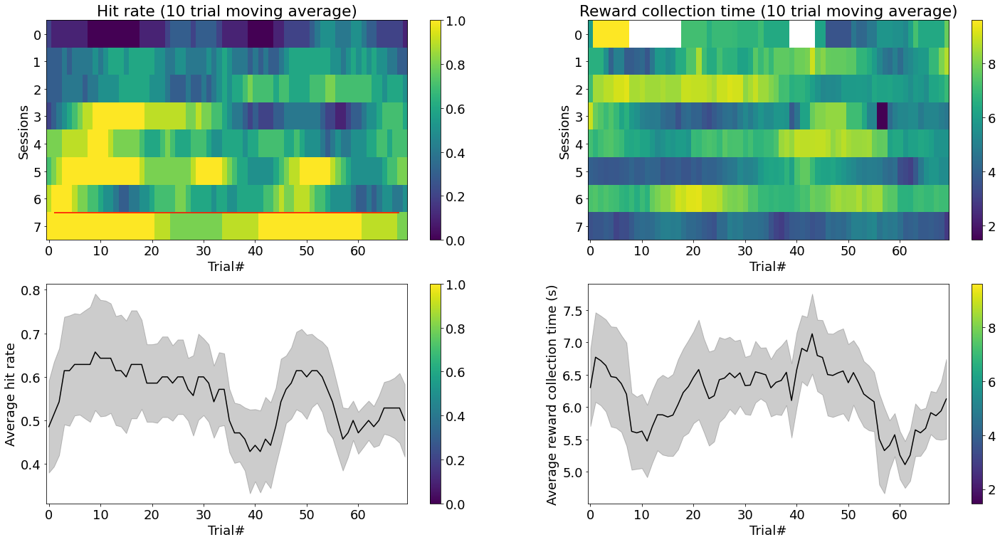

In [42]:
# behavior plot

fig  = plt.figure(figsize = [25,12.5])
baseline_trial_num = 0 # subtract the average of this many trial
max_reward_rate_start  = .99#.8 # if reward rate is higher than this, skip session from plot


ax_im_rewrate  = fig.add_subplot(2,2,1)
needed = np.nanmean(rewarded_trials_list[:,:5],1)<=max_reward_rate_start
if baseline_trial_num==0:
    im = ax_im_rewrate.imshow(rewarded_trials_list[:,:],aspect = 'auto', interpolation = 'none') #-np.nanmean(rewarded_trials_list[:,:5],1)[:,np.newaxis]
else:
    im = ax_im_rewrate.imshow(rewarded_trials_list[:,:]-np.nanmean(rewarded_trials_list[:,:baseline_trial_num],1)[:,np.newaxis],aspect = 'auto', interpolation = 'none') #
ax_im_rewrate.hlines(np.argmin(needed)-.5,1,rewarded_trials_list.shape[1]-2,color = 'red')
ax_im_rewrate.set_ylabel('Sessions')
ax_im_rewrate.set_xlabel('Trial#')
ax_im_rewrate.set_title('Hit rate ({} trial moving average)'.format(averaging_window))
fig.colorbar(im, ax=ax_im_rewrate,location = 'right')


ax_plt_rewrate = fig.add_subplot(2,2,3,sharex = ax_im_rewrate)
x = np.arange(rewarded_trials_list.shape[1])
y = np.nanmean(rewarded_trials_list[needed,:],0)
yerr = np.nanstd(rewarded_trials_list[needed,:],0)/np.sqrt(sum(needed))
ax_plt_rewrate.plot(x,y,'k-')

ax_plt_rewrate.fill_between(x, y-yerr, y+yerr,color = 'black',alpha = .2)
fig.colorbar(im, ax=ax_plt_rewrate,location = 'right')

ax_plt_rewrate.set_ylabel('Average hit rate')
ax_plt_rewrate.set_xlabel('Trial#')


needed = rewarded_trials_list[:,0]<=max_reward_rate_start+100
ax_im_rewrtime  = fig.add_subplot(2,2,2)
if baseline_trial_num==0:
    im = ax_im_rewrtime.imshow(time_to_reward_list[needed,:],aspect = 'auto', interpolation = 'none') #-np.nanmean(time_to_reward_list[:,:20],1)[:,np.newaxis]
else:
    im = ax_im_rewrtime.imshow(time_to_reward_list[needed,:]-np.nanmean(time_to_reward_list[needed,:baseline_trial_num],1)[:,np.newaxis],aspect = 'auto', interpolation = 'none') #

ax_im_rewrtime.set_ylabel('Sessions')
ax_im_rewrtime.set_xlabel('Trial#')
ax_im_rewrtime.set_title('Reward collection time ({} trial moving average)'.format(averaging_window))
fig.colorbar(im, ax=ax_im_rewrtime,location = 'right')
    
    
ax_plt_rewtime = fig.add_subplot(2,2,4,sharex = ax_im_rewrtime)


x = np.arange(time_to_reward_list.shape[1])
y = np.nanmean(time_to_reward_list[:,:],0)
yerr = np.nanstd(time_to_reward_list[:,:],0)/np.sqrt(len(needed))
ax_plt_rewtime.plot(x,y,'k-')
ax_plt_rewtime.fill_between(x, y-yerr, y+yerr,color = 'black',alpha = .2)


ax_plt_rewtime.set_ylabel('Average reward collection time (s)')
ax_plt_rewtime.set_xlabel('Trial#')
fig.colorbar(im, ax=ax_plt_rewtime,location = 'right')

In [9]:
data_dict.keys()

dict_keys(['032023', '032123', '032223', '032423', '032723', '032823', '032923', '033123', '040323', '040423'])

In [12]:
# select session
subject = 'BCI_41'
data_dict = data_dict_big[subject].copy()
needed_sessions = ['032023','032123']
to_pop = []
for k in data_dict.keys():
    if k not in needed_sessions:
        to_pop.append(k)
for k in to_pop:
    data_dict.pop(k)
sessions = np.sort(list(data_dict.keys()))
cn_list = []
for session in sessions:
    try:
        toadd = None
        i_ = 0
        while toadd is None:
            try:
                toadd = np.asarray(data_dict[session]['cn'])[i_]
            except:
                pass
            i_+=1
        #cn_list.append(np.unique(np.asarray(data_dict[session]['cn'])[np.asarray(data_dict[session]['cn'])!=None])) # assuming that the CN is not changing
        cn_list.append(toadd)
        print(toadd)
    except: 
        pass




session_i = 1
last_session = session = sessions[session_i]
previous_session_i = 0
previous_session = sessions[previous_session_i]

[16, 57]
[20, 57]


/tmp/ipykernel_13709/1462305988.py:19: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  toadd = np.asarray(data_dict[session]['cn'])[i_]


In [513]:
# session = '032923'
# fov = 'FOV_02'
# subject = 'BCI_43'


# session_bpod_file = '/home/jupyter/bucket/Data/Behavior/BCI_exported/Bergamo-2P-Photostim/{}/{}-bpod_zaber.npy'.format(subject,session)
# session_ops_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/{}/{}/{}/ops.npy'.format(subject,fov,session)
# fov_stats_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/{}/{}/stat.npy'.format(subject,fov)

# # session_bpod_file = '/home/jupyter/bucket/Data/Behavior/BCI_exported/Bergamo-2P-Photostim/BCI_41/030823-bpod_zaber.npy'
# # session_ops_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/BCI_41/FOV_01/030823/ops.npy'
# # fov_stats_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/BCI_41/FOV_01/stat.npy'

# temp = BCI_analysis.pipeline_imaging.find_conditioned_neuron_idx(session_bpod_file,
#                                                                 session_ops_file,
#                                                                 fov_stats_file, 
#                                                                 plot = True,
#                                                                 return_distances = False,
#                                                                 calculate_cn_lickport_correlation = False)

In [33]:
import matplotlib
font = {'family' : 'normal',
        #'weight' : 'bold',
        'size'   : 14}
matplotlib.rc('font', **font)


/tmp/ipykernel_13709/2201230902.py:40: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  toadd = np.asarray(data_dict[session]['cn'])[i_]


[16, 57]
[20, 57]
[39, 37]
[11, 146]
[63 37]
[27  6]
[283, 165]
[53, 27]
[426  37]
[94, 770]


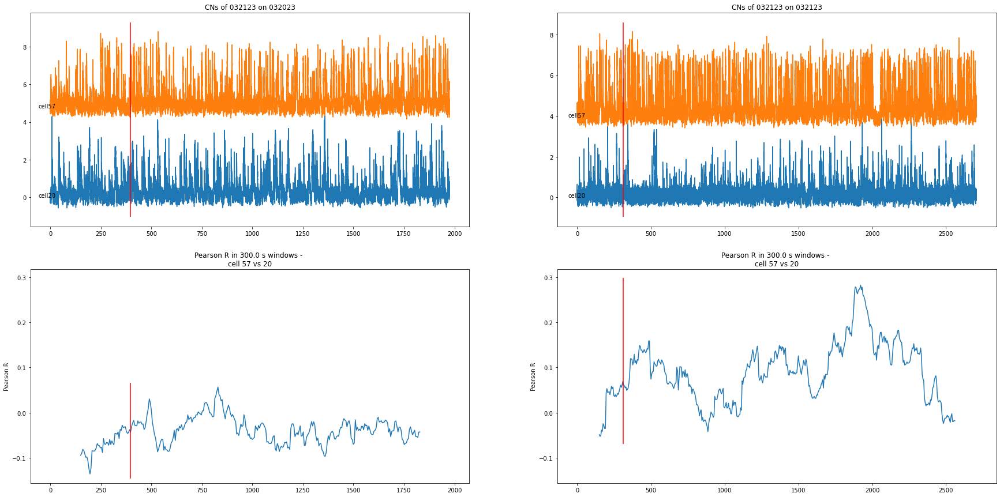

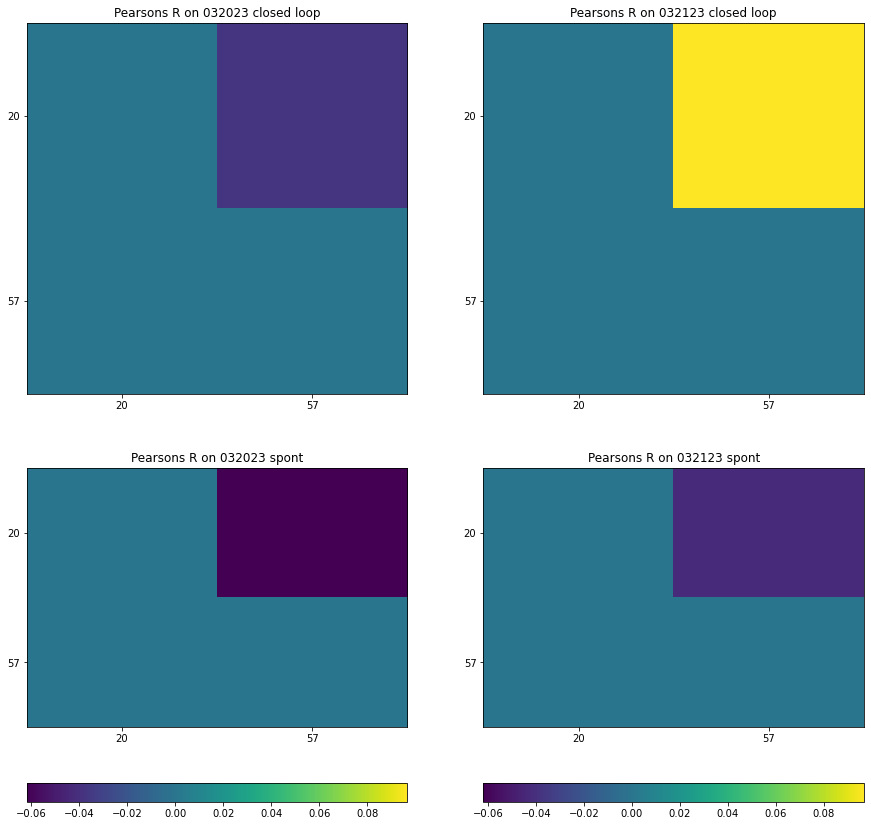

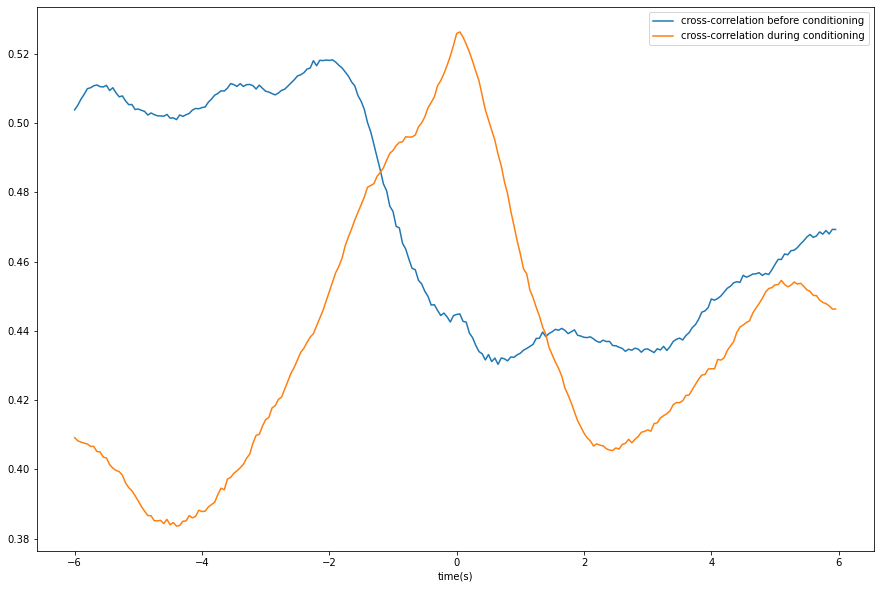

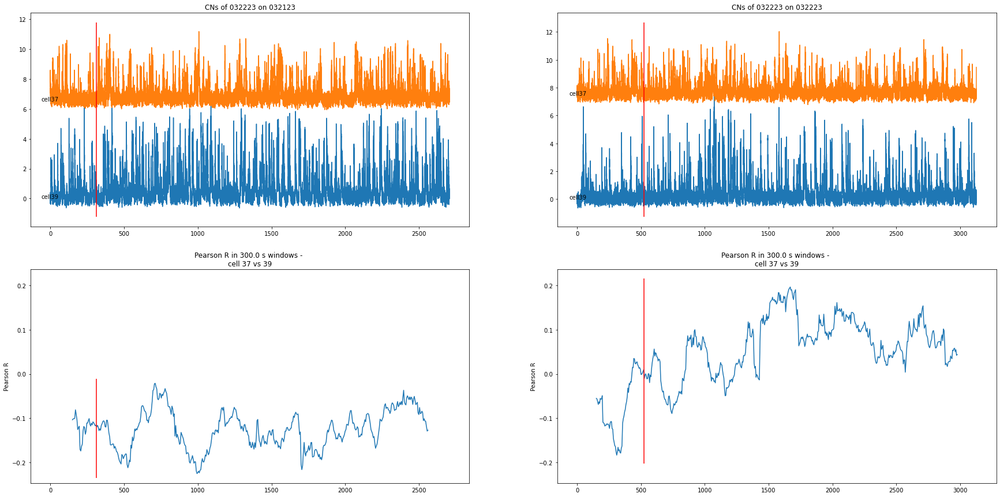

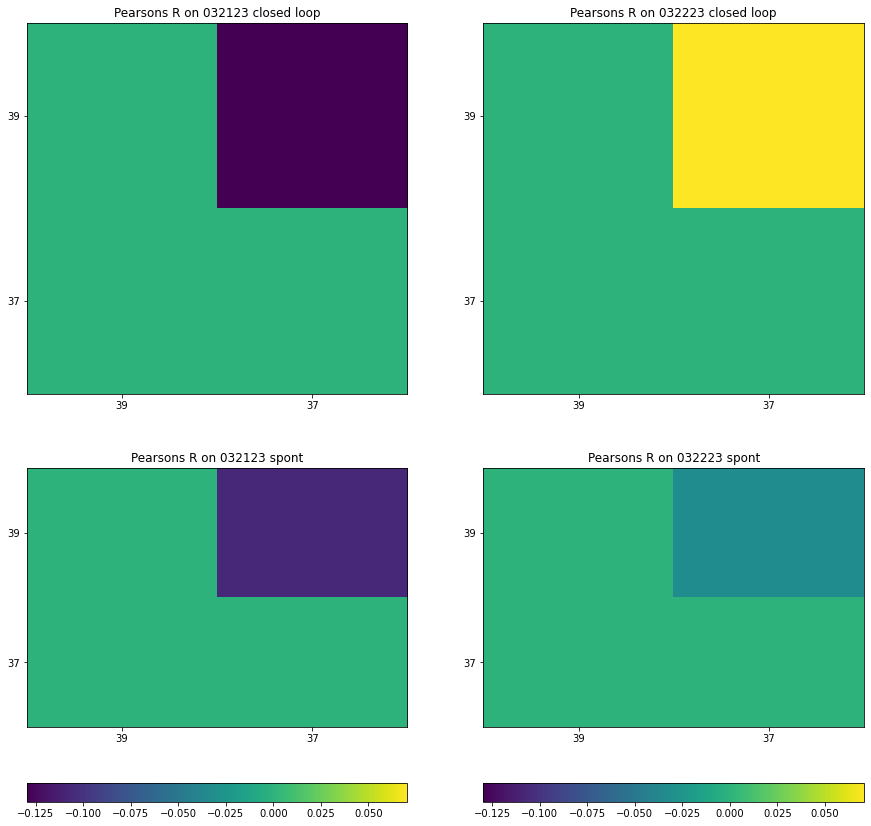

...

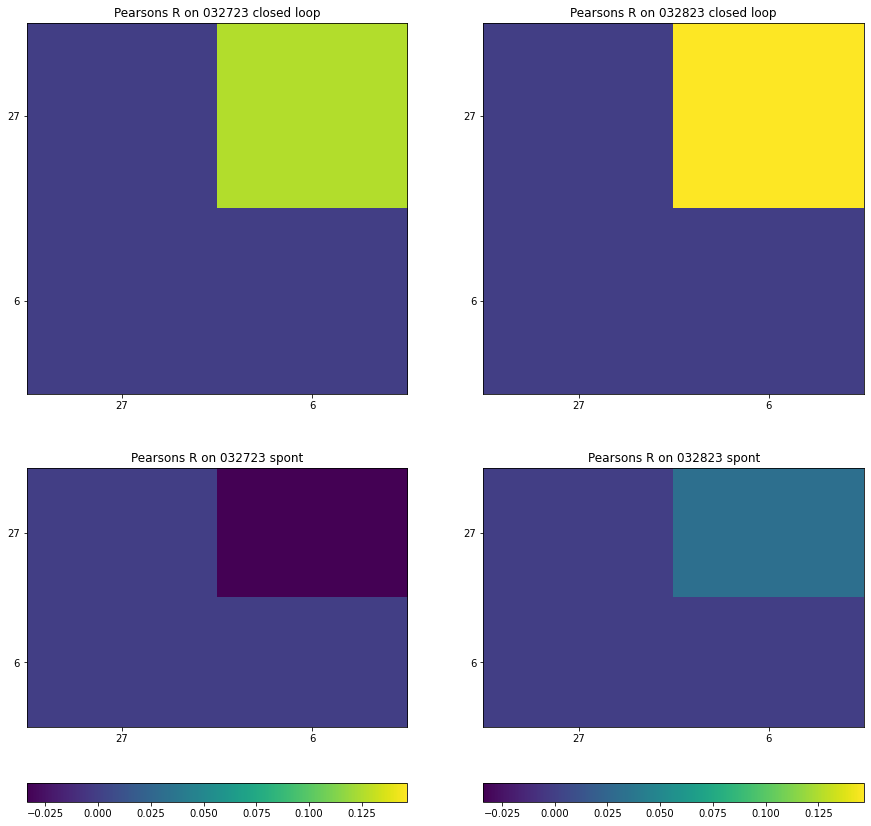

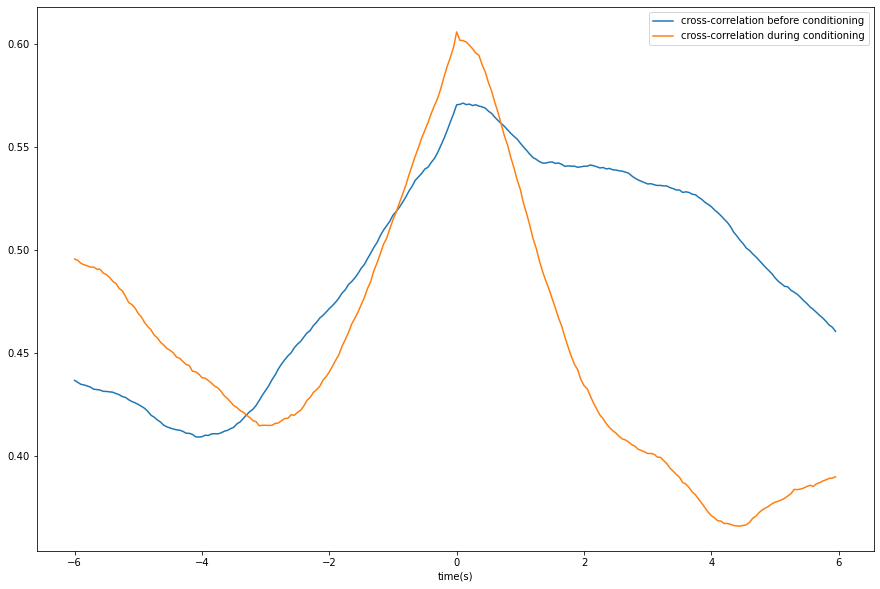

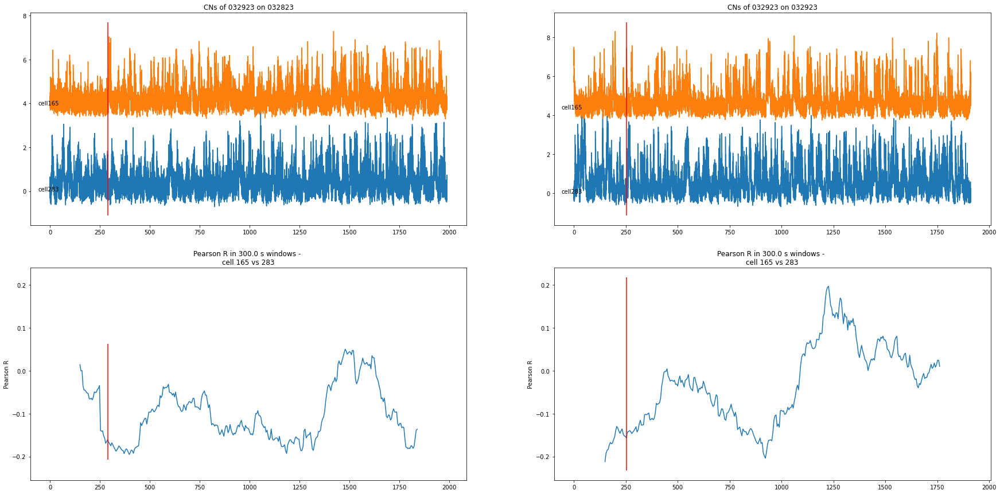

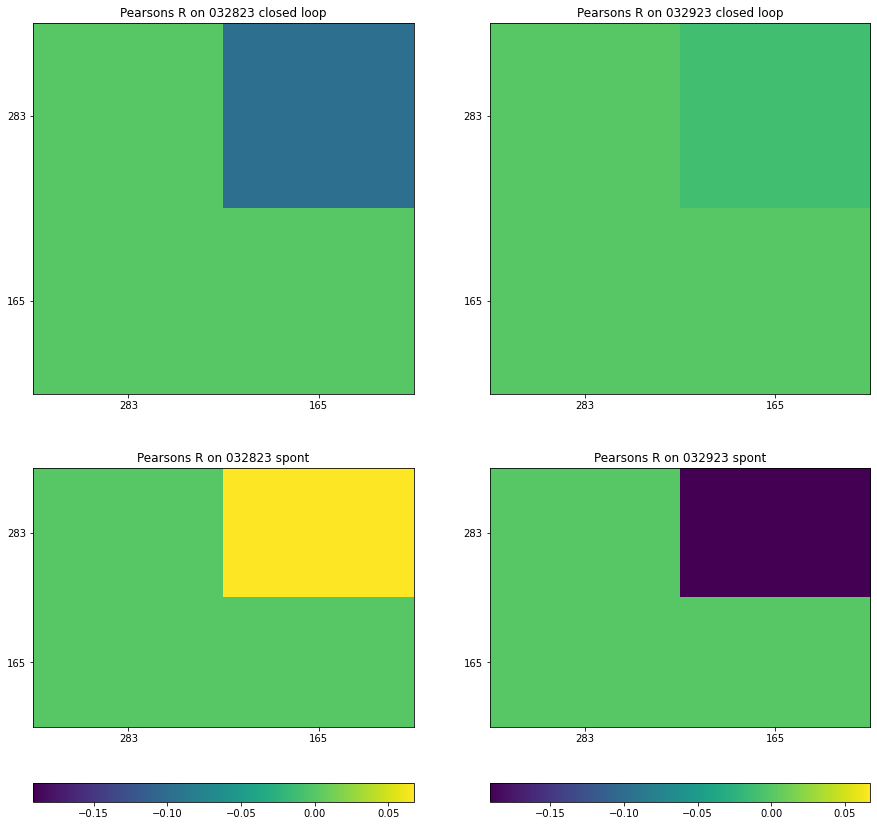

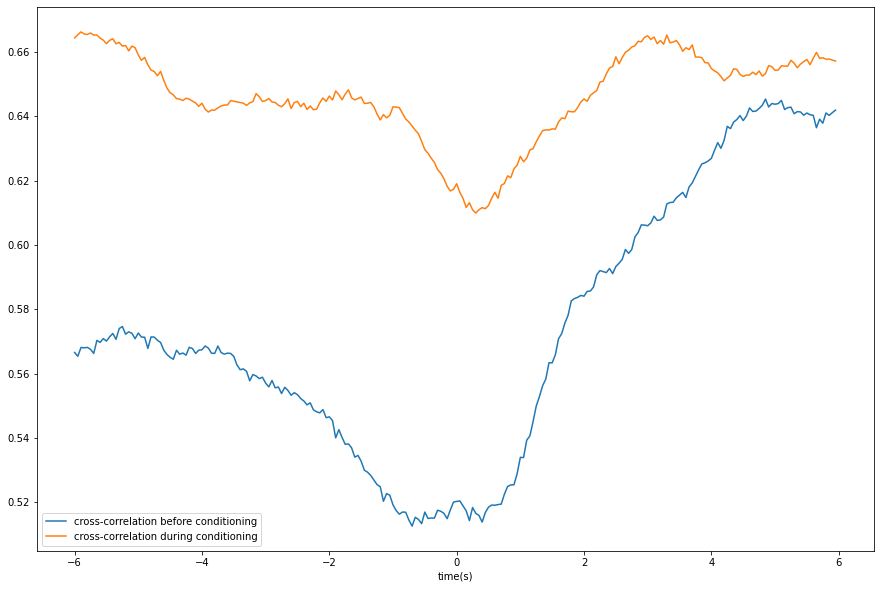

In [81]:
# look at correlations between CNs and compare to previous session(s)

import scipy
#cns = cn_list
#%matplotlib inline


trace_to_use = 'dff_sessionwise'#'F_sessionwise'#'dff_sessionwise'


needed_comments = ['pair']#,'anti']
excluded_comments = ['anti']
plot_stuff = True



for subject in list(data_dict_big.keys()): #['BCI_41']:#
    data_dict = data_dict_big[subject]
    
    # data_dict = data_dict_big[subject].copy()
    # needed_sessions = ['032223','032123']
    # to_pop = []
    # for k in data_dict.keys():
    #     if k not in needed_sessions:
    #         to_pop.append(k)
    # for k in to_pop:
    #     data_dict.pop(k)

    
    
    
    sessions = np.sort(list(data_dict.keys()))
    cn_list = []
    for session in sessions:
        try:
            toadd = None
            i_ = 0
            while toadd is None:
                try:
                    toadd = np.asarray(data_dict[session]['cn'])[i_]
                except:
                    pass
                i_+=1
            #cn_list.append(np.unique(np.asarray(data_dict[session]['cn'])[np.asarray(data_dict[session]['cn'])!=None])) # assuming that the CN is not changing
            cn_list.append(toadd)
            print(toadd)
        except: 
            pass



    for session_i in np.arange(1,len(sessions)):
        
        last_session = session = sessions[session_i]
        previous_session_i = session_i-1
        previous_session = sessions[previous_session_i]

        session_is_needed =True
        for c in needed_comments:
            session_is_needed = session_is_needed and c in data_dict_big[subject][session]['session_comment']
        for c in excluded_comments:
            session_is_needed = session_is_needed and c not in data_dict_big[subject][session]['session_comment']
        #print([data_dict_big[subject][session]['session_comment'],session_is_needed])
        if not session_is_needed:
            continue






        cn_session_i = session_i#previous_session_i#
        cns = np.asarray(cn_list)[cn_session_i]
        #cns = [225,29]
        if len(cns) == 1:
            cns = np.asarray(cn_list)[cn_session_i][0]
        DFFs = data_dict[session][trace_to_use][cns,:]
        if plot_stuff:
            fig = plt.figure(figsize = [30,15])
            ax1 = fig.add_subplot(2,2,2)
            ax1_prev = fig.add_subplot(2,2,1)
            ax1.set_title('CNs of {} on {}'.format(sessions[cn_session_i],session))
            ax1_prev.set_title('CNs of {} on {}'.format(sessions[cn_session_i],previous_session))
        offset =  0
        offset_prev = 0
        corr_matrix = []
        corr_matrix_prev = []
        corr_matrix_labels = []
        window_size =int(np.round(300*data_dict[session]['sampling_rate']))
        window_step = 100

        min_percentile = 50
        exponent = 2
        exclude_post_reward = False
        corr_matrix_dict = {'pearson_spont':np.zeros([len(cns),len(cns)]),
                            'pearson_closed_loop':np.zeros([len(cns),len(cns)]),
                            'pearson_min_closed_loop':np.zeros([len(cns),len(cns)]),
                            'pearson_max_closed_loop':np.zeros([len(cns),len(cns)]),
                            'pearson_spont_prev':np.zeros([len(cns),len(cns)]),
                            'pearson_closed_loop_prev':np.zeros([len(cns),len(cns)]),
                            'pearson_min_closed_loop_prev':np.zeros([len(cns),len(cns)]),
                            'pearson_max_closed_loop_prev':np.zeros([len(cns),len(cns)]),
                            'pearson_closed_loop_all_cells':[],
                            'pearson_min_closed_loop_all_cells':[],
                            'pearson_max_closed_loop_all_cells':[],
                            'pearson_closed_loop_prev_all_cells':[],
                            'pearson_min_closed_loop_prev_all_cells':[],
                            'pearson_max_closed_loop_prev_all_cells':[],
                            'pearson_all_cells_labels':[],
                           }
        end_of_spont_idx = np.sum(np.asarray(data_dict[session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[session]['all_si_filenames']) == data_dict[session]['closed_loop_filenames'][0])[0][0]])
        end_of_spont_idx_prev = np.sum(np.asarray(data_dict[previous_session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[previous_session]['all_si_filenames']) == data_dict[previous_session]['closed_loop_filenames'][0])[0][0]])
        if exclude_post_reward:
            indices_needed = np.ones(data_dict[session]['F_sessionwise'].shape[1])*False
            framenum_start = 0
            for fname,framenum in zip(data_dict[session]['all_si_filenames'],data_dict[session]['all_si_frame_nums']):
                if fname in data_dict[session]['closed_loop_filenames']:
                    idx = np.where(fname == np.asarray(data_dict[session]['closed_loop_filenames']))[0][0]
                    if len(data_dict[session]['reward_times'][idx])>0:
                        reward_frame = int(np.round(data_dict[session]['reward_times'][idx][0]/data_dict[session]['sampling_rate']))
                    else:
                        indices_needed[framenum_start:framenum_start+framenum] = True
                else:
                    indices_needed[framenum_start:framenum_start+framenum] = True
                framenum_start += framenum
            indices_needed_prev = np.ones(data_dict[previous_session]['F_sessionwise'].shape[1])*False
            framenum_start = 0
            for fname,framenum in zip(data_dict[previous_session]['all_si_filenames'],data_dict[previous_session]['all_si_frame_nums']):
                if fname in data_dict[previous_session]['closed_loop_filenames']:
                    idx = np.where(fname == np.asarray(data_dict[previous_session]['closed_loop_filenames']))[0][0]
                    if len(data_dict[previous_session]['reward_times'][idx])>0:
                        reward_frame = int(np.round(data_dict[previous_session]['reward_times'][idx][0]/data_dict[previous_session]['sampling_rate']))
                    else:
                        indices_needed_prev[framenum_start:framenum_start+framenum] = True
                else:
                    indices_needed_prev[framenum_start:framenum_start+framenum] = True
                framenum_start += framenum
        else:
            indices_needed = np.ones(data_dict[session]['F_sessionwise'].shape[1])
            indices_needed_prev = np.ones(data_dict[previous_session]['F_sessionwise'].shape[1])

        indices_needed = indices_needed==1
        indices_needed_prev = indices_needed_prev==1

        for cni,cn in enumerate(cns):



            dff = data_dict[session][trace_to_use][cn,indices_needed]
            timetrace = np.arange(len(dff))/data_dict[session]['sampling_rate']
            if plot_stuff:
                ax1.plot(timetrace,dff+offset)
                ax1.text(-60,offset,'cell{}'.format(cn))
            offset += np.max(dff)

            dff_prev = data_dict[previous_session][trace_to_use][cn,indices_needed_prev]
            timetrace_prev = np.arange(len(dff_prev))/data_dict[previous_session]['sampling_rate']
            if plot_stuff:
                ax1_prev.plot(timetrace_prev,dff_prev+offset_prev)
                ax1_prev.text(-60,offset_prev,'cell{}'.format(cn))
            offset_prev += np.max(dff_prev)

            for cnii,cn2 in enumerate(cns[:cni]):
                dff2 = data_dict[session][trace_to_use][cn2,indices_needed]
                dff2_prev = data_dict[previous_session][trace_to_use][cn2,indices_needed_prev]


                dff_rescaled = dff.copy()
                dff_rescaled = dff_rescaled-np.percentile(dff_rescaled,min_percentile)
                dff_rescaled = dff_rescaled/np.max(dff_rescaled)#*100
                dff_rescaled[dff_rescaled<0] = 0 
                dff_rescaled2 = dff2.copy()
                dff_rescaled2 = dff_rescaled2-np.percentile(dff_rescaled2,min_percentile)
                dff_rescaled2 = dff_rescaled2/np.max(dff_rescaled2)#*100
                dff_rescaled2[dff_rescaled2<0] = 0 

        #         #rrsons_R, pearsons_p = scipy.stats.pearsonr(dff, dff2)
        #         pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_rescaled, dff_rescaled2)

        #         synchrony = np.mean(((dff_rescaled+dff_rescaled2)/2)**exponent)
        #         if use_synchrony:
        #             corr_matrix[cni,cnii] = synchrony#pearsons_R
        #         else:
        #             corr_matrix[cni,cnii] = pearsons_R
        #         synchrony_matrix[cni,cnii] = synchrony
                pearsons_R_spont, pearsons_p = scipy.stats.pearsonr(dff[:end_of_spont_idx], dff2[:end_of_spont_idx])
                corr_matrix_dict['pearson_spont'][cnii,cni] = pearsons_R_spont  #=corr_matrix_dict['pearson_spont'][cnii,cni] = 
                pearsons_R_closed_loop, pearsons_p = scipy.stats.pearsonr(dff[end_of_spont_idx:], dff2[end_of_spont_idx:])
                corr_matrix_dict['pearson_closed_loop'][cnii,cni]  = pearsons_R_closed_loop#=corr_matrix_dict['pearson_closed_loop'][cnii,cni]

                pearsons_R_spont, pearsons_p = scipy.stats.pearsonr(dff_prev[:end_of_spont_idx_prev], dff2_prev[:end_of_spont_idx_prev])
                corr_matrix_dict['pearson_spont_prev'][cnii,cni]  = pearsons_R_spont #=corr_matrix_dict['pearson_spont_prev'][cnii,cni]
                pearsons_R_closed_loop, pearsons_p = scipy.stats.pearsonr(dff_prev[end_of_spont_idx_prev:], dff2_prev[end_of_spont_idx_prev:])
                corr_matrix_dict['pearson_closed_loop_prev'][cnii,cni]  = pearsons_R_closed_loop#=corr_matrix_dict['pearson_closed_loop_prev'][cnii,cni]
                corr_list = []
                window_center_list = []
                for wstart in np.arange(0,len(dff)-window_size+window_step,window_step):
                    wend = wstart + window_size
                    window_center_list.append(wstart+window_size/2)
                    pearsons_R, pearsons_p = scipy.stats.pearsonr(dff[wstart:wend], dff2[wstart:wend])
                    corr_list.append(pearsons_R)
                corr_matrix.append(np.asarray(corr_list))
                corr_matrix_dict['pearson_max_closed_loop'][cnii,cni]  = np.max(corr_list)
                corr_matrix_dict['pearson_min_closed_loop'][cnii,cni]  = np.min(corr_list)
                corr_matrix_labels.append('\ncell {} vs {}'.format(cn,cn2))

                corr_list_prev = []
                window_center_list_prev = []
                for wstart in np.arange(0,len(dff_prev)-window_size+window_step,window_step):
                    wend = wstart + window_size
                    window_center_list_prev.append(wstart+window_size/2)
                    pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_prev[wstart:wend], dff2_prev[wstart:wend])
                    corr_list_prev.append(pearsons_R)
                corr_matrix_prev.append(np.asarray(corr_list_prev))
                corr_matrix_dict['pearson_max_closed_loop_prev'][cnii,cni]  = np.max(corr_list_prev)
                corr_matrix_dict['pearson_min_closed_loop_prev'][cnii,cni]  = np.min(corr_list_prev)


        if plot_stuff:
            ax1.vlines(end_of_spont_idx/data_dict[session]['sampling_rate'],ax1.get_ylim()[0],ax1.get_ylim()[1],color = 'red')   
            ax1_prev.vlines(end_of_spont_idx_prev/data_dict[previous_session]['sampling_rate'],ax1_prev.get_ylim()[0],ax1_prev.get_ylim()[1],color = 'red')   
        corr_matrix = np.asarray(corr_matrix)
        #corr_matrix_norm = corr_matrix-np.nanmean(corr_matrix[:,:3],1)[:,np.newaxis]

        corr_matrix_prev = np.asarray(corr_matrix_prev)

        window_center_list = np.asarray(window_center_list)
        window_center_list_prev = np.asarray(window_center_list_prev)

        if plot_stuff:
            if corr_matrix.shape[0] == 1:
                ax2 = fig.add_subplot(2,2,4,sharex = ax1)
                ax2.plot(window_center_list/data_dict[session]['sampling_rate'],corr_matrix[0,:])
                ax2.set_title('Pearson R in {} s windows - {}'.format(np.round(window_size/data_dict[session]['sampling_rate']),corr_matrix_labels[0]))
                ax2.vlines(end_of_spont_idx/data_dict[session]['sampling_rate'],ax2.get_ylim()[0],ax2.get_ylim()[1],color = 'red')   
                ax2.set_ylabel('Pearson R')
            else:
                ax2 = fig.add_subplot(2,2,4)
                im = ax2.imshow(corr_matrix,aspect = 'auto',interpolation='none')
                fig.colorbar(im, ax=ax2,location = 'bottom')
                ax2.set_yticks(np.arange(len(corr_matrix_labels)))
                ax2.set_yticklabels(corr_matrix_labels)
                ax2.set_title('Pearson R in {} s windows'.format(np.round(window_size/data_dict[session]['sampling_rate'])))

                ax2.vlines(end_of_spont_idx/window_step,ax2.get_ylim()[0],ax2.get_ylim()[1],color = 'red')   


            if corr_matrix.shape[0] == 1:
                ax2_prev = fig.add_subplot(2,2,3,sharex = ax1_prev)
                ax2_prev.plot(window_center_list_prev/data_dict[previous_session]['sampling_rate'],corr_matrix_prev[0,:])
                ax2_prev.set_title('Pearson R in {} s windows - {}'.format(np.round(window_size/data_dict[session]['sampling_rate']),corr_matrix_labels[0]))
                ax2_prev.vlines(end_of_spont_idx_prev/data_dict[previous_session]['sampling_rate'],ax2_prev.get_ylim()[0],ax2_prev.get_ylim()[1],color = 'red')   
                ax2_prev.set_ylabel('Pearson R')
            else:
                ax2_prev = fig.add_subplot(2,2,3)
                im_prev = ax2_prev.imshow(corr_matrix_prev,aspect = 'auto',interpolation='none')
                fig.colorbar(im, ax=ax2_prev,location = 'bottom')
                ax2_prev.set_yticks(np.arange(len(corr_matrix_labels)))
                ax2_prev.set_yticklabels(corr_matrix_labels)
                ax2_prev.set_title('Pearson R in {} s windows'.format(np.round(window_size/data_dict[session]['sampling_rate'])))
                ax2_prev.vlines(end_of_spont_idx_prev/window_step,ax2_prev.get_ylim()[0],ax2_prev.get_ylim()[1],color = 'red')   

            if corr_matrix.shape[0] == 1:
                ax2.set_ylim([np.min([ax2_prev.get_ylim()[0],ax2.get_ylim()[0]]),np.max([ax2_prev.get_ylim()[1],ax2.get_ylim()[1]])])
                ax2_prev.set_ylim([np.min([ax2_prev.get_ylim()[0],ax2.get_ylim()[0]]),np.max([ax2_prev.get_ylim()[1],ax2.get_ylim()[1]])])
            else:
                im.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])
                im_prev.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])


        # ax1.set_xlim([1200,1520])    
        # ax1_prev.set_xlim([1200,1520])    

            fig_crosscorrs = plt.figure(figsize = [15,15])


            ax1_prev_day = fig_crosscorrs.add_subplot(2,2,1)
            im1_prev = ax1_prev_day.imshow(corr_matrix_dict['pearson_closed_loop_prev'],aspect = 'auto',interpolation = 'none')
            ax1_prev_day.set_xticks(np.arange(len(cns)))
            ax1_prev_day.set_xticklabels(cns)
            ax1_prev_day.set_yticks(np.arange(len(cns)))
            ax1_prev_day.set_yticklabels(cns)
            ax1_prev_day.set_title('Pearsons R on {} closed loop'.format(previous_session))


            ax1_test_day = fig_crosscorrs.add_subplot(2,2,2)
            im1 = ax1_test_day.imshow(corr_matrix_dict['pearson_closed_loop'],aspect = 'auto',interpolation = 'none')
            ax1_test_day.set_xticks(np.arange(len(cns)))
            ax1_test_day.set_xticklabels(cns)
            ax1_test_day.set_yticks(np.arange(len(cns)))
            ax1_test_day.set_yticklabels(cns)
            ax1_test_day.set_title('Pearsons R on {} closed loop'.format(session))

            ax1_prev_day_spont = fig_crosscorrs.add_subplot(2,2,3)
            im1_prev_spont = ax1_prev_day_spont.imshow(corr_matrix_dict['pearson_spont_prev'],aspect = 'auto',interpolation = 'none')
            ax1_prev_day_spont.set_xticks(np.arange(len(cns)))
            ax1_prev_day_spont.set_xticklabels(cns)
            ax1_prev_day_spont.set_yticks(np.arange(len(cns)))
            ax1_prev_day_spont.set_yticklabels(cns)
            ax1_prev_day_spont.set_title('Pearsons R on {} spont'.format(previous_session))


            ax1_test_day_spont = fig_crosscorrs.add_subplot(2,2,4)
            im1_spont = ax1_test_day_spont.imshow(corr_matrix_dict['pearson_spont'],aspect = 'auto',interpolation = 'none')
            ax1_test_day_spont.set_xticks(np.arange(len(cns)))
            ax1_test_day_spont.set_xticklabels(cns)
            ax1_test_day_spont.set_yticks(np.arange(len(cns)))
            ax1_test_day_spont.set_yticklabels(cns)
            ax1_test_day_spont.set_title('Pearsons R on {} spont'.format(session))



            im1_prev.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
            im1.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
            im1_prev_spont.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
            im1_spont.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
            fig_crosscorrs.colorbar(im1_spont, ax=ax1_test_day_spont,location = 'bottom')
            fig_crosscorrs.colorbar(im1_spont, ax=ax1_prev_day_spont,location = 'bottom')
            
            
            
            # cross-correlation
            cns = np.asarray(cn_list)[cn_session_i]
            #cns = [37,19]
            cmap = 'coolwarm'
            step_back  = 120
            step_forward = 120
            cc_time = np.arange(-step_back,step_forward)/20
            cni = cns[0]
            cnii = cns[1]
            end_of_spont_idx = np.sum(np.asarray(data_dict[session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[session]['all_si_filenames']) == data_dict[session]['closed_loop_filenames'][0])[0][0]])
            end_of_spont_idx_prev = np.sum(np.asarray(data_dict[previous_session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[previous_session]['all_si_filenames']) == data_dict[previous_session]['closed_loop_filenames'][0])[0][0]])
            start_idx = end_of_spont_idx
            start_idx_prev = end_of_spont_idx_prev
            dff = data_dict[session][trace_to_use][cni,start_idx:]
            dff_prev = data_dict[previous_session][trace_to_use][cni,start_idx_prev:]
            dff2 = data_dict[session][trace_to_use][cnii,start_idx:]
            dff2_prev = data_dict[previous_session][trace_to_use][cnii,start_idx_prev:]

            dff = dff/np.std(dff)
            dff_prev = dff_prev/np.std(dff_prev)
            dff2 = dff2/np.std(dff2)
            dff2_prev = dff2_prev/np.std(dff2_prev)



            cc = scipy.signal.correlate(dff,dff2)/len(dff)
            center = int(len(cc)/2)
            cc = cc[center-step_back:center+step_forward]

            cc_prev = scipy.signal.correlate(dff_prev,dff2_prev)/len(dff_prev)
            center = int(len(cc_prev)/2)
            cc_prev = cc_prev[center-step_back:center+step_forward]
            plt.figure(figsize = [15,10])
            plt.plot(cc_time,cc_prev,label = 'cross-correlation before conditioning')
            plt.plot(cc_time,cc,label = 'cross-correlation during conditioning')
            plt.xlabel('time(s)')
            plt.legend()
            

        # calculate cc for all cells
        cells_to_consider = 100
        #cellnums = np.arange(data_dict[session][trace_to_use].shape[0]) 
        event_rate_copy = data_dict[session]['event_rate'].copy()
        cellnums = np.argsort(event_rate_copy)[::-1][:cells_to_consider]



        for cni,cn in enumerate(cellnums):
            #print(cn)
            dff = data_dict[session][trace_to_use][cn,indices_needed]
            dff_prev = data_dict[previous_session][trace_to_use][cn,indices_needed_prev]
            for cnii,cn2 in enumerate(cellnums[:cni]):
                dff2 = data_dict[session][trace_to_use][cn2,indices_needed]
                dff2_prev = data_dict[previous_session][trace_to_use][cn2,indices_needed_prev]
                pearsons_R_closed_loop, pearsons_p = scipy.stats.pearsonr(dff[end_of_spont_idx:], dff2[end_of_spont_idx:])
                corr_matrix_dict['pearson_closed_loop_all_cells'].append(pearsons_R_closed_loop)
                # if pearsons_R_closed_loop>.3:
                #     print([cni,cnii,pearsons_R_closed_loop])
                # corr_list = []
                # dff_ = dff[end_of_spont_idx:]
                # dff2_ = dff2[end_of_spont_idx:]
                # for wstart in np.arange(0,len(dff_)-window_size+window_step,window_step):
                #     wend = wstart + window_size
                #     pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_[wstart:wend], dff2_[wstart:wend])
                #     corr_list.append(pearsons_R)
                # corr_matrix_dict['pearson_min_closed_loop_all_cells'].append(np.min(corr_list))
                # corr_matrix_dict['pearson_max_closed_loop_all_cells'].append(np.max(corr_list))
                corr_matrix_dict['pearson_all_cells_labels'].append([cn,cn2])
                pearsons_R_closed_loop_prev, pearsons_p = scipy.stats.pearsonr(dff_prev[end_of_spont_idx_prev:], dff2_prev[end_of_spont_idx_prev:])
                corr_matrix_dict['pearson_closed_loop_prev_all_cells'].append(pearsons_R_closed_loop_prev)
                # corr_list = []
        #         dff_prev_ = dff_prev[end_of_spont_idx_prev:]
        #         dff2_prev_ = dff2_prev[end_of_spont_idx_prev:]
        #         for wstart in np.arange(0,len(dff_prev_)-window_size+window_step,window_step):
        #             wend = wstart + window_size
        #             pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_prev_[wstart:wend], dff2_prev_[wstart:wend])
        #             corr_list.append(pearsons_R)
        #         corr_matrix_dict['pearson_min_closed_loop_prev_all_cells'].append(np.min(corr_list))
        #         corr_matrix_dict['pearson_max_closed_loop_prev_all_cells'].append(np.max(corr_list))


        data_dict_big[subject][session]['corr_matrix_dict']= corr_matrix_dict


#ax1.set_xlim([0,5000])




In [37]:
pearsons_values = []
pearsons_values_all = []
to_select = ''
for subject in list(data_dict_big.keys()):
    data_dict = data_dict_big[subject]
    sessions = np.sort(list(data_dict.keys()))
    cn_list = []
    for session in sessions:
        try:
            toadd = None
            i_ = 0
            while toadd is None:
                try:
                    toadd = np.asarray(data_dict[session]['cn'])[i_]
                except:
                    pass
                i_+=1
            #cn_list.append(np.unique(np.asarray(data_dict[session]['cn'])[np.asarray(data_dict[session]['cn'])!=None])) # assuming that the CN is not changing
            cn_list.append(toadd)
            print(toadd)
        except: 
            pass



    for session_i in np.arange(1,len(sessions)):
        
        last_session = session = sessions[session_i]
        previous_session_i = session_i-1
        previous_session = sessions[previous_session_i]
        try:
            corr_matrix_dict = data_dict_big[subject][session]['corr_matrix_dict']
        
            cns = np.asarray(cn_list)[cn_session_i]
            cni = 0
            cnii = 1
            pearsons_values.append([corr_matrix_dict['pearson{}_closed_loop_prev'.format(to_select)][cni,cnii],corr_matrix_dict['pearson{}_closed_loop'.format(to_select)][cni,cnii]])
        except:
            pass
        
       

[16, 57]
[20, 57]
[39, 37]
[11, 146]
[63 37]
[27  6]
[283, 165]
[53, 27]
[426  37]
[94, 770]
[35, 6]
[45  7]
[20, 6]
[2, 41]
[14 10]
[ 2 31]
[27, 16]
[23  6]
[73, 35]
[47 73]
[ 7 29]
[246, 20]
[17, 170]
[17, 170]
[50, 101]
[57, 101]
[ 2 37]


/tmp/ipykernel_31375/1621609699.py:14: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  toadd = np.asarray(data_dict[session]['cn'])[i_]


Text(0, 0.5, 'session #')

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


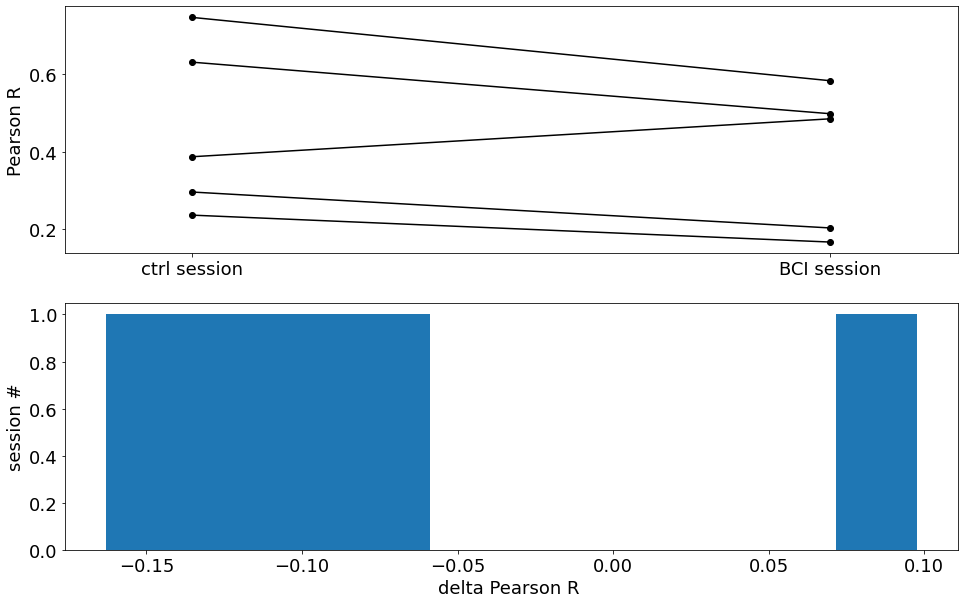

In [38]:
import matplotlib
font = {'family' : 'normal',
        #'weight' : 'bold',
        'size'   : 18}
matplotlib.rc('font', **font)

fig = plt.figure(figsize = [16,10])
ax = fig.add_subplot(2,1,1)
ax.plot(['ctrl session','BCI session'],np.asarray(pearsons_values).T,'ko-')
ax.set_xlim([-.2,1.2])
ax.set_ylabel('Pearson R')
ax2 = fig.add_subplot(2,1,2)
ax2.hist(np.diff(np.asarray(pearsons_values),1))
ax2.set_xlabel('delta Pearson R ')
ax2.set_ylabel('session #')

(array([1., 1., 1., 1., 0., 0., 0., 0., 0., 1.]),
 array([-0.16315664, -0.13706769, -0.11097875, -0.0848898 , -0.05880086,
        -0.03271191, -0.00662296,  0.01946598,  0.04555493,  0.07164388,
         0.09773282]),
 <BarContainer object of 10 artists>)

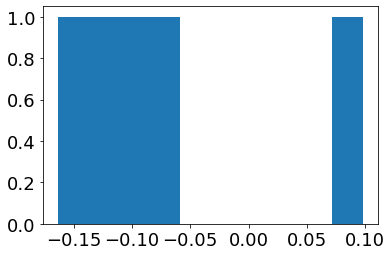

In [39]:
plt.hist(np.diff(np.asarray(pearsons_values),1))

/tmp/ipykernel_13709/2691160069.py:110: RuntimeWarning: invalid value encountered in true_divide
  today_matrix_disp_normalized = 100*(today_matrix_disp - flat_matrix.T)/flat_matrix.T
/tmp/ipykernel_13709/2691160069.py:129: RuntimeWarning: invalid value encountered in true_divide
  yesterday_matrix_disp_normalized = 100*(yesterday_matrix_disp - flat_matrix_yesterday.T)/flat_matrix_yesterday.T


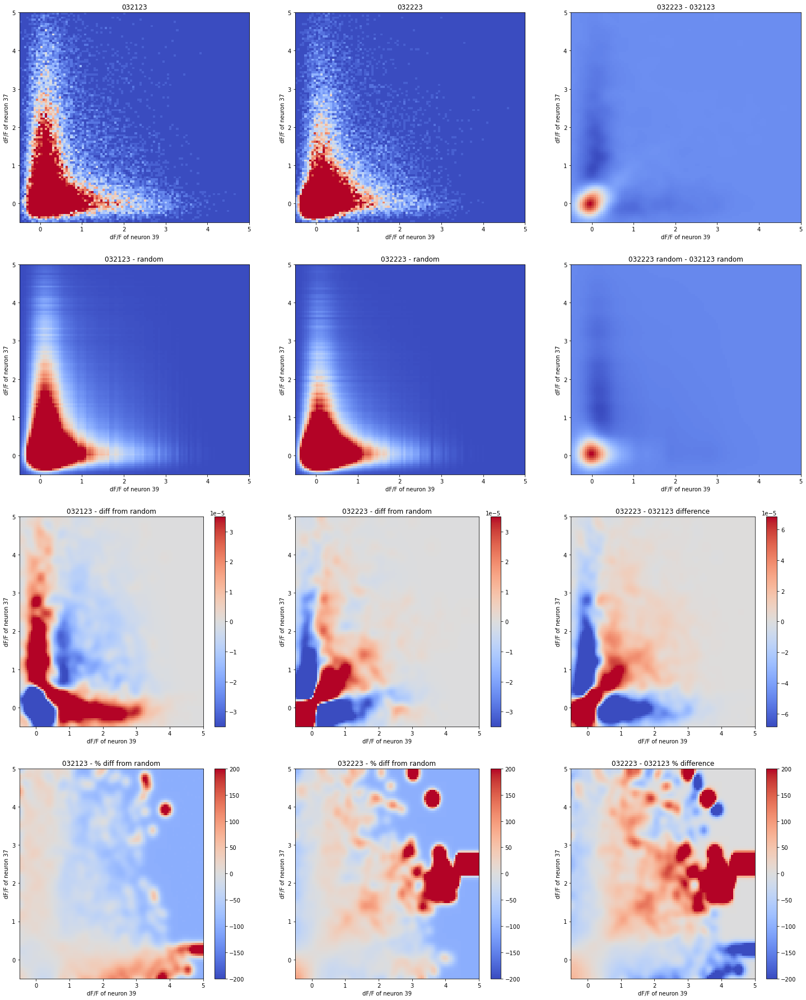

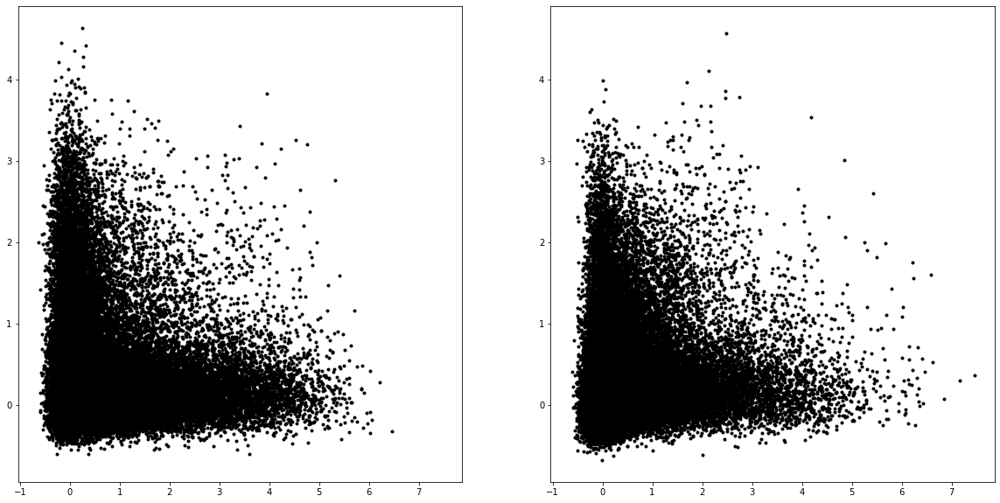

In [76]:
#scatter plot of activity - and histograms

cns = np.asarray(cn_list)[cn_session_i]
#cns = [225,29]
cmap = 'coolwarm'
cni = cns[0]
cnii = cns[1]
start_idx = end_of_spont_idx
start_idx_prev = end_of_spont_idx_prev
dff = data_dict[session][trace_to_use][cni,start_idx:]
dff_prev = data_dict[previous_session][trace_to_use][cni,start_idx_prev:]
    
dff2 = data_dict[session][trace_to_use][cnii,start_idx:]
dff2_prev = data_dict[previous_session][trace_to_use][cnii,start_idx_prev:]

alpha = 1
dff_threshold = -100

binnum = 100
sigmas = [2,2]

bin_range = np.round(2*np.percentile(np.concatenate([dff,dff_prev,dff2,dff2_prev]),[.1,99.9]))/2#[-1,4]
fig = plt.figure(figsize = [25,40])
ax_yesterday = fig.add_subplot(5,3,1)
ax_yesterday.set_title(previous_session)
ax_yesterday.set_xlabel('dF/F of neuron {}'.format(cni))
ax_yesterday.set_ylabel('dF/F of neuron {}'.format(cnii))
ax_today = fig.add_subplot(5,3,2)
ax_today.set_title(session)
ax_today.set_xlabel('dF/F of neuron {}'.format(cni))
ax_today.set_ylabel('dF/F of neuron {}'.format(cnii))

ax_raw_diff = fig.add_subplot(5,3,3)
ax_raw_diff.set_title('{} - {}'.format(session,previous_session))
ax_raw_diff.set_xlabel('dF/F of neuron {}'.format(cni))
ax_raw_diff.set_ylabel('dF/F of neuron {}'.format(cnii))

# ax_diff = fig.add_subplot(3,2,3)
# ax_diff.set_title('{} - {}'.format(session,previous_session))
# ax_diff.set_xlabel('dF/F of neuron {}'.format(cni))
# ax_diff.set_ylabel('dF/F of neuron {}'.format(cnii))
ax_yesterday_random = fig.add_subplot(5,3,4)
ax_yesterday_random.set_title('{} - random'.format(previous_session))
ax_yesterday_random.set_xlabel('dF/F of neuron {}'.format(cni))
ax_yesterday_random.set_ylabel('dF/F of neuron {}'.format(cnii))

ax_today_random = fig.add_subplot(5,3,5)
ax_today_random.set_title('{} - random'.format(session))
ax_today_random.set_xlabel('dF/F of neuron {}'.format(cni))
ax_today_random.set_ylabel('dF/F of neuron {}'.format(cnii))

ax_diff_random = fig.add_subplot(5,3,6)
ax_diff_random.set_title('{} random - {} random'.format(session,previous_session))
ax_diff_random.set_xlabel('dF/F of neuron {}'.format(cni))
ax_diff_random.set_ylabel('dF/F of neuron {}'.format(cnii))



ax_yesterday_diff = fig.add_subplot(5,3,7)
ax_yesterday_diff.set_title('{} - diff from random'.format(previous_session))
ax_yesterday_diff.set_xlabel('dF/F of neuron {}'.format(cni))
ax_yesterday_diff.set_ylabel('dF/F of neuron {}'.format(cnii))
ax_today_diff = fig.add_subplot(5,3,8)
ax_today_diff.set_title('{} - diff from random'.format(session))
ax_today_diff.set_xlabel('dF/F of neuron {}'.format(cni))
ax_today_diff.set_ylabel('dF/F of neuron {}'.format(cnii))



ax_yesterday_norm = fig.add_subplot(5,3,10)
ax_yesterday_norm.set_title('{} - % diff from random'.format(previous_session))
ax_yesterday_norm.set_xlabel('dF/F of neuron {}'.format(cni))
ax_yesterday_norm.set_ylabel('dF/F of neuron {}'.format(cnii))
ax_today_norm = fig.add_subplot(5,3,11)
ax_today_norm.set_title('{} - % diff from random'.format(session))
ax_today_norm.set_xlabel('dF/F of neuron {}'.format(cni))
ax_today_norm.set_ylabel('dF/F of neuron {}'.format(cnii))

ax_diff = fig.add_subplot(5,3,9)
ax_diff.set_title('{} - {} difference'.format(session,previous_session))
ax_diff.set_xlabel('dF/F of neuron {}'.format(cni))
ax_diff.set_ylabel('dF/F of neuron {}'.format(cnii))
ax_diff_norm = fig.add_subplot(5,3,12)
ax_diff_norm.set_title('{} - {} % difference'.format(session,previous_session))
ax_diff_norm.set_xlabel('dF/F of neuron {}'.format(cni))
ax_diff_norm.set_ylabel('dF/F of neuron {}'.format(cnii))


needed = dff_prev + dff2_prev > dff_threshold
yesterday_matrix = np.histogram2d(dff_prev[needed],dff2_prev[needed],bins = [binnum,binnum],range = [bin_range,bin_range])
yesterday_matrix_disp = yesterday_matrix[0]/np.sum(yesterday_matrix[0])

needed = dff + dff2 > dff_threshold
today_matrix = np.histogram2d(dff[needed],dff2[needed],bins = [binnum,binnum],range = [bin_range,bin_range])
today_matrix_disp = today_matrix[0]/np.sum(today_matrix[0])

dff_hist = np.histogram(dff,bins = binnum,range = bin_range)[0]
dff_hist = dff_hist/np.sum(dff_hist)
dff2_hist = np.histogram(dff2,bins = binnum,range = bin_range)[0]
dff2_hist = dff2_hist/np.sum(dff2_hist)

flat_matrix = np.ones([len(dff_hist),len(dff2_hist)])
flat_matrix=  flat_matrix*dff_hist
flat_matrix = flat_matrix.T
flat_matrix=  flat_matrix*dff2_hist
flat_matrix = flat_matrix.T
flat_matrix = flat_matrix/np.sum(flat_matrix)
# today_matrix_disp_normalized = today_matrix_disp/flat_matrix.T
# today_matrix_disp_normalized[today_matrix_disp_normalized>3]=3
today_matrix_disp_normalized = 100*(today_matrix_disp - flat_matrix.T)/flat_matrix.T
today_matrix_disp_normalized = 100*(scipy.ndimage.gaussian_filter(today_matrix_disp,sigmas) - scipy.ndimage.gaussian_filter(flat_matrix.T,sigmas))/scipy.ndimage.gaussian_filter(flat_matrix.T,sigmas)
today_matrix_disp_delta_random = scipy.ndimage.gaussian_filter(today_matrix_disp,sigmas) - scipy.ndimage.gaussian_filter(flat_matrix.T,sigmas)


dff_hist = np.histogram(dff_prev,bins = binnum,range = bin_range)[0]
dff_hist = dff_hist/np.sum(dff_hist)
dff2_hist = np.histogram(dff2_prev,bins = binnum,range = bin_range)[0]
dff2_hist = dff2_hist/np.sum(dff2_hist)

flat_matrix_yesterday = np.ones([len(dff_hist),len(dff2_hist)])
flat_matrix_yesterday=  flat_matrix_yesterday*dff_hist
flat_matrix_yesterday = flat_matrix_yesterday.T
flat_matrix_yesterday=  flat_matrix_yesterday*dff2_hist
flat_matrix_yesterday = flat_matrix_yesterday.T
flat_matrix_yesterday = flat_matrix_yesterday/np.sum(flat_matrix_yesterday)

# yesterday_matrix_disp_normalized = yesterday_matrix_disp/flat_matrix_yesterday.T
# yesterday_matrix_disp_normalized[yesterday_matrix_disp_normalized>3]=3
yesterday_matrix_disp_normalized = 100*(yesterday_matrix_disp - flat_matrix_yesterday.T)/flat_matrix_yesterday.T
yesterday_matrix_disp_normalized = 100*(scipy.ndimage.gaussian_filter(yesterday_matrix_disp,sigmas) - scipy.ndimage.gaussian_filter(flat_matrix_yesterday.T,sigmas))/scipy.ndimage.gaussian_filter(flat_matrix_yesterday.T,sigmas)
yesterday_matrix_disp_delta_random = (scipy.ndimage.gaussian_filter(yesterday_matrix_disp,sigmas) - scipy.ndimage.gaussian_filter(flat_matrix_yesterday.T,sigmas))

im_yesterday = ax_yesterday.imshow(yesterday_matrix_disp,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
im_today = ax_today.imshow(today_matrix_disp,extent = [today_matrix[1][0],today_matrix[1][-1],today_matrix[2][0],today_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
climits = np.percentile(np.concatenate([today_matrix_disp.flatten(),yesterday_matrix_disp.flatten()]),[.1,99.9]) 
climits = np.percentile(np.concatenate([flat_matrix_yesterday.flatten(),flat_matrix.flatten()]),[5,95]) 
im_yesterday.set_clim(climits)
im_today.set_clim(climits)

diff_matrix = scipy.ndimage.gaussian_filter(today_matrix_disp-yesterday_matrix_disp,sigmas)
im_diff = ax_raw_diff.imshow(diff_matrix,extent = [today_matrix[1][0],today_matrix[1][-1],today_matrix[2][0],today_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')



im_yesterday_random = ax_yesterday_random.imshow(flat_matrix_yesterday.T,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
im_today_random = ax_today_random.imshow(flat_matrix.T,extent = [today_matrix[1][0],today_matrix[1][-1],today_matrix[2][0],today_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
im_yesterday_random.set_clim(climits)
im_today_random.set_clim(climits)

diff_matrix_random = scipy.ndimage.gaussian_filter(flat_matrix.T-flat_matrix_yesterday.T,sigmas)
im_diff_random = ax_diff_random.imshow(diff_matrix_random,extent = [today_matrix[1][0],today_matrix[1][-1],today_matrix[2][0],today_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')


im_yesterday = ax_yesterday_diff.imshow(yesterday_matrix_disp_delta_random,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
im_today = ax_today_diff.imshow(today_matrix_disp_delta_random,extent = [today_matrix[1][0],today_matrix[1][-1],today_matrix[2][0],today_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
vals_now = np.concatenate([today_matrix_disp_delta_random.flatten(),yesterday_matrix_disp_delta_random.flatten()])
vals_now = vals_now[np.isnan(vals_now)==False]
climits = np.percentile(vals_now,[5,95]) #[-200,200] [-50,50]#
c = np.max(np.abs(climits))
climits = [-c,c]
im_yesterday.set_clim(climits)
im_today.set_clim(climits)
fig.colorbar(im_today, ax=ax_today_diff)#,location = 'center')
fig.colorbar(im_yesterday, ax=ax_yesterday_diff)#,location = 'center')


im_yesterday = ax_yesterday_norm.imshow(yesterday_matrix_disp_normalized,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
im_today = ax_today_norm.imshow(today_matrix_disp_normalized,extent = [today_matrix[1][0],today_matrix[1][-1],today_matrix[2][0],today_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
vals_now = np.concatenate([today_matrix_disp_normalized.flatten(),yesterday_matrix_disp_normalized.flatten()])
vals_now = vals_now[np.isnan(vals_now)==False]
climits = [-200,200]#np.percentile(vals_now,[5,95]) #[-200,200] [-50,50]#
c = np.max(np.abs(climits))
climits = [-c,c]
im_yesterday.set_clim(climits)
im_today.set_clim(climits)
fig.colorbar(im_today, ax=ax_today_norm)#,location = 'center')
fig.colorbar(im_yesterday, ax=ax_yesterday_norm)#,location = 'center')


delta_matrix = today_matrix_disp_delta_random-yesterday_matrix_disp_delta_random
im_diff = ax_diff.imshow(delta_matrix,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
vals_now = delta_matrix.flatten()
vals_now = vals_now[np.isnan(vals_now)==False]
climits = np.percentile(vals_now,[5,95]) #[-200,200] [-50,50]#
c = np.max(np.abs(climits))
climits = [-c,c]
im_diff.set_clim(climits)
fig.colorbar(im_diff, ax=ax_diff)#,location = 'center')



delta_matrix_norm = today_matrix_disp_normalized-yesterday_matrix_disp_normalized
im_diff_norm = ax_diff_norm.imshow(delta_matrix_norm,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
vals_now = delta_matrix_norm.flatten()
vals_now = vals_now[np.isnan(vals_now)==False]
climits = [-200,200]#np.percentile(vals_now,[5,95]) #[-200,200] [-50,50]#
c = np.max(np.abs(climits))
climits = [-c,c]
im_diff_norm.set_clim(climits)
fig.colorbar(im_diff_norm, ax=ax_diff_norm)#,location = 'center')






fig = plt.figure(figsize = [20,10])
ax_prev = fig.add_subplot(1,2,1)
ax_now = fig.add_subplot(1,2,2,sharex = ax_prev,sharey = ax_prev)
ax_prev.plot(dff_prev,dff2_prev,'k.',alpha = alpha)

ax_now.plot(dff,dff2,'k.',alpha = alpha)

Text(0, 0.5, 'dF/F of neuron 98')

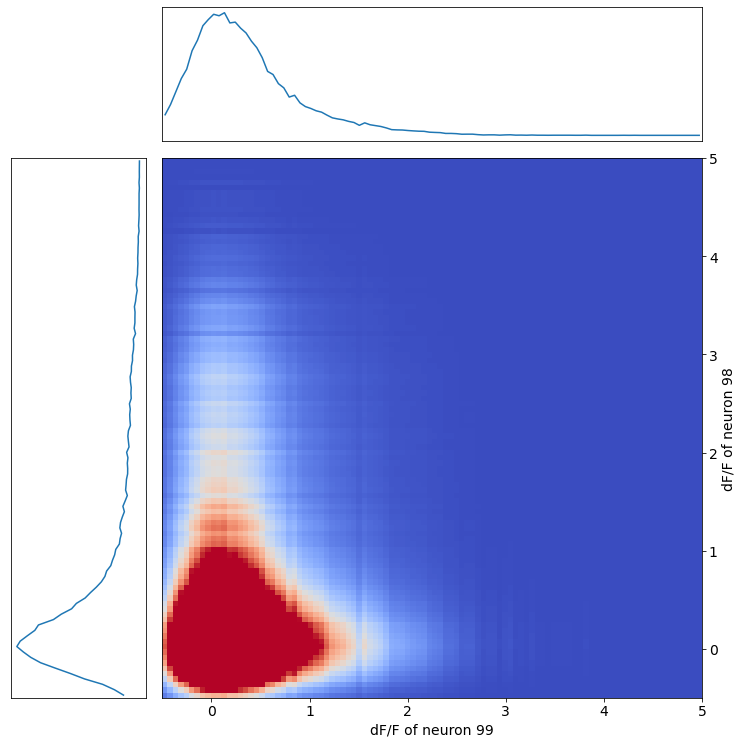

In [511]:
# binnum = 100
# sigmas = [2,2]
# bin_range = np.round(2*np.percentile(np.concatenate([dff,dff_prev,dff2,dff2_prev]),[.1,99.9]))/2#[-1,4]

# dff_prev = 
# dff_


# yesterday_matrix = np.histogram2d(dff_prev[needed],dff2_prev[needed],bins = [binnum,binnum],range = [bin_range,bin_range])
# yesterday_matrix_disp = yesterday_matrix[0]/np.sum(yesterday_matrix[0])


# im_yesterday = ax_yesterday.imshow(yesterday_matrix_disp,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)#,interpolation='antialiased')
# climits = np.percentile(np.concatenate([flat_matrix_yesterday.flatten(),flat_matrix_yesterday.flatten()]),[5,95]) 
# im_yesterday.set_clim(climits)
# im_today.set_clim(climits)





dff_hist,hist_range = np.histogram(dff_prev,bins = binnum,range = bin_range)
hist_range = np.nanmean([hist_range[:-1],hist_range[1:]],0)
dff_hist = dff_hist/np.sum(dff_hist)
dff2_hist = np.histogram(dff2_prev,bins = binnum,range = bin_range)[0]
dff2_hist = dff2_hist/np.sum(dff2_hist)

flat_matrix = np.ones([len(dff_hist),len(dff2_hist)])
#flat_matrix += dff_hist
flat_matrix=  flat_matrix*dff_hist
flat_matrix = flat_matrix.T
#flat_matrix += dff2_hist
flat_matrix=  flat_matrix*dff2_hist
flat_matrix = flat_matrix.T
flat_matrix = flat_matrix/np.sum(flat_matrix)



fig = plt.figure(figsize=(12, 12))
gs = fig.add_gridspec(2, 2,  width_ratios=(1, 4), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 1])

ax_histx = fig.add_subplot(gs[0, 1], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 0], sharey=ax)
ax.yaxis.tick_right()
ax.yaxis.set_label_position("right")

ax_histx.axes.get_xaxis().set_visible(False)
ax_histx.axes.get_yaxis().set_visible(False)
ax_histy.axes.get_xaxis().set_visible(False)
ax_histy.axes.get_yaxis().set_visible(False)

ax_histx.plot(hist_range,dff_hist)
ax_histy.plot(dff2_hist*-1,hist_range)
im = ax.imshow(flat_matrix,extent = [yesterday_matrix[1][0],yesterday_matrix[1][-1],yesterday_matrix[2][0],yesterday_matrix[2][-1]],aspect = 'auto',origin = 'lower',cmap=cmap)
climits = np.percentile(np.concatenate([flat_matrix.flatten(),flat_matrix.flatten()]),[5,95]) 
im.set_clim(climits)
ax.set_xlabel('dF/F of neuron {}'.format(cni))
ax.set_ylabel('dF/F of neuron {}'.format(cnii))

In [109]:
model.isort[39]

496

In [40]:

from rastermap import Rastermap
model = Rastermap(n_components=2, n_X=10, nPC=50, init='pca')
model.fit(DFF_all.T)
fig = plt.figure(figsize = [20,10])
im = plt.imshow(DFF_all[ :,model.isort].T,aspect = 'auto')
im.set_clim([-1,5])

nmin 50
0.24859309196472168
5.488210201263428
5.75566029548645
5.927167654037476
(80, 100)
(32,)
1.0
time; iteration;  explained PC variance
0.68s     0        0.1455      8
3.71s    10        0.3463      48
6.61s    20        0.3766      80
10.27s    30        0.3795      80
10.56s   final      0.3797


Process ForkPoolWorker-10:
Process ForkPoolWorker-11:
Process ForkPoolWorker-16:
Process ForkPoolWorker-3:
Process ForkPoolWorker-1:
Process ForkPoolWorker-4:
Process ForkPoolWorker-8:
Process ForkPoolWorker-15:
Process ForkPoolWorker-13:
Process ForkPoolWorker-14:
Process ForkPoolWorker-6:
Process ForkPoolWorker-12:
Process ForkPoolWorker-7:
Process ForkPoolWorker-2:
Process ForkPoolWorker-5:
Process ForkPoolWorker-9:
/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/rastermap/mapping.py:650: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if self.mode is 'parallel':
/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/rastermap/mapping.py:685: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if self.mode is 'parallel':
/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/rastermap/mapping.py:706: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if self.mode is 'parallel':
/opt/conda/envs/bci_with_suite2p/lib/python3.8/site-packages/

KeyboardInterrupt: 

In [63]:
model.embedding.shape

(97088, 2)

In [ ]:
session_1_end = DFF_prev.shape[1]
plt.plot(model.embedding[:session_1_end,0],model.embedding[:session_1_end,1],'k.',alpha = .01)
plt.plot(model.embedding[session_1_end:,0],model.embedding[session_1_end:,1],'r.',alpha = .01)

In [15]:
data_dict[session]['events_clean'].shape

(1122, 60723)

In [20]:
len(model.isort)

799

In [44]:
from rastermap import Rastermap
model = Rastermap(n_components=2, n_X=10, nPC=50, init='pca')
events_clean = data_dict[session]['events_clean'][needed_cells,:]
model.fit(events_clean)



# fig = plt.figure(figsize = [15,15])
# plt.imshow(data_dict[session]['events_clean'],aspect = 'auto',interpolation = 'none')

nmin 50
0.1615462303161621
3.9352023601531982
4.017974853515625
4.020121335983276
(80, 100)
(32,)
1.0
time; iteration;  explained PC variance
0.01s     0        0.2310      8
0.09s    10        0.5369      48
0.18s    20        0.6215      80
0.29s    30        0.6215      80
0.30s   final      0.6215
2.01s upsampled    0.6215


In [60]:
data_dict[session][trace_to_use].shape

(1122, 60723)

In [61]:
data_dict[session]['F_sessionwise'].shape

(1122, 60723)

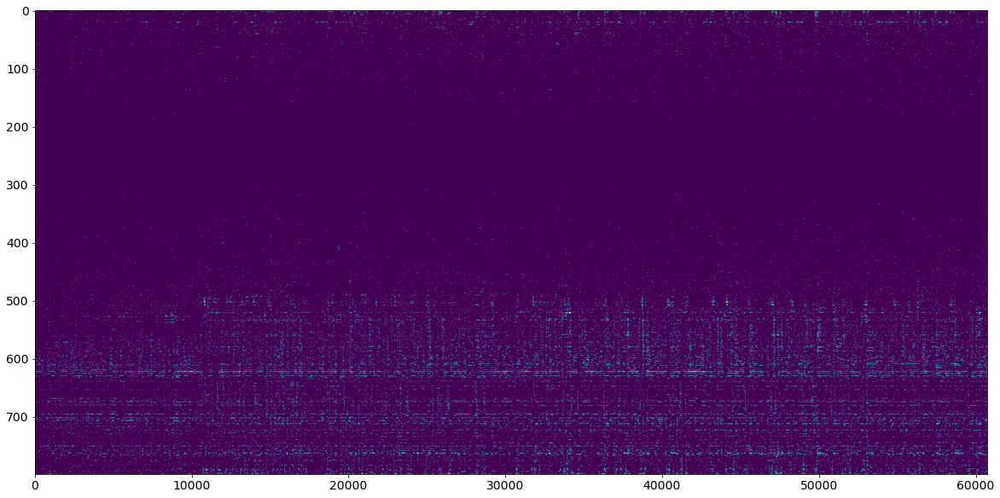

In [45]:
fig = plt.figure(figsize = [20,10])
im = plt.imshow(events_clean[model.isort,:],aspect = 'auto')
im.set_clim([0,3])


In [28]:
# look at PCA in the two sessions and look at differences
from sklearn.decomposition import PCA, FactorAnalysis
from sklearn.preprocessing import StandardScaler
import random

def movingaverage(DFF,win):
    dff_list = []
    for i in range(win):
        dff_list.append(np.roll(DFF,i,axis = 1))
    DFF_averaged = np.nanmean(np.asarray(dff_list),0)
    return DFF_averaged
trace_to_use = 'events_clean'#'dff_sessionwise'#'dff_sessionwise'
moving_win = 0
normalize_before_PCA = False
minimum_pixel_num = 60
needed_cells = np.asarray(pixel_num_list)>minimum_pixel_num
cns = np.asarray(cn_list)[sessions==session].squeeze()
cns = [np.where(np.where(needed_cells)[0]==cns[0])[0][0],np.where(np.where(needed_cells)[0]==cns[1])[0][0]]

#needed_cells = np.arange(len(pixel_num_list))
end_of_spont_idx = np.sum(np.asarray(data_dict[session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[session]['all_si_filenames']) == data_dict[session]['closed_loop_filenames'][0])[0][0]])
end_of_spont_idx_prev = np.sum(np.asarray(data_dict[previous_session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[previous_session]['all_si_filenames']) == data_dict[previous_session]['closed_loop_filenames'][0])[0][0]])


DFF = data_dict[session][trace_to_use][needed_cells,end_of_spont_idx:]          #timepoints+end_of_spont_idx]

DFF_prev = data_dict[previous_session][trace_to_use][needed_cells,end_of_spont_idx_prev:]
DFF_all = np.concatenate([DFF,DFF_prev],1)

if moving_win>0:
    DFF = movingaverage(DFF,moving_win)
    DFF_prev = movingaverage(DFF_prev,moving_win)
    DFF_all = movingaverage(DFF_all,moving_win)


n_components = DFF.shape[0]


pca = PCA(n_components=n_components)
pca_prev = PCA(n_components=n_components)
pca_all = PCA(n_components=n_components)
if normalize_before_PCA:
    scaler = StandardScaler()
    DFF_scaled = scaler.fit_transform(DFF.T).T
    pcs = pca.fit_transform(DFF_scaled.T)
    DFF_prev_scaled = scaler.fit_transform(DFF_prev.T).T
    pcs_prev = pca_prev.fit_transform(DFF_prev_scaled.T)
    DFF_all_scaled = scaler.fit_transform(DFF_all.T).T
    pcs_all = pca_all.fit_transform(DFF_all_scaled.T)
else:
    pcs = pca.fit_transform(DFF.T)
    
    pcs_prev = pca_prev.fit_transform(DFF_prev.T)
    pcs_all = pca_all.fit_transform(DFF_all.T)



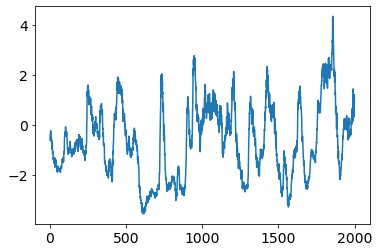

In [47]:
plt.plot(pcs[:2000,0])

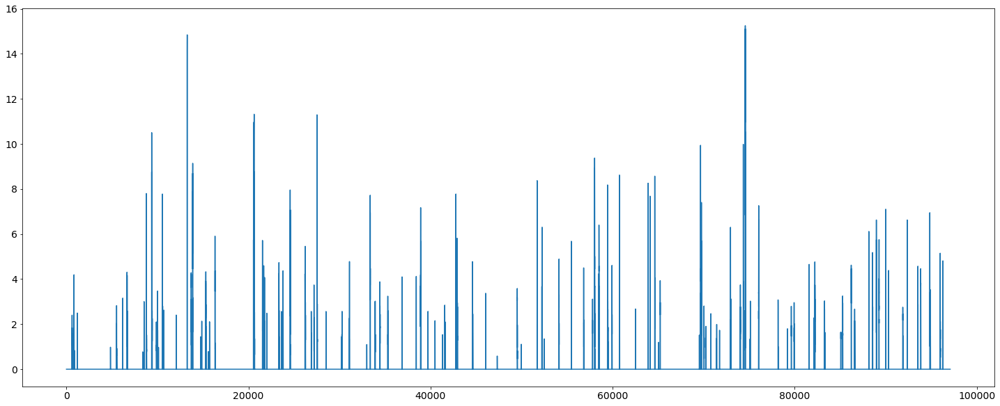

In [54]:
fig =plt.figure(figsize = [25,10])
plt.plot(DFF_all[cns[0],:]*DFF_all[cns[1],:])

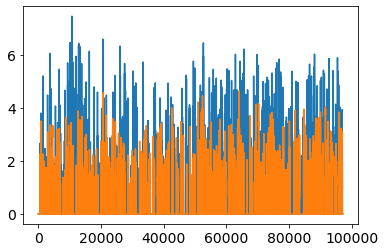

In [52]:
plt.plot(DFF_all[cns[0],:])
plt.plot(DFF_all[cns[1],:])

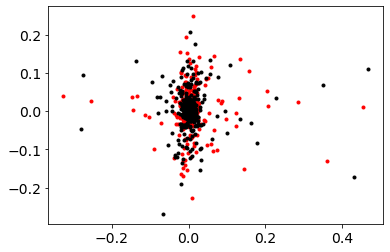

In [50]:
max_pcs = 500

cns = np.asarray(cn_list)[sessions==session].squeeze()
cns = [np.where(np.where(needed_cells)[0]==cns[0])[0][0],np.where(np.where(needed_cells)[0]==cns[1])[0][0]]
plt.plot(pca.components_[:max_pcs,cns[0]],pca.components_[:max_pcs,cns[1]],'r.')
plt.plot(pca_prev.components_[:max_pcs,cns[0]],pca_prev.components_[:max_pcs,cns[1]],'k.')


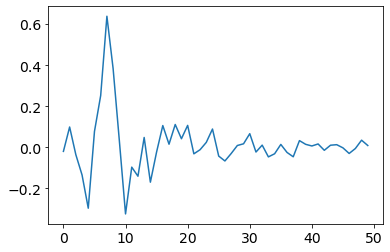

In [237]:
plt.plot(pca.components_[:50,39])


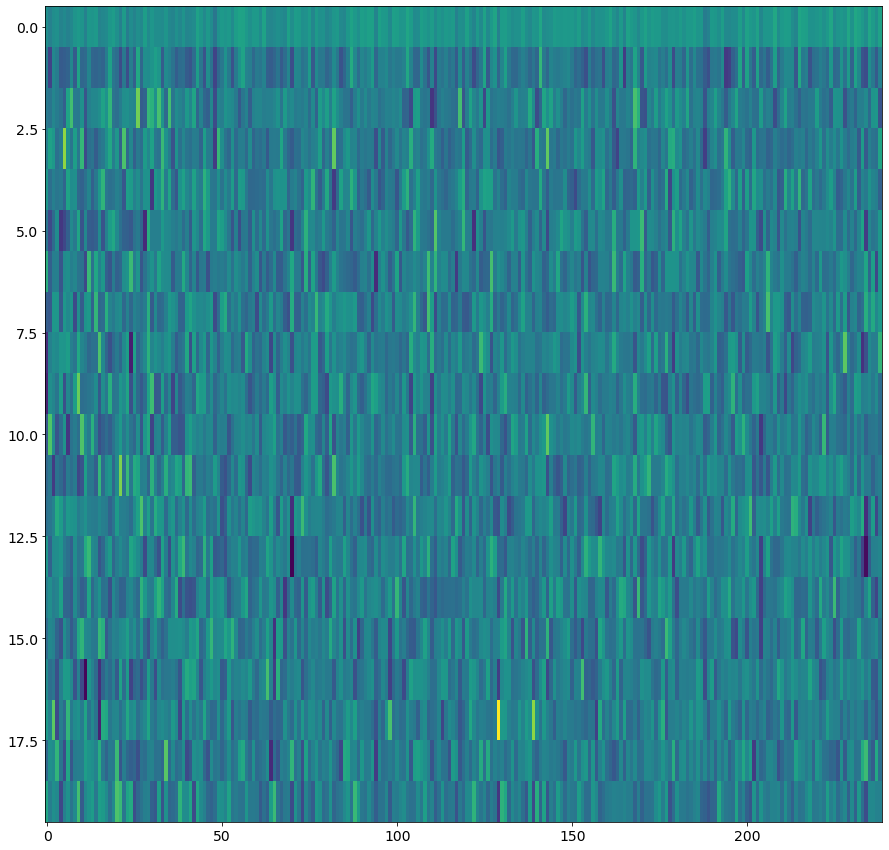

In [335]:
fig = plt.figure(figsize = [15,15])
plt.imshow(pca.components_[:20,:],aspect='auto',interpolation = 'none')

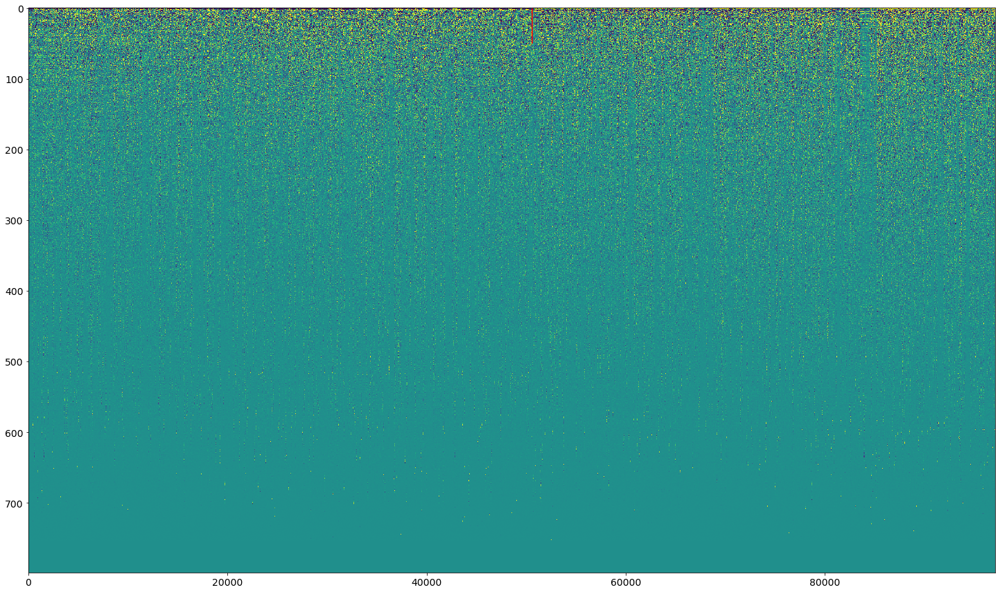

In [32]:
fig = plt.figure(figsize = [25,15])
im = plt.imshow(pcs_all.T,aspect = 'auto',interpolation = 'none')
plt.vlines(DFF.shape[1],0,50,color = 'red')
im.set_clim([-1,1])

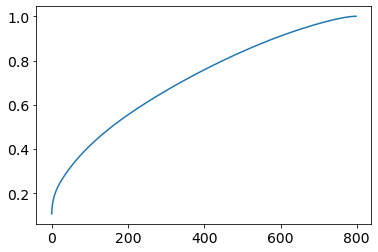

In [355]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))

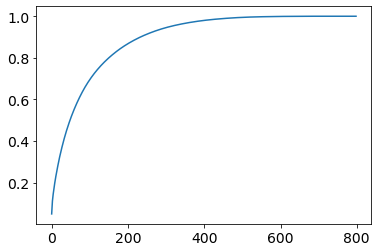

In [57]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))

In [59]:
## PCA - find dimensionality?? - not sure if useful
from sklearn.decomposition import PCA, FactorAnalysis
import random
n_components = 20
minimum_pixel_num = 80
needed_cells = np.asarray(pixel_num_list)>minimum_pixel_num
#needed_cells = np.arange(len(pixel_num_list))
#timepoints = 340000
pca_list = []
for session_now in sessions:
    end_of_spont_idx = np.sum(np.asarray(data_dict[session_now]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[session_now]['all_si_filenames']) == data_dict[session_now]['closed_loop_filenames'][0])[0][0]])

    DFF = data_dict[session_now][trace_to_use][needed_cells,end_of_spont_idx:].T             #timepoints+end_of_spont_idx]
    shuffled_order = np.arange(DFF.shape[0])
    #random.shuffle(shuffled_order)
    DFF_shuffled = DFF[shuffled_order,:]
    var_exp_list = []
    var_exp_held_out_list = []
    n_components_list = np.arange(1,20,1)
    for n_components in n_components_list:
        pca = FactorAnalysis(n_components=n_components)
        pca.fit(DFF_shuffled[:int(len(shuffled_order)/2),:])
        # var_explained = np.mean((pca.inverse_transform((pca.transform(DFF_shuffled[:int(len(shuffled_order)/2),:]))) -  DFF_shuffled[:int(len(shuffled_order)/2),:])**2)
        # var_explained_held_out = np.mean((pca.inverse_transform((pca.transform(DFF_shuffled[int(len(shuffled_order)/2):,:]))) -  DFF_shuffled[int(len(shuffled_order)/2):,:])**2)
        
        var_explained = pca.score(DFF_shuffled[:int(len(shuffled_order)/2),:])
        var_explained_held_out = pca.score(DFF_shuffled[int(len(shuffled_order)/2):,:])
        
        var_exp_list.append(var_explained)
        var_exp_held_out_list.append(var_explained_held_out)
       # asdsa
    asdas
    print(DFF.shape)
    
    pca_list.append(pca)
    
    #asd

NameError: name 'asdas' is not defined

In [434]:
pca.n_components_
pca.score

20

In [ ]:
a  =pca.inverse_transform((pca.transform(DFF_shuffled[:int(len(shuffled_order)/2),:])))
a_orig = DFF_shuffled[:int(len(shuffled_order)/2),:]

In [ ]:
plt.plot(a_orig[:,0])
plt.plot(a[:,0])


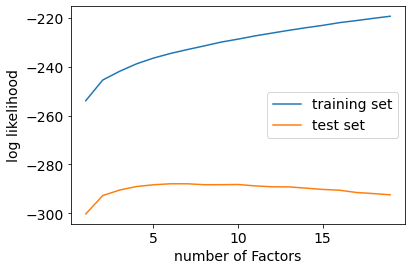

In [60]:
plt.plot(n_components_list,var_exp_list,label = 'training set')
plt.plot(n_components_list,var_exp_held_out_list,label = 'test set')
plt.ylabel('log likelihood')
plt.xlabel('number of Factors')
plt.legend()

In [411]:
var_explained_held_out

0.15921691

In [403]:
np.mean((pca.transform(DFF_shuffled[:int(len(shuffled_order)/2),:])

ValueError: operands could not be broadcast together with shapes (9919,20) (9919,505) 

In [360]:
# define signal subspace and noise subspace with PCA
# split data in half
# calculate the covariance matrices
# the eigenvalues of the sum of the covariance matrices will be the signal
# the eigenvalues of the subtraction of the covariance matrices will be the noise
# first PCs will be very different, rest will be similar

# look at variance explained on held-out data

63

In [75]:
end_of_spont_idx_prev

6062

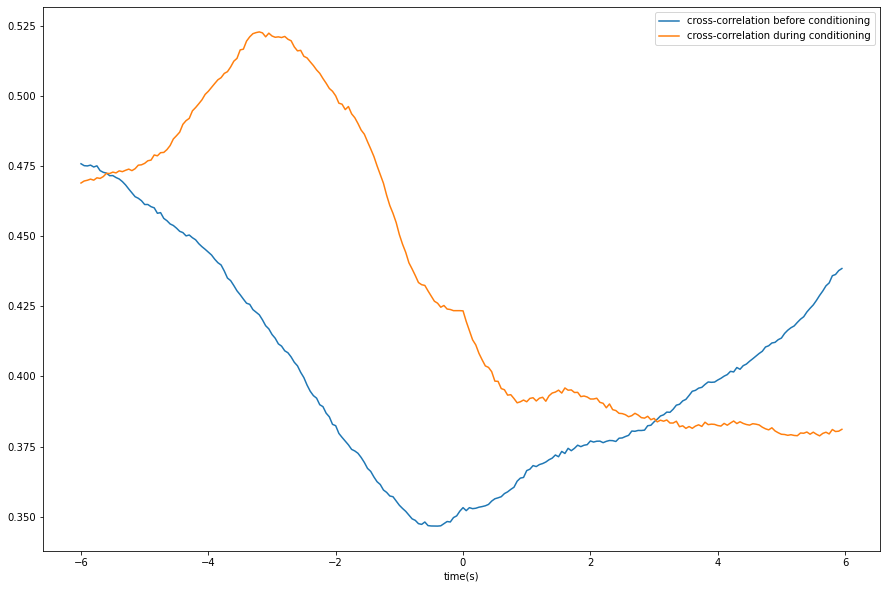

In [73]:
# cross-correlation
cns = np.asarray(cn_list)[cn_session_i]
#cns = [37,19]
cmap = 'coolwarm'
step_back  = 120
step_forward = 120
cc_time = np.arange(-step_back,step_forward)/20
cni = cns[0]
cnii = cns[1]
end_of_spont_idx = np.sum(np.asarray(data_dict[session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[session]['all_si_filenames']) == data_dict[session]['closed_loop_filenames'][0])[0][0]])
end_of_spont_idx_prev = np.sum(np.asarray(data_dict[previous_session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[previous_session]['all_si_filenames']) == data_dict[previous_session]['closed_loop_filenames'][0])[0][0]])
start_idx = end_of_spont_idx
start_idx_prev = end_of_spont_idx_prev
dff = data_dict[session][trace_to_use][cni,start_idx:]
dff_prev = data_dict[previous_session][trace_to_use][cni,start_idx_prev:]
dff2 = data_dict[session][trace_to_use][cnii,start_idx:]
dff2_prev = data_dict[previous_session][trace_to_use][cnii,start_idx_prev:]

dff = dff/np.std(dff)
dff_prev = dff_prev/np.std(dff_prev)
dff2 = dff2/np.std(dff2)
dff2_prev = dff2_prev/np.std(dff2_prev)



cc = scipy.signal.correlate(dff,dff2)/len(dff)
center = int(len(cc)/2)
cc = cc[center-step_back:center+step_forward]

cc_prev = scipy.signal.correlate(dff_prev,dff2_prev)/len(dff_prev)
center = int(len(cc_prev)/2)
cc_prev = cc_prev[center-step_back:center+step_forward]
plt.figure(figsize = [15,10])
plt.plot(cc_time,cc_prev,label = 'cross-correlation before conditioning')
plt.plot(cc_time,cc,label = 'cross-correlation during conditioning')
plt.xlabel('time(s)')
plt.legend()

In [61]:
len(cc_time)

240

IndexError: index 0 is out of bounds for axis 0 with size 0

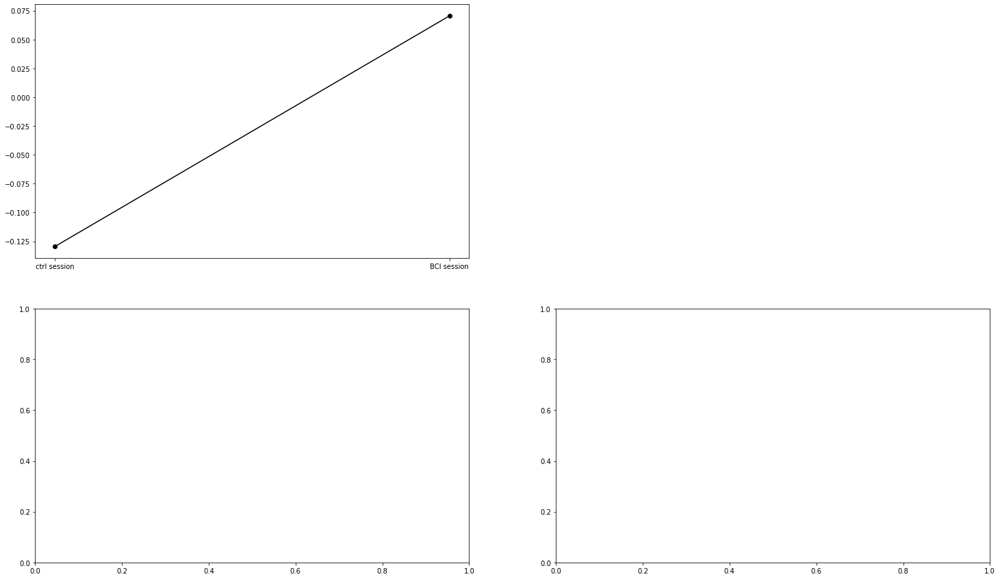

In [20]:
# multiple cell-pair paradigm (cells 1vs2, 3vs4, 5vs6 ....) out = a*b ------ non-correlating cells were selected
to_select = '' # '', '_max', '_min'


closed_loop_prev_list = []
closed_loop_list = []
corr_matrix_pairs = []
corr_matrix_prev_pairs = []
corr_matrix_labels_pairs = []

fig = plt.figure(figsize = [25,15])
ax = fig.add_subplot(2,2,1)
#ax_cb = fig.add_subplot(2,2,2)
ax_corr_prev = fig.add_subplot(2,2,3)
ax_corr = fig.add_subplot(2,2,4)


for cni in np.arange(0,len(cns),2):
    cnii = cni + 1
    #corr_matrix_dict['pearson_closed_loop']
    closed_loop_prev_list.append(corr_matrix_dict['pearson{}_closed_loop_prev'.format(to_select)][cni,cnii])
    closed_loop_list.append(corr_matrix_dict['pearson{}_closed_loop'.format(to_select)][cni,cnii])
    ax.plot(['ctrl session','BCI session'],[corr_matrix_dict['pearson{}_closed_loop_prev'.format(to_select)][cni,cnii],corr_matrix_dict['pearson{}_closed_loop'.format(to_select)][cni,cnii]],'k-o')
    matrix_idx = np.where(np.asarray(corr_matrix_labels) == 'cell {} vs {}'.format(cns[cnii],cns[cni]))[0][0]
    
    corr_matrix_pairs.append(corr_matrix[matrix_idx,:])
    corr_matrix_prev_pairs.append(corr_matrix_prev[matrix_idx,:])
    corr_matrix_labels_pairs.append(corr_matrix_labels[matrix_idx])
im = ax_corr.imshow(np.asarray(corr_matrix_pairs),aspect = 'auto',interpolation='none')
im_prev = ax_corr_prev.imshow(np.asarray(corr_matrix_prev_pairs),aspect = 'auto',interpolation='none')

ax_corr.set_yticks(np.arange(len(corr_matrix_labels_pairs)))
ax_corr.set_yticklabels(corr_matrix_labels_pairs)
ax_corr.set_title('Pearson correlation coefficient in {} frame windows'.format(window_size))
ax_corr.vlines(end_of_spont_idx/window_step,ax_corr.get_ylim()[0],ax_corr.get_ylim()[1],color = 'red')   

ax_corr_prev.set_yticks(np.arange(len(corr_matrix_labels_pairs)))
ax_corr_prev.set_yticklabels(corr_matrix_labels_pairs)
ax_corr_prev.set_title('Pearson correlation coefficient in {} frame windows'.format(window_size))
ax_corr_prev.vlines(end_of_spont_idx_prev/window_step,ax_corr_prev.get_ylim()[0],ax_corr_prev.get_ylim()[1],color = 'red')   

im.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])
im_prev.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])

ax.set_ylabel('Pearson R')

fig.colorbar(im, ax=ax_corr)#,location = 'center')


In [78]:
# calculate the pearson R for all cells and the CNs on both days
session_now = session
cns_now = cns#[0]#[15,6] # a cell-pair that is changing it's correlation
cell_num = data_dict[session_now]['dff_sessionwise'].shape[0]
cc_dict = {previous_session: np.zeros([len(cns_now),cell_num]),
           session: np.zeros([len(cns_now),cell_num])}
for session_i_now, (session_now,end_of_spont_idx_now) in enumerate(zip([previous_session, session],[end_of_spont_idx_prev,end_of_spont_idx])):
    for cn_i,cn in enumerate(cns_now):
        dff = data_dict[session_now]['dff_sessionwise'][cn,:]
        for other_cell in np.arange(cell_num):
            dff_cell = data_dict[session_now]['dff_sessionwise'][other_cell,:]
            try:
                cc_dict[session_now][cn_i,other_cell],  pearsons_p = scipy.stats.pearsonr(dff[end_of_spont_idx_now:], dff_cell[end_of_spont_idx_now:])
            except:
                cc_dict[session_now][cn_i,other_cell] = np.nan



Text(0.5, 1.0, '032223 to 032123')

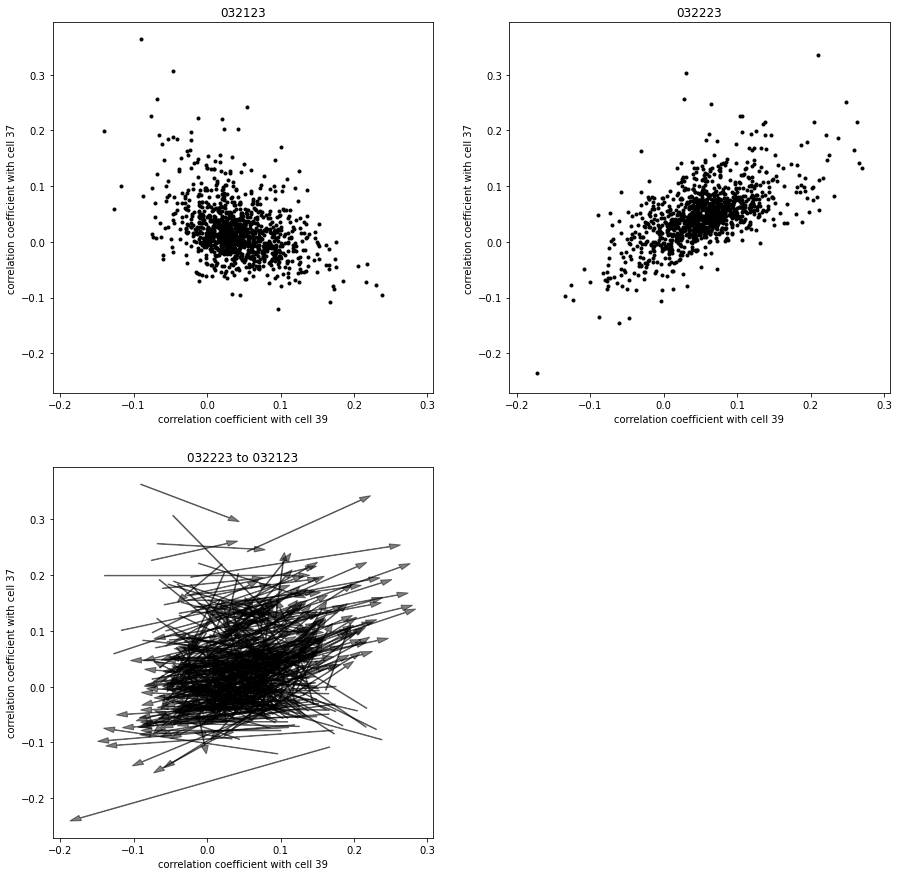

In [77]:
cc_dict[previous_session][cc_dict[previous_session]>.999] = np.nan
cc_dict[session][cc_dict[session]>.999] = np.nan

fig = plt.figure(figsize = [15,15])
ax1 = fig.add_subplot(2,2,2)
ax1.plot(cc_dict[session][0,:],cc_dict[session][1,:],'k.')
ax1.set_xlabel('correlation coefficient with cell {}'.format(cns_now[0]))
ax1.set_ylabel('correlation coefficient with cell {}'.format(cns_now[1]))
ax1.set_title(session)



ax2 = fig.add_subplot(2,2,1,sharex = ax1,sharey = ax1)
ax2.plot(cc_dict[previous_session][0,:],cc_dict[previous_session][1,:],'k.')
ax2.set_xlabel('correlation coefficient with cell {}'.format(cns_now[0]))
ax2.set_ylabel('correlation coefficient with cell {}'.format(cns_now[1]))
ax2.set_title(previous_session)

# ax2.set_xlim([-.2,.4])
# ax2.set_ylim([-.2,.4])

ax3 = fig.add_subplot(2,2,3,sharex = ax1,sharey = ax1)
median_cc = np.nanmedian(cc_dict[session].flatten())
for i in np.arange(cell_num):
    
    #ax3.plot(cc_dict[session][0,i],cc_dict[session][1,i],'k.',alpha = 1)
    if np.max(np.abs(np.asarray([cc_dict[session][0,i],cc_dict[previous_session][0,i],cc_dict[session][1,i],cc_dict[previous_session][1,i]])-median_cc))>.075:
        ax3.arrow(cc_dict[previous_session][0,i], 
                  cc_dict[previous_session][1,i], 
                  cc_dict[session][0,i]-cc_dict[previous_session][0,i],
                  cc_dict[session][1,i]-cc_dict[previous_session][1,i],
                 head_width = .01,
                 color = 'black',
                 alpha = .5)
        #ax3.plot([cc_dict[session][0,i],cc_dict[previous_session][0,i]],[cc_dict[session][1,i],cc_dict[previous_session][1,i]],'r-',alpha = .5)
ax3.set_xlabel('correlation coefficient with cell {}'.format(cns_now[0]))
ax3.set_ylabel('correlation coefficient with cell {}'.format(cns_now[1]))
ax3.set_title('{} to {}'.format(session,previous_session))


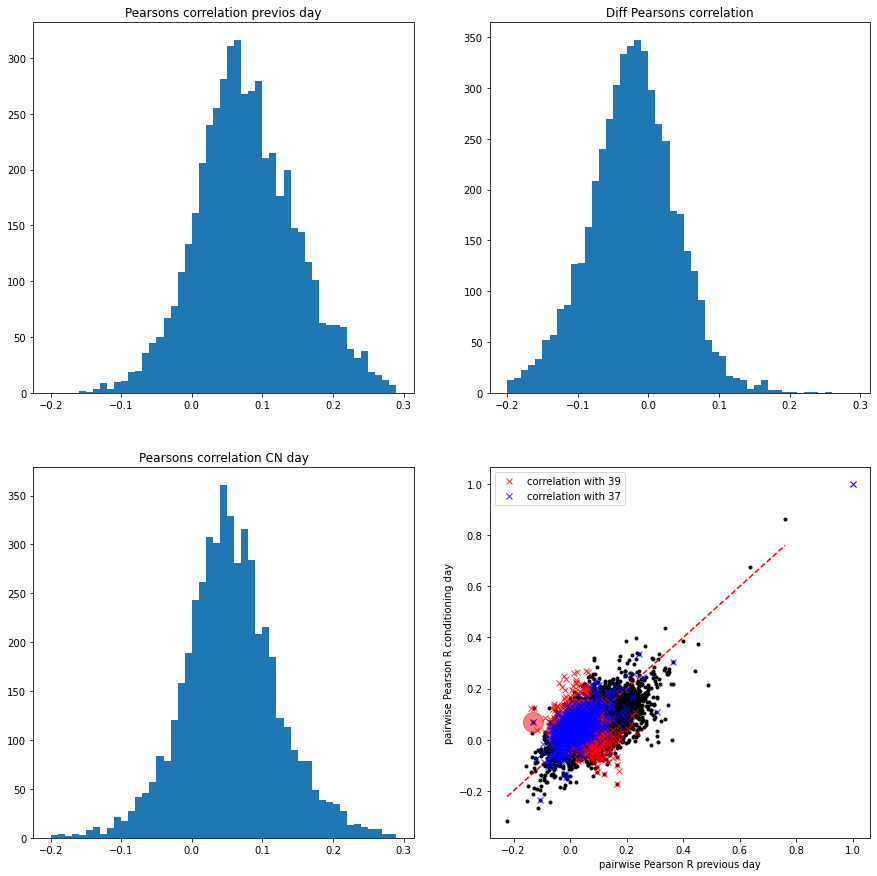

In [79]:


corr_diff = np.asarray(corr_matrix_dict['pearson{}_closed_loop_all_cells'.format(to_select)])-np.asarray(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)])
cn_diff = corr_matrix_dict['pearson{}_closed_loop'.format(to_select)] - corr_matrix_dict['pearson{}_closed_loop_prev'.format(to_select)]
cn_diff = cn_diff[cn_diff != 0]
cn_prev = np.asarray(corr_matrix_dict['pearson{}_closed_loop_prev'.format(to_select)])
cn_prev = cn_prev[cn_prev != 0]
cn_now = np.asarray(corr_matrix_dict['pearson{}_closed_loop'.format(to_select)])
cn_now = cn_now[cn_now != 0]
hist_range = np.arange(-.2,.3,.01)
fig = plt.figure(figsize = [15,15])
ax_hist_prev = fig.add_subplot(2,2,1)
ax_hist_now = fig.add_subplot(2,2,3)
ax_hist_diff = fig.add_subplot(2,2,2)
ax_scatter = fig.add_subplot(2,2,4)
ax_hist_prev.hist(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)],hist_range)
ax_hist_prev.set_title('Pearsons correlation previos day')
ax_hist_now.hist(corr_matrix_dict['pearson{}_closed_loop_all_cells'.format(to_select)],hist_range)
ax_hist_now.set_title('Pearsons correlation CN day')

ax_hist_diff.hist(corr_diff,hist_range)
ax_hist_diff.set_title('Diff Pearsons correlation')
# ax_hist_now.plot(cn_now,np.ones(len(cn_diff))*100,'r.')
# ax_hist_prev.plot(cn_prev,np.ones(len(cn_diff))*100,'r.')
# ax_hist_diff.plot(cn_diff,np.ones(len(cn_diff))*100,'r.')
ax_scatter.plot(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)],corr_matrix_dict['pearson{}_closed_loop_all_cells'.format(to_select)],'k.')

for cni in np.arange(0,len(cns),2):
    cnii = cni + 1
    #corr_matrix_dict['pearson_closed_loop']
    #closed_loop_prev_list.append(corr_matrix_dict['pearson{}_closed_loop_prev'.format(to_select)][cni,cnii])
    #closed_loop_list.append(corr_matrix_dict['pearson{}_closed_loop'.format(to_select)][cni,cnii])
    ax_scatter.plot(corr_matrix_dict['pearson{}_closed_loop_prev'.format(to_select)][cni,cnii],corr_matrix_dict['pearson{}_closed_loop'.format(to_select)][cni,cnii],'ro',markersize = 20,alpha = .5)
ax_scatter.plot([np.min(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)]),np.max(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)])],[np.min(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)]),np.max(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)])],'r--')
ax_scatter.set_xlabel('pairwise Pearson R previous day')
ax_scatter.set_ylabel('pairwise Pearson R conditioning day')

ax_scatter.plot(cc_dict[previous_session][0,:],cc_dict[session][0,:],'rx',label = 'correlation with {}'.format(cns_now[0]),alpha = .8)
ax_scatter.plot(cc_dict[previous_session][1,:],cc_dict[session][1,:],'bx',label = 'correlation with {}'.format(cns_now[1]),alpha = .8)
ax_scatter.legend()

In [870]:
corr_matrix_dict.keys()

dict_keys(['pearson_spont', 'pearson_closed_loop', 'pearson_min_closed_loop', 'pearson_max_closed_loop', 'pearson_spont_prev', 'pearson_closed_loop_prev', 'pearson_min_closed_loop_prev', 'pearson_max_closed_loop_prev', 'pearson_closed_loop_all_cells', 'pearson_min_closed_loop_all_cells', 'pearson_max_closed_loop_all_cells', 'pearson_closed_loop_prev_all_cells', 'pearson_min_closed_loop_prev_all_cells', 'pearson_max_closed_loop_prev_all_cells', 'pearson_all_cells_labels'])

In [875]:
order = np.argsort(np.asarray(corr_matrix_dict['pearson{}_closed_loop_all_cells'.format(to_select)])-np.asarray(corr_matrix_dict['pearson{}_closed_loop_prev_all_cells'.format(to_select)]))
np.asarray(corr_matrix_dict['pearson_all_cells_labels'])[order]

array([[ 36,  29],
       [469,  11],
       [ 18,  29],
       ...,
       [ 29,  63],
       [679, 539],
       [225,  29]])

In [466]:
import matplotlib
font = {'family' : 'normal',
        #'weight' : 'bold',
        'size'   : 18}
matplotlib.rc('font', **font)


123

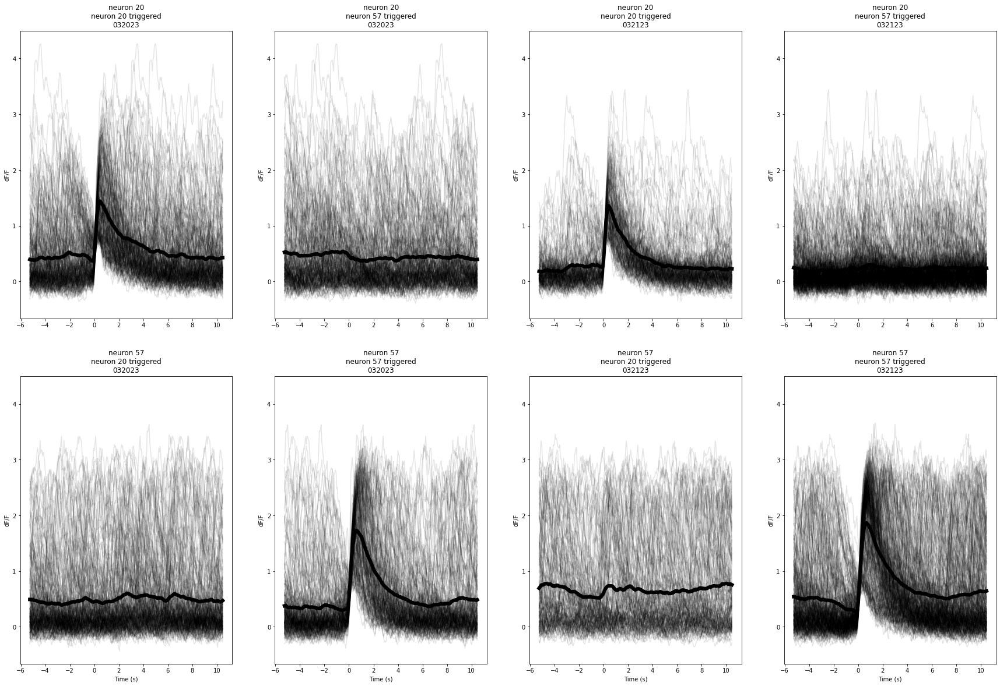

In [35]:
step_back =100
step_forward = 200
time_v = np.arange(-step_back,step_forward)/19
for cni in np.arange(0,len(cns),2):
    fig = plt.figure(figsize = [30,20])
    cnii = cni + 1
    cn = cns[cni]
    cn2 = cns[cnii]
    
    
    for session_i_now, session_now in enumerate([previous_session, session]):
        cn1event_locked_traces_cn1 = []
        cn1event_locked_traces_cn2 = []
        cn2event_locked_traces_cn1 = []
        cn2event_locked_traces_cn2 = []
        event_indices = np.where((np.diff(data_dict[session_now]['events_clean'])>0)[cn,:])[0]
        event_indices_cn2 = np.where((np.diff(data_dict[session_now]['events_clean'])>0)[cn2,:])[0]
        
        # event_indices = event_indices[int(len(event_indices)/2):]
        # event_indices_cn2 = event_indices_cn2[int(len(event_indices_cn2)/2):]
        
        
        dff_cn = BCI_analysis.plot_utils.rollingfun(data_dict[session_now]['dff_sessionwise'][cn,:],4,'mean')
        dff_cn2 = BCI_analysis.plot_utils.rollingfun(data_dict[session_now]['dff_sessionwise'][cn2,:],4,'mean')
        for event_idx in event_indices:
            if event_idx>step_back+1 and event_idx<len(dff_cn)-step_forward-1:
                cn1event_locked_traces_cn1.append(dff_cn[event_idx-step_back:event_idx+step_forward])
                cn1event_locked_traces_cn2.append(dff_cn2[event_idx-step_back:event_idx+step_forward])

        for event_idx in event_indices_cn2:
            if event_idx>step_back+1 and event_idx<len(dff_cn)-step_forward-1:
                cn2event_locked_traces_cn1.append(dff_cn[event_idx-step_back:event_idx+step_forward])
                cn2event_locked_traces_cn2.append(dff_cn2[event_idx-step_back:event_idx+step_forward])
        if session_i_now>0:
            ax_1 = fig.add_subplot(2,4,1 + session_i_now*2,sharey = ax_0)
        else:
            ax_1 = fig.add_subplot(2,4,1 + session_i_now*2)
        ax_1.plot(time_v,np.asarray(cn1event_locked_traces_cn1).T,'k-',alpha = .1)
        ax_1.plot(time_v,np.nanmean(cn1event_locked_traces_cn1,0),'k-',alpha = 1,linewidth = 6)
        
        if session_i_now == 0:
            ax_0 = ax_1
        #ax_2 = fig.add_subplot(2,4,2+ session_i_now*2,sharey = ax_0)
        ax_2 = fig.add_subplot(2,4,5 + session_i_now*2,sharey = ax_0)
        ax_2.plot(time_v,np.asarray(cn1event_locked_traces_cn2).T,'k-',alpha = .1)
        ax_2.plot(time_v,np.nanmean(cn1event_locked_traces_cn2,0),'k-',alpha = 1,linewidth = 6)
        ax_1.set_title('neuron {}\nneuron {} triggered\n{}'.format(cn,cn,session_now))
        # ax_1.set_title('1')
        ax_2.set_title('neuron {}\nneuron {} triggered\n{}'.format(cn2,cn,session_now))
        # ax_2.set_title('2')
        #ax_1.set_xlabel('Time (s)')
        ax_1.set_ylabel('dF/F')
        ax_2.set_xlabel('Time (s)')
        ax_2.set_ylabel('dF/F')
        #ax_1 = fig.add_subplot(2,4,5 + session_i_now*2,sharey = ax_0)
        ax_1 = fig.add_subplot(2,4,2+ session_i_now*2,sharey = ax_0)
        ax_1.plot(time_v,np.asarray(cn2event_locked_traces_cn1).T,'k-',alpha = .1)
        ax_1.plot(time_v,np.nanmean(cn2event_locked_traces_cn1,0),'k-',alpha = 1,linewidth = 6)
        ax_2 = fig.add_subplot(2,4,6 + session_i_now*2,sharey = ax_0)
        ax_2.plot(time_v,np.asarray(cn2event_locked_traces_cn2).T,'k-',alpha = .1)
        ax_2.plot(time_v,np.nanmean(cn2event_locked_traces_cn2,0),'k-',alpha = 1,linewidth = 6)
        ax_1.set_title('neuron {}\nneuron {} triggered\n{}'.format(cn,cn2,session_now))
        ax_2.set_title('neuron {}\nneuron {} triggered\n{}'.format(cn2,cn2,session_now))
        #ax_1.set_xlabel('Time (s)')
        ax_1.set_ylabel('dF/F')
        ax_2.set_xlabel('Time (s)')
        ax_2.set_ylabel('dF/F')
        # ax_1.set_title('3')
        # ax_2.set_title('4')
    #asdsa

In [51]:
##### Matt Bull's dimensionality estimation
from sklearn.decomposition import PCA
import matplotlib.cm as cm

windowsize = 2000
windowstep = 400
PCAcomponents = 300
filt_win  =0
fig = plt.figure(figsize=[10,6])
ax = fig.add_subplot(1,1,1)
sessionstostudy = sessions
cmap = cm.jet(np.linspace(0,1,len(sessionstostudy)))
sessionct=0
traces_calcium =[]
t_ = []
for ii,session_now in enumerate(sessionstostudy):
    end_of_spont_idx = np.sum(np.asarray(data_dict[session_now]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[session_now]['all_si_filenames']) == data_dict[session_now]['closed_loop_filenames'][0])[0][0]])
    df = data_dict[session_now][trace_to_use][needed_cells,end_of_spont_idx:].T
    if filt_win>1:
        df_filt = []
        for f in df.T:
            df_filt.append(BCI_analysis.plot_utils.rollingfun(f,filt_win,'mean'))
        df=np.asarray(df_filt).T
    numwindow = int((df.shape[0]-windowsize)/windowstep)
    dimovertime = np.zeros([numwindow,1])
    if np.min(df[0:windowsize].shape) > PCAcomponents:
        pca = PCA(n_components=PCAcomponents, svd_solver='full')
        for i in range(numwindow):
            pca.fit(df[i*windowstep:i*windowstep+windowsize,:])
            dimovertime[i] = np.sum(pca.explained_variance_)**2/(np.sum(pca.explained_variance_**2))
            
            

        ax.plot(np.arange(numwindow)*windowstep, dimovertime.ravel(),'.-', color=cmap[sessionct,:], lw = 2, label='session = ' + session_now)
        traces_calcium.append(dimovertime.ravel())
    sessionct += 1
    #break

l_ = []
for t in traces_calcium:
    l_.append(len(t))
l_ = np.min(l_)
dim_ca_matrix = np.zeros([len(traces_calcium),l_])
for i,c in enumerate(traces_calcium):
    dim_ca_matrix[i,:] = c[:l_]
ax.plot(np.arange(l_)*windowstep,np.mean(dim_ca_matrix,0),'k.-',linewidth = 4)    

   
    
ax.set_ylabel('Effective Dimensionality (calcium)')
plt.xlabel('Time')
ax.legend(loc='upper right')
plt.show()

dict_keys(['pearson_spont', 'pearson_closed_loop', 'pearson_spont_prev', 'pearson_closed_loop_prev', 'pearson_closed_loop_all_cells', 'pearson_closed_loop_prev_all_cells', 'pearson_all_cells_labels'])

In [23]:
data_dict[session_now]['dff_sessionwise'].shape

(382, 43269)

In [62]:
np.max([cc_dict[session][0,i],cc_dict[previous_session][0,i],cc_dict[session][1,i],cc_dict[previous_session][1,i]])

0.022002006524126146

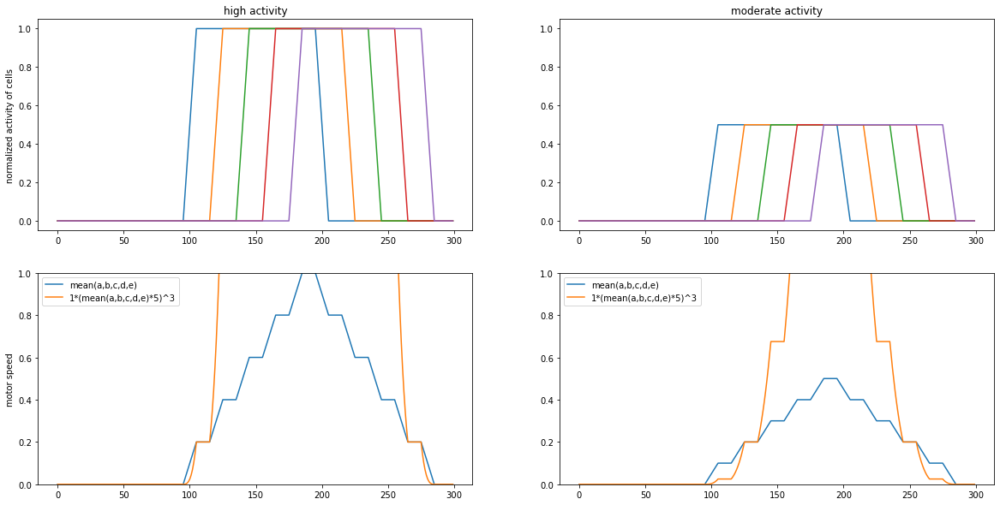

In [402]:
# TRY this recipe - 

base_value = 5
exponent =3
multiplier = 1


base_value = 5
exponent =3
multiplier = 1


activity = 1
activity2 = .5
rollval = 20
a = BCI_analysis.plot_utils.rollingfun(np.concatenate([np.zeros(100),np.ones(100),np.zeros(100)]),10,'mean')*base_value *activity
b = np.roll(a,rollval)
c = np.roll(b,rollval)
d = np.roll(c,rollval)
e = np.roll(d,rollval)

a2 = BCI_analysis.plot_utils.rollingfun(np.concatenate([np.zeros(100),np.ones(100),np.zeros(100)]),10,'mean')*base_value *activity2
b2 = np.roll(a2,rollval)
c2 = np.roll(b2,rollval)
d2 = np.roll(c2,rollval)
e2 = np.roll(d2,rollval)



fig = plt.figure(figsize = [20,10])
ax1 = fig.add_subplot(2,2,1)
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,2,sharey = ax1)
ax4 = fig.add_subplot(2,2,4,sharey = ax2)
ax1.plot(a/base_value,label = a)
ax1.plot(b/base_value)
ax1.plot(c/base_value)
ax1.plot(d/base_value)
ax1.plot(e/base_value)
ax1.set_ylabel('normalized activity of cells')
ax1.set_title('high activity')
ax3.plot(a2/base_value,label = a)
ax3.plot(b2/base_value)
ax3.plot(c2/base_value)
ax3.plot(d2/base_value)
ax3.plot(e2/base_value)
ax3.set_title('moderate activity')

y = np.mean([a,b,c,d,e],0)/base_value
ax2.plot(y,label = 'mean(a,b,c,d,e)')
y2 = np.mean([a2,b2,c2,d2,e2],0)/base_value
ax4.plot(y2,label = 'mean(a,b,c,d,e)')

y = (multiplier*np.mean([a,b,c,d,e],0)**exponent)/base_value
ax2.plot(y,label = '{}*(mean(a,b,c,d,e)*{})^{}'.format(multiplier,base_value,exponent))
ax2.set_ylim([0,1])
ax2.legend()
ax2.set_ylabel('motor speed')

y2 = (multiplier*np.mean([a2,b2,c2,d2,e2],0)**exponent)/base_value
ax4.plot(y2,label = '{}*(mean(a,b,c,d,e)*{})^{}'.format(multiplier,base_value,exponent))
ax4.legend()

Text(0, 0.5, 'Activity of CN2')

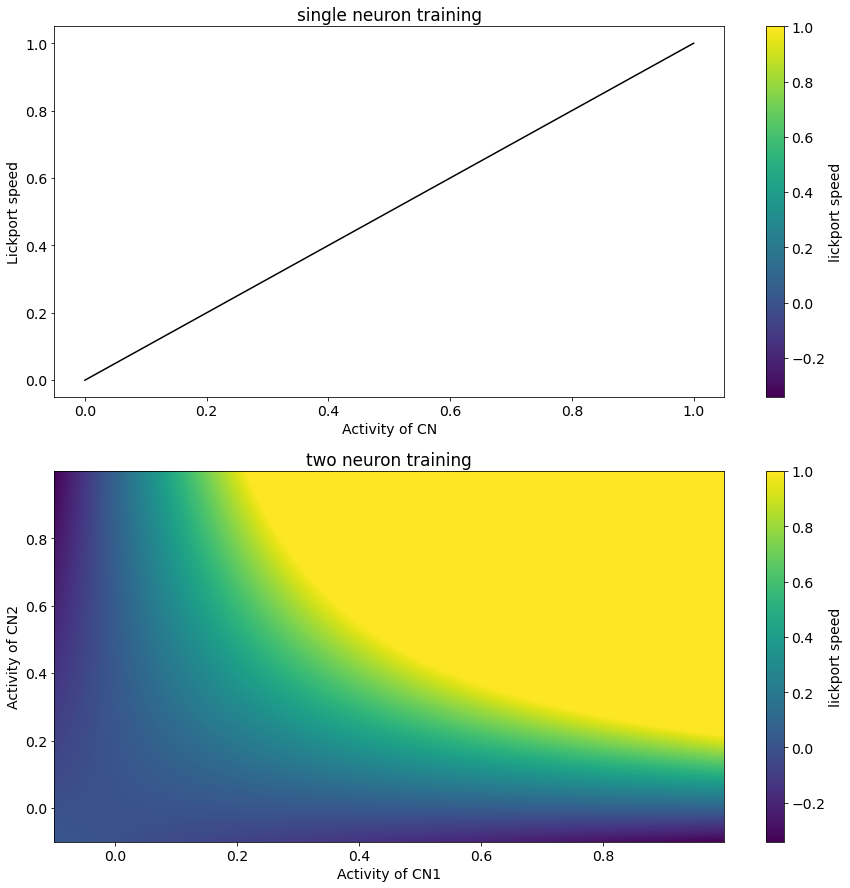

In [479]:
#visualise mapping
multiplier = 10
boost = 5


fig = plt.figure(figsize = [15,15])
ax_singlecell = fig.add_subplot(2,1,1)
ax_singlecell.plot([0,1],[0,1],'k-')
ax_singlecell.set_title('single neuron training')
ax_singlecell.set_xlabel('Activity of CN')
ax_singlecell.set_ylabel('Lickport speed')
ax_multicell = fig.add_subplot(2,1,2)
speed_steps = np.arange(-0.1,1,.001)
speed_matrix = np.zeros([len(speed_steps)]*2)
for i,speed_1 in enumerate(speed_steps):
    for ii,speed_2 in enumerate(speed_steps):
        speed_matrix[i,ii] = output = ((speed_1*speed_2)*multiplier*boost + speed_1+speed_2)/(multiplier+2)
speed_matrix[speed_matrix>1] = 1
im = ax_multicell.imshow(speed_matrix,aspect = 'auto',interpolation = 'none',extent = [speed_steps[0],speed_steps[-1],speed_steps[-1],speed_steps[0]])    
ax_multicell.invert_yaxis()
fig.colorbar(im, ax=ax_multicell,location = 'right',label = 'lickport speed')
fig.colorbar(im, ax=ax_singlecell,location = 'right',label = 'lickport speed')
ax_multicell.set_title('two neuron training')
ax_multicell.set_xlabel('Activity of CN1')
ax_multicell.set_ylabel('Activity of CN2')

Text(0, 0.5, 'Lickport speed')

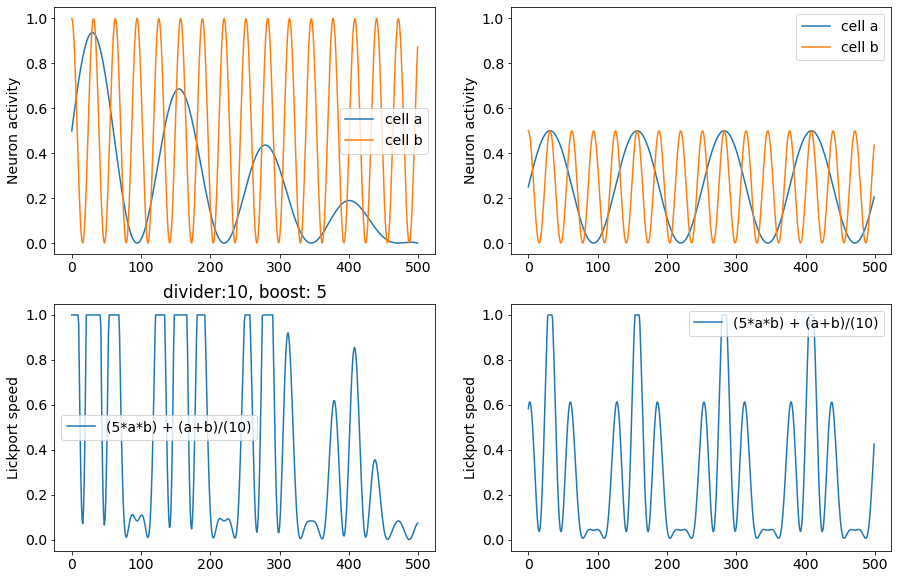

In [773]:
multiplier = 10
boost = 5

fig = plt.figure(figsize = [15,10])
ax1_low = fig.add_subplot(2,2,2)
ax1_high = fig.add_subplot(2,2,1,sharey = ax1_low)
ax2_low = fig.add_subplot(2,2,4)
ax2_high = fig.add_subplot(2,2,3,sharey = ax2_low)
low_amplitude = .5
high_amplitude = 1
x = np.arange(0,50,.1)
a  = (0.5+np.sin(x/2)/2)*low_amplitude
b = (0.5+np.cos(x*2)/2)*low_amplitude
ax1_low.plot(a,label = 'cell a')
ax1_low.plot(b,label = 'cell b')
output = ((a*b)*multiplier*boost + a+b)/(multiplier+2)
output[output>1] = 1
ax2_low.plot(output,label = '({boost}*a*b) + (a+b)/({multiplier})'.format(multiplier = multiplier,boost = boost))
ax2_high.set_title('divider:{}, boost: {}'.format(multiplier,boost))
ax1_low.legend()
ax2_low.legend()


a  = (0.5+np.sin(x/2)/2)*high_amplitude*np.arange(len(x))[::-1]/len(x)
b = (0.5+np.cos(x*2)/2)*high_amplitude
ax1_high.plot(a,label = 'cell a')
ax1_high.plot(b,label = 'cell b')
output = ((a*b)*multiplier*boost + a+b)/(multiplier+2)
output[output>1] = 1
ax2_high.plot(output,label = '({boost}*a*b) + (a+b)/({multiplier})'.format(multiplier = multiplier,boost = boost))
ax2_high.set_title('divider:{}, boost: {}'.format(multiplier,boost))
ax1_high.legend()
ax2_high.legend()
#ax2_high.set_ylim([0,1])

ax1_low.set_ylabel('Neuron activity')
ax1_high.set_ylabel('Neuron activity')

ax2_low.set_ylabel('Lickport speed')
ax2_high.set_ylabel('Lickport speed')

/tmp/ipykernel_22683/3613764922.py:260: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig_mean_image = plt.figure(figsize = [15,15])


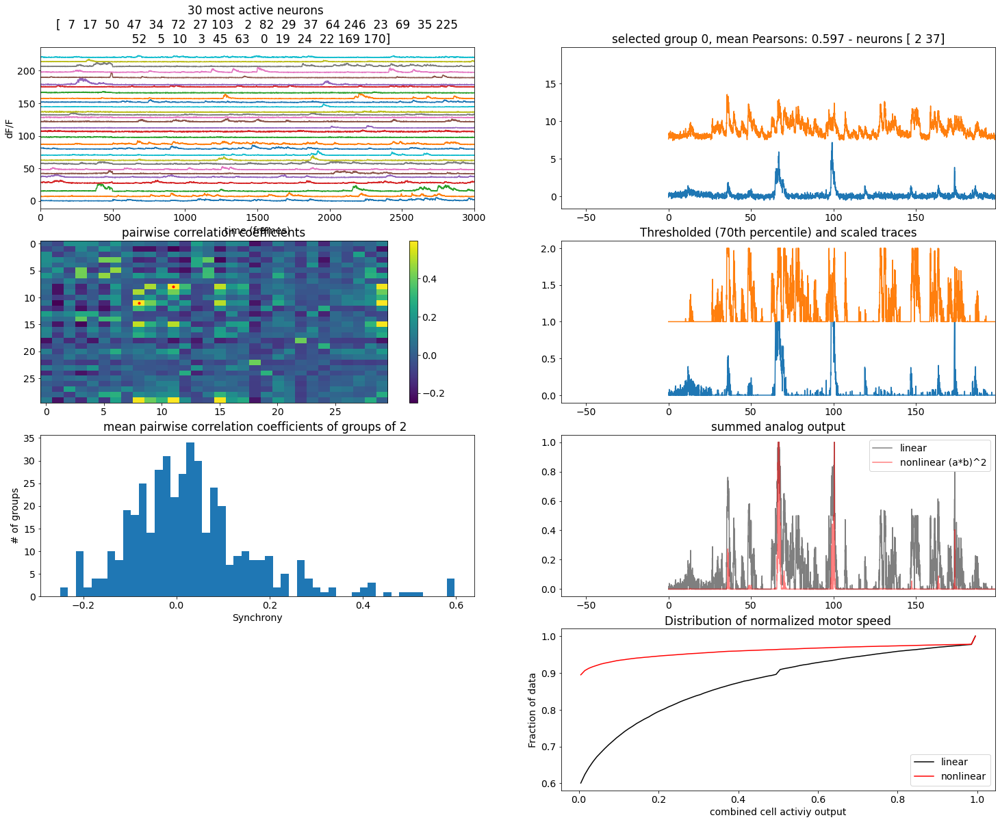

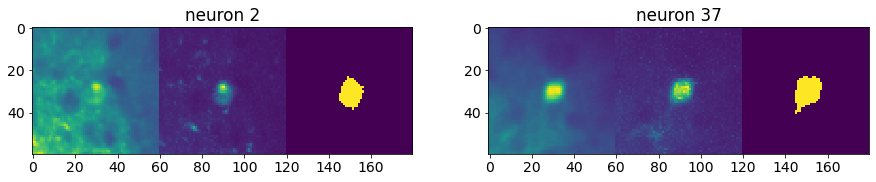

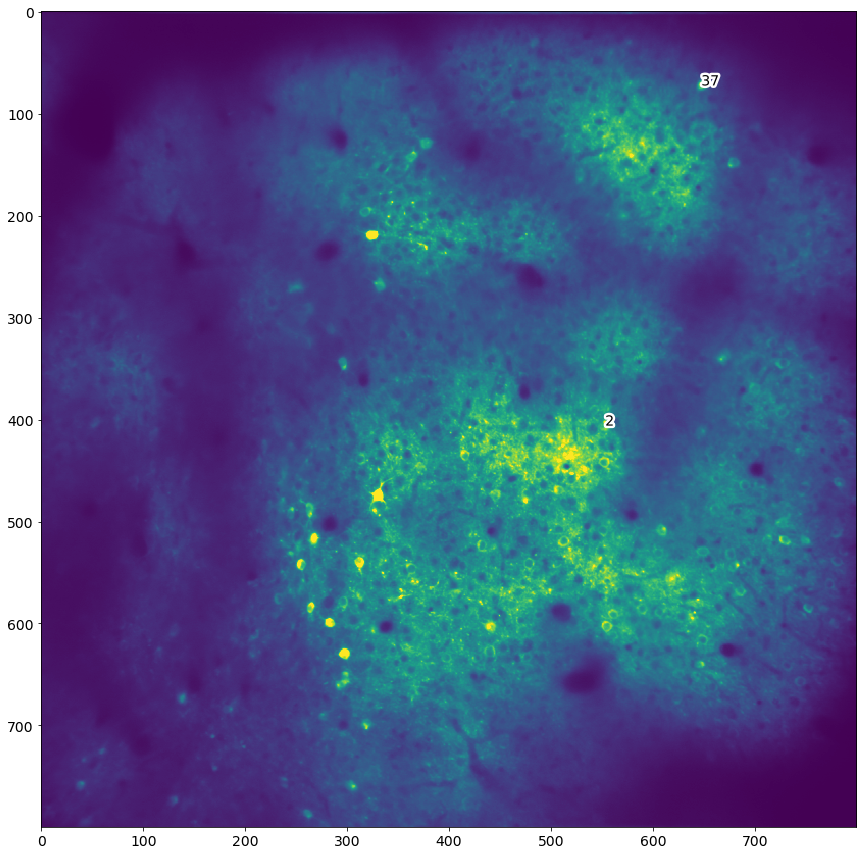

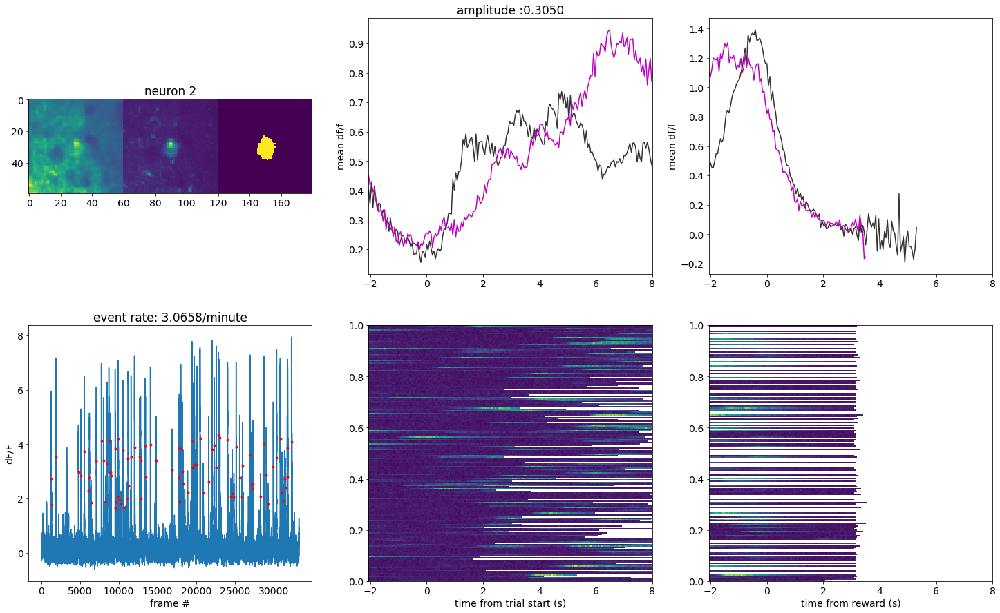

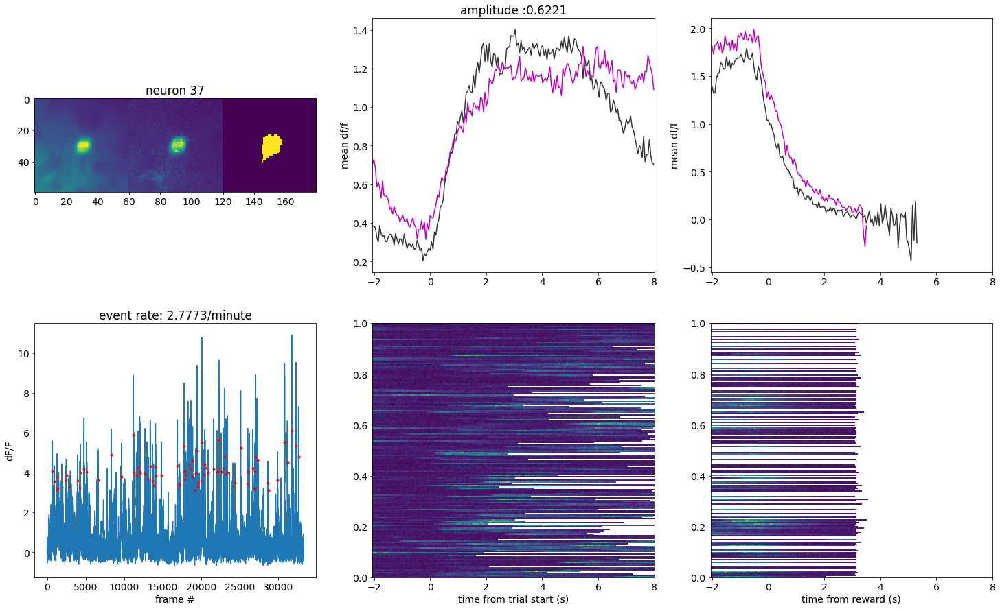

...

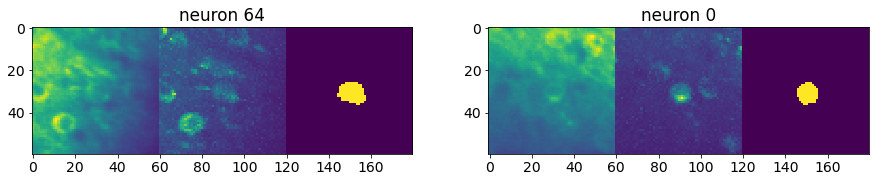

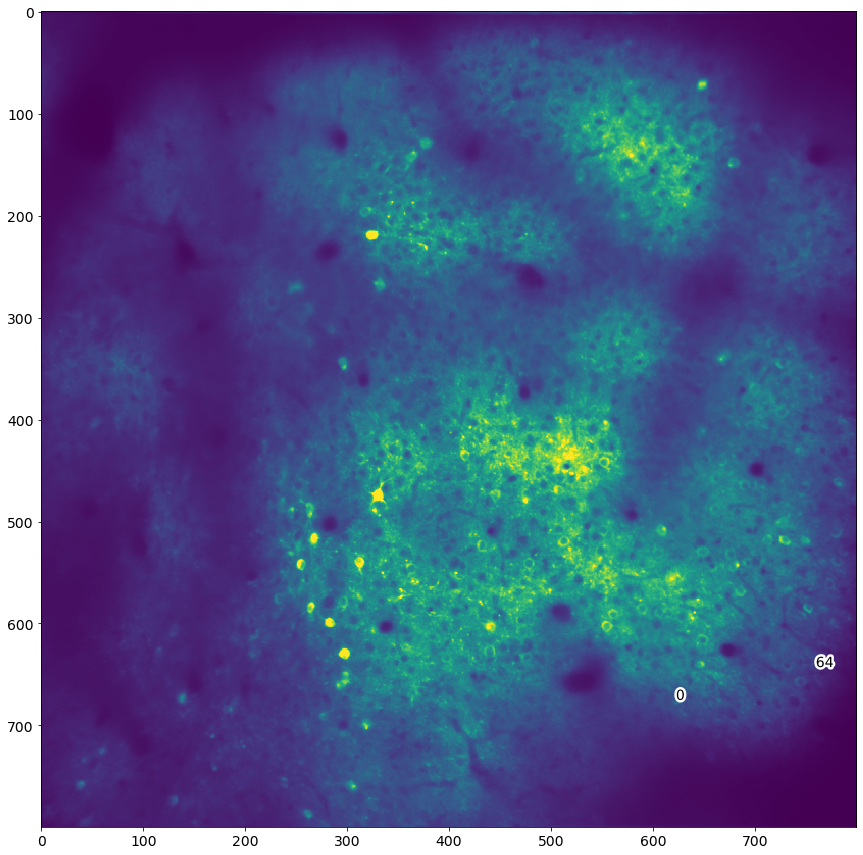

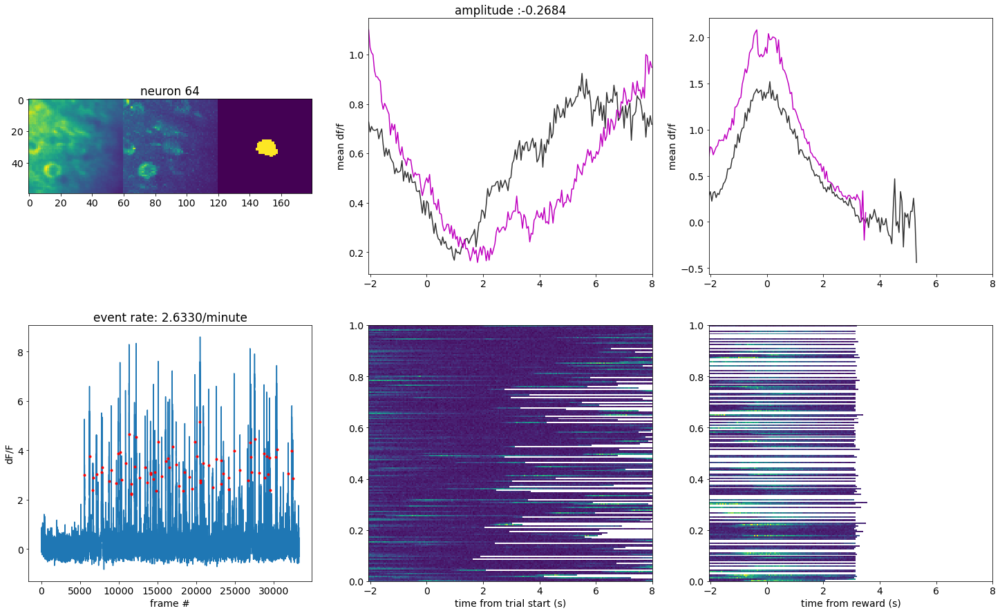

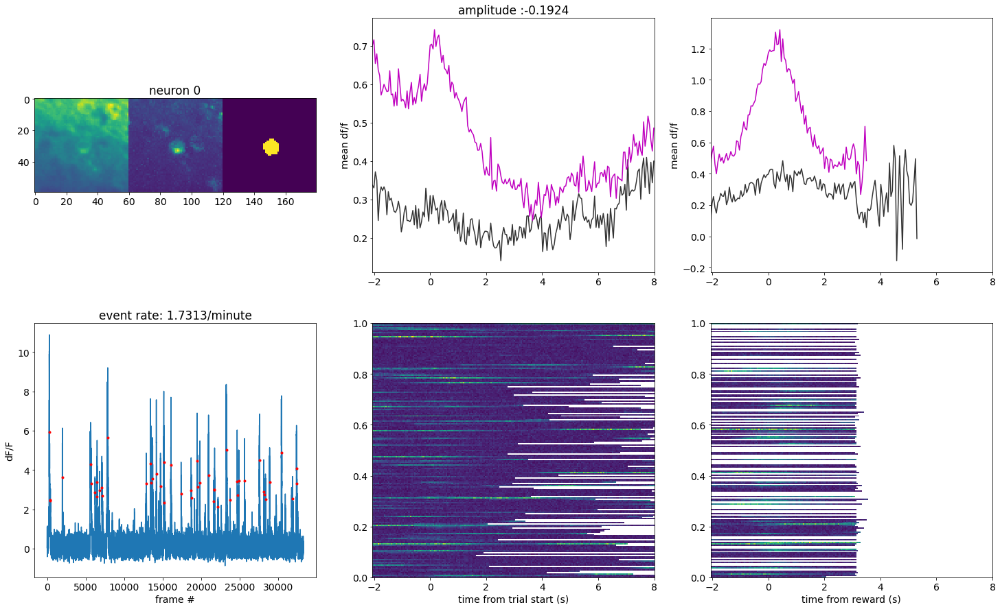

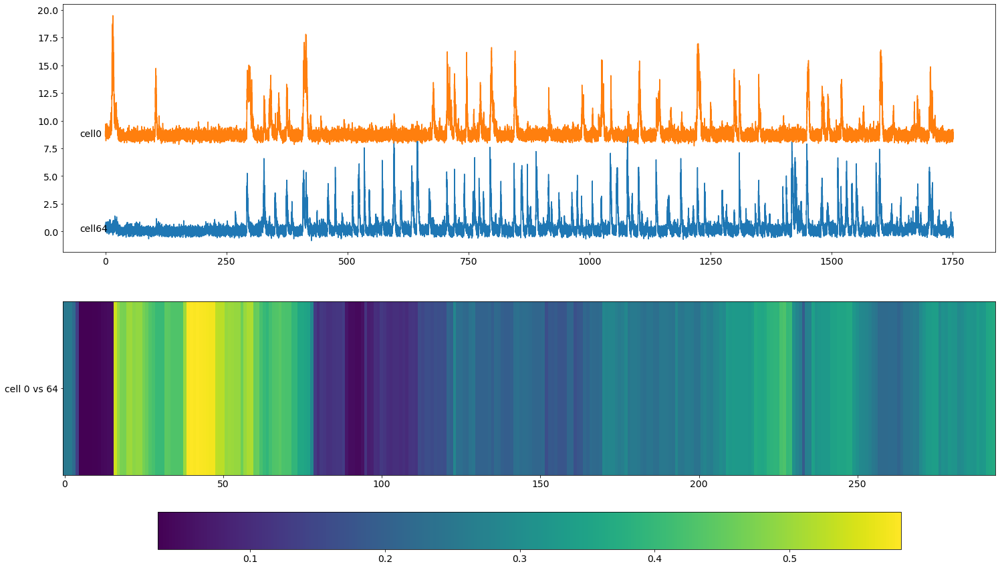

In [53]:
# suggest cell groups
plt.close('all') 
import scipy
import itertools
import matplotlib.patheffects as PathEffects
save_pdf_copy_files = False

neuron_blacklist = []#[1,0,8]

cells_to_consider = 30 #number of top activity cells
cells_to_select = 2 #number of cells in the conditioning group
groups_to_select = 10 #number of groups to select with different correlations
max_cell_repeat = 2 # in how many groups can a single cell participate
min_percentile = 70
use_maximum_correlation_in_window = False #parameters below
window_size =4000
window_step = 100
exponent = 2
base_value = 1
binarize_activity = False # stupid idea??

minimum_pixel_num = 80

potential_cn_list = []

roi_pixel_range = 30 # display purposes
event_rate_copy = data_dict[session]['event_rate'].copy()
event_rate_copy[np.asarray(pixel_num_list)<minimum_pixel_num] = 0
for n in neuron_blacklist:
    event_rate_copy[n] = 0
cns = np.argsort(event_rate_copy)[::-1][:cells_to_consider]

DFFs = data_dict[session]['dff_sessionwise'][cns,:]

use_synchrony = False

pick_multiple_similarly_correlating_groups = True # otherwise picks groups with a variety of correlations - low to high
pick_multiple_high_correlating_groups = True # otherwise will pick groups with low corr


corr_matrix = np.zeros([len(cns),len(cns)])
synchrony_matrix = np.zeros([len(cns),len(cns)])

if save_pdf_copy_files:
    Path(next_session_dir).mkdir(parents = True, exist_ok = True)
    pdf_obj = PdfPages(os.path.join(next_session_dir,'neuron_group_suggestions.pdf'))


for cni, cn in enumerate(cns):
    dff = data_dict[session]['dff_sessionwise'][cn,:]
    for cnii, cn2 in enumerate(cns):
        dff2 = data_dict[session]['dff_sessionwise'][cn2,:]
        if cn != cn2:
            #
            dff_rescaled = dff.copy()
            dff_rescaled = dff_rescaled-np.percentile(dff_rescaled,min_percentile)
            dff_rescaled = dff_rescaled/np.percentile(dff_rescaled,95)#*100
            dff_rescaled[dff_rescaled<0] = 0 
            dff_rescaled[dff_rescaled>1] = 1
            dff_rescaled2 = dff2.copy()
            dff_rescaled2 = dff_rescaled2-np.percentile(dff_rescaled2,min_percentile)
            dff_rescaled2 = dff_rescaled2/np.percentile(dff_rescaled2,95)#*100
            dff_rescaled2[dff_rescaled2<0] = 0 
            dff_rescaled2[dff_rescaled2>1] = 1 
            
            if binarize_activity:
                dff_rescaled[dff_rescaled>0] = 1
                dff_rescaled2[dff_rescaled2>0] = 1
            if use_maximum_correlation_in_window:
                corr_list = []
                for wstart in np.arange(0,len(dff)-window_size+window_step,window_step):
                    wend = wstart + window_size
                    pearsons_R, pearsons_p = scipy.stats.pearsonr(dff[wstart:wend], dff2[wstart:wend])
                    corr_list.append(pearsons_R)
                pearsons_R = np.max(corr_list)
            else:
                pearsons_R, pearsons_p = scipy.stats.pearsonr(dff, dff2)
            #pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_rescaled, dff_rescaled2)
            
            synchrony = np.mean((dff_rescaled*dff_rescaled2)**exponent)
            # if use_synchrony:
            #     corr_matrix[cni,cnii] = synchrony#pearsons_R
            # else:
            corr_matrix[cni,cnii] = pearsons_R
            synchrony_matrix[cni,cnii] = synchrony

all_combos = itertools.combinations(np.arange(cells_to_consider),cells_to_select)

combos = []
sum_ccs = []
sum_synchs = []
for neurons_test in all_combos:
    ccs = []
    synchs = []
    for ni,n1 in enumerate(neurons_test):
        for n2 in neurons_test[:ni]:
            ccs.append(corr_matrix[n1,n2])
            synchs.append(synchrony_matrix[n1,n2])
    sum_cc = np.mean(ccs)
    sum_synchrony = np.mean(synchs)
    combos.append(neurons_test)
    sum_ccs.append(sum_cc)
    sum_synchs.append(sum_synchrony)

if use_synchrony:
    
    
    order_to_use = np.argsort(np.mean([scipy.stats.zscore(sum_ccs),scipy.stats.zscore(sum_synchs)],0))
else:
    order_to_use = np.argsort(sum_ccs)
if pick_multiple_high_correlating_groups:
    order_to_use   = order_to_use[::-1]
voltage_outputs = []
cells_included_so_far = []
offset_cell_group = 0
for group_i in range(groups_to_select):
    if pick_multiple_similarly_correlating_groups:
        throw_out_group = True
        while throw_out_group:
            group_idx = group_i+offset_cell_group#int(group_i*(len(sum_ccs)-1)/np.max([(groups_to_select-1),1]))
            best_idx = order_to_use[group_idx]
            throw_out_group = False
            for cell_now in  combos[best_idx]:
                if len(cells_included_so_far)>0:
                    if max_cell_repeat<= np.sum(np.concatenate(cells_included_so_far)==cell_now):
                        offset_cell_group+=1
                        throw_out_group = True
                        #print(offset_cell_group)
                        break
    else:
        offset_cell_group = 0
        throw_out_group = True
        while throw_out_group:
            group_idx = int(group_i*(len(sum_ccs)-1)/np.max([(groups_to_select-1),1]))+offset_cell_group
            best_idx = order_to_use[group_idx]
            if group_idx == len(order_to_use)-1:
                throw_out_group = False
                break
            throw_out_group = False
            for cell_now in  combos[best_idx]:
                if len(cells_included_so_far)>0:
                    if max_cell_repeat<= np.sum(np.concatenate(cells_included_so_far)==cell_now):
                        offset_cell_group+=1
                        throw_out_group = True
                        #print(offset_cell_group)
                        break
        
        
        
        
    best_idx = order_to_use[group_idx]
    cells_included_so_far.append(combos[best_idx])
    
    
    fig = plt.figure(figsize = [25,20])
    ax1 = fig.add_subplot(4,2,1)
    ax2 = fig.add_subplot(4,2,3)
    ax3 = fig.add_subplot(4,2,5)
    ax4 = fig.add_subplot(4,2,2)
    ax5 = fig.add_subplot(4,2,6,sharex = ax4)
    ax6 = fig.add_subplot(4,2,4,sharex = ax4)
    ax7 = fig.add_subplot(4,2,8)
    offset =  0
    for cni, cn in enumerate(cns):
        dff = data_dict[session]['dff_sessionwise'][cn,:]
        ax1.plot(dff+offset)
        offset += np.max(dff)
    
    ax1.set_xlim([0,3000])
    ax1.set_title('{} most active neurons \n{}'.format(cells_to_consider,cns))
    ax1.set_ylabel('dF/F')
    ax1.set_xlabel('time (frames)')
    im = ax2.imshow(corr_matrix,aspect = 'auto',interpolation='none')
    if use_synchrony:
        ax2.set_title('pairwise synchrony coefficients')
    else:
        ax2.set_title('pairwise correlation coefficients')
        

    fig.colorbar(im, ax=ax2)

    
    
    for neuron_idx in combos[best_idx]:
        for neuron_idx2 in combos[best_idx]:
            if neuron_idx != neuron_idx2:
                ax2.plot(neuron_idx,neuron_idx2,'r.')
    ax3.hist(sum_ccs,50)
    if use_synchrony:
        ax3.set_title('mean pairwise synchrony of groups of {} '.format(cells_to_select))
    else:
        ax3.set_title('mean pairwise correlation coefficients of groups of {} '.format(cells_to_select))
    ax3.set_ylabel('# of groups')
    if use_synchrony:
        ax3.set_xlabel('Pearson''s R')
    else:
        ax3.set_xlabel('Synchrony')
    offset = 0
    traces = []
    offset_rescaled = 0
    rescaled_traces = []
    for neuron_idx in combos[best_idx]:
        dff = data_dict[session]['dff_sessionwise'][cns[neuron_idx],:]
        dff_rescaled = dff.copy()
        dff_rescaled = dff_rescaled-np.percentile(dff_rescaled,min_percentile)
        dff_rescaled = dff_rescaled/np.percentile(dff_rescaled,95)#*100
        dff_rescaled[dff_rescaled<0] = 0 
        dff_rescaled[dff_rescaled>1] = 1 
        rescaled_traces.append(dff_rescaled)
        if binarize_activity:
            dff_rescaled[dff_rescaled>0] = 1
        
        ax4.plot(np.arange(len(dff))/19,dff+offset)
        ax6.plot(np.arange(len(dff))/19,dff_rescaled+offset_rescaled)
        traces.append(dff_rescaled)
        offset += np.max(dff)
        offset_rescaled += np.max(dff_rescaled)
        
        potential_cn_list.append(cns[neuron_idx])
        #print(cn)
    voltage_outputs.append(np.prod(rescaled_traces,0))
    ax6.set_title('Thresholded ({}th percentile) and scaled traces'.format(min_percentile))
    if use_synchrony:
        ax4.set_title('selected group {}, mean synchrony {:.3e} - neurons {}'.format(group_idx,np.asarray(sum_ccs)[best_idx],cns[np.asarray(combos[best_idx])]))
    else:
        ax4.set_title('selected group {}, mean Pearson''s: {} - neurons {}'.format(group_idx,np.round(np.asarray(sum_ccs)[best_idx],3),cns[np.asarray(combos[best_idx])]))

    #ax5.plot(np.prod(np.asarray(traces),0))
    #ax5.set_ylim([0,.001])
    linear_sum = np.mean(np.asarray(traces),0)
    #nonlinear_sum = ((np.mean(np.asarray(traces),0)*base_value)**exponent)
    nonlinear_sum = (np.prod(np.asarray(traces),0))**exponent
    nonlinear_sum[nonlinear_sum>1] = 1
    xpos = np.argmax(linear_sum)
    linear_sum = linear_sum/np.max(linear_sum)
    linear_sum[linear_sum>1]  = 1

    # nonlinear_sum = nonlinear_sum/np.percentile(nonlinear_sum,99)
    # nonlinear_sum[nonlinear_sum>1]  = 1
    ax5.plot(np.arange(len(dff))/19,linear_sum,'k-',label = 'linear',alpha = .5)
    ax5.plot(np.arange(len(dff))/19,nonlinear_sum,'r-',label = 'nonlinear (a*b)^{}'.format(exponent),alpha = .5)
    ax4.set_xlim((np.asarray([-2500,2500])+xpos)/19)
    ax5.legend()
    ax5.set_title('summed analog output')
    y,x = np.histogram(linear_sum,100)
    x = np.nanmean([x[:-1],x[1:]],0)
    ax7.plot(x,np.cumsum(y)/sum(y),'k-',label = 'linear')
    y,x = np.histogram(nonlinear_sum,100)
    x = np.nanmean([x[:-1],x[1:]],0)
    ax7.plot(x,np.cumsum(y)/sum(y),'r-',label = 'nonlinear')
    ax7.legend()
    ax7.set_ylabel('Fraction of data')
    ax7.set_xlabel('combined cell activiy output')
    ax7.set_title('Distribution of normalized motor speed')
    #ax5.set_ylim([0,1])

    
        
    fig_neuron_shapes = plt.figure(figsize = [15,10])
    fig_mean_image = plt.figure(figsize = [15,15])
    ax_mean_image_ = fig_mean_image.add_subplot(1,1,1)
    im_mean = ax_mean_image_.imshow(data_dict[session]['mean_image'],interpolation = 'none')
    im_mean.set_clim(np.percentile(data_dict[session]['mean_image'].flatten(),[0,99.9]))
    
    for neuron_i,neuron_idx in enumerate(combos[best_idx]):
        idx = cns[neuron_idx]
        ax_mean_image = fig_neuron_shapes.add_subplot(3,2,neuron_i+1)
        y= int(data_dict[session]['roiY'][idx])
        x= int(data_dict[session]['roiX'][idx])
        s = data_dict[session]['mean_image'].shape
        mean_image_cutout = data_dict[session]['mean_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                      np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
        mean_image_cutout = mean_image_cutout/np.max(mean_image_cutout)
        
        max_image_cutout = data_dict[session]['max_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                      np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
        max_image_cutout = max_image_cutout/np.max(max_image_cutout)
        
        ROI_image = np.zeros_like(data_dict[session]['mean_image'])
        roi_stat = stat[idx]
        ROI_image[roi_stat['ypix'],roi_stat['xpix']] = 1    
        
        roi_image_cutout = ROI_image[np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                     np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
        
        ax_mean_image.imshow(np.concatenate([mean_image_cutout,max_image_cutout,roi_image_cutout],1),interpolation = 'none')
        ax_mean_image.set_title('neuron {}'.format(idx))
        
        ax_mean_image_.plot(data_dict[session]['roiX'][idx],data_dict[session]['roiY'][idx],'r-')
        txt = ax_mean_image_.text(data_dict[session]['roiX'][idx],data_dict[session]['roiY'][idx], str(idx),color = 'black')
        txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='w')])
        
        
        fig_trial_locked_activity = plt.figure(figsize = [25,15])
        ax_mean_image__ = fig_trial_locked_activity.add_subplot(2,3,1)
        ax_mean_image__.imshow(np.concatenate([mean_image_cutout,max_image_cutout,roi_image_cutout],1),interpolation = 'none')
        ax_mean_image__.set_title('neuron {}'.format(idx))
        
        
        
        ax_trial_average = fig_trial_locked_activity.add_subplot(2,3,2)
        ax_whole_session = fig_trial_locked_activity.add_subplot(2,3,4)
        ax_trial_locked_activity = fig_trial_locked_activity.add_subplot(2,3,5,sharex = ax_trial_average)

        ax_reward_average = fig_trial_locked_activity.add_subplot(2,3,3,sharex = ax_trial_average)
        ax_reward_locked_activity = fig_trial_locked_activity.add_subplot(2,3,6,sharex = ax_trial_average)

        y= int(data_dict[last_session]['roiY'][idx])
        x= int(data_dict[last_session]['roiX'][idx])

        needed_frames_prev= data_dict[previous_session]['time_since_trial_start']<time_to_average_after_trial_start
        ax_trial_average.plot(data_dict[previous_session]['time_since_trial_start'][needed_frames_prev],data_dict[previous_session]['mean_activity_matrix'][idx,needed_frames_prev],'k-',alpha =.8)
        needed_frames= data_dict[last_session]['time_since_trial_start']<time_to_average_after_trial_start
        ax_trial_average.plot(data_dict[last_session]['time_since_trial_start'][needed_frames],mean_activity_matrix[idx,needed_frames],'m-')

        ax_trial_locked_activity.set_xlabel('time from trial start (s)')
        ax_trial_average.set_ylabel('mean df/f')
        ax_trial_average.set_title('amplitude :{0:.4f}'.format( data_dict[last_session]['trial_averaged_amplitude'][idx]))
        ax_trial_average.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
        ax_trial_locked_activity.imshow(trialwise_dff_until_reward[:,idx,:].squeeze().T,aspect = 'auto',extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],0,1],interpolation = 'none')

        ax_reward_average.plot(data_dict[previous_session]['time_since_trial_start'][needed_frames_prev],data_dict[previous_session]['mean_reward_matrix'][idx,needed_frames_prev],'k-',alpha =.8)
        ax_reward_average.plot(data_dict[last_session]['time_since_trial_start'][needed_frames],mean_reward_matrix[idx,needed_frames],'m-')
        ax_reward_locked_activity.set_xlabel('time from reward (s)')
        ax_reward_average.set_ylabel('mean df/f')
        ax_reward_locked_activity.imshow(trialwise_reward_matrix[:,idx,:].squeeze().T,aspect = 'auto',extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],0,1],interpolation = 'none')
        ax_trial_average.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
        ax_whole_session.plot(data_dict[last_session]['dff_sessionwise'][idx,:])
        #%
        for start_,end_ in  zip(np.where(np.diff(np.concatenate([[0],data_dict[last_session]['events_clean'][idx,:],[0]]))>0)[0],
                                np.where(np.diff(np.concatenate([[0],data_dict[last_session]['events_clean'][idx,:],[0]]))<0)[0]):
            center_idx = int(np.mean([start_,end_]))
            ax_whole_session.plot(center_idx,data_dict[last_session]['events_clean'][idx,center_idx],'r.')

    # =============================================================================
    #     ax_whole_session.plot(np.where(data_dict[last_session]['events_clean'][idx,:]>0)[0],data_dict[last_session]['dff_sessionwise'][idx,data_dict[last_session]['events_clean'][idx,:]>0],'r.')
    # =============================================================================
        ax_whole_session.set_xlabel('frame #')
        ax_whole_session.set_ylabel('dF/F')
        ax_whole_session.set_title('event rate: {0:.4f}/minute'.format(data_dict[last_session]['event_rate'][idx]))
        if save_pdf_copy_files:
            pdf_obj.savefig(fig_trial_locked_activity) 
        
        
 
        
        
    session_i = 0

    fig_corr = plt.figure(figsize = [25,15])
    ax1 = fig_corr.add_subplot(2,1,1)
    offset =  0
    corr_matrix_trace = []
    corr_matrix_labels = []

    for cni,cn in enumerate(cns[np.asarray(combos[best_idx])]):
        dff = data_dict[session]['dff_sessionwise'][cn,:]
        ax1.plot(np.arange(len(dff))/19,dff+offset)
        ax1.text(-1000/19,offset,'cell{}'.format(cn))
        offset += np.max(dff)
    
        for cnii,cn2 in enumerate(cns[np.asarray(combos[best_idx])][:cni]):
            dff2 = data_dict[session]['dff_sessionwise'][cn2,:]
            corr_list = []
            for wstart in np.arange(0,len(dff)-window_size+window_step,window_step):
                wend = wstart + window_size
                pearsons_R, pearsons_p = scipy.stats.pearsonr(dff[wstart:wend], dff2[wstart:wend])
                corr_list.append(pearsons_R)
            corr_matrix_trace.append(np.asarray(corr_list))
            corr_matrix_labels.append('cell {} vs {}'.format(cn,cn2))



    corr_matrix_trace = np.asarray(corr_matrix_trace)
    #corr_matrix_norm = corr_matrix_trace-np.nanmean(corr_matrix_trace[:,:3],1)[:,np.newaxis]


    ax2 = fig_corr.add_subplot(2,1,2)
    im = ax2.imshow(corr_matrix_trace,aspect = 'auto',interpolation='none')
    fig_corr.colorbar(im, ax=ax2,location = 'bottom')
    ax2.set_yticks(np.arange(len(corr_matrix_labels)))
    ax2.set_yticklabels(corr_matrix_labels)
    #plt.plot(DFFs.T,alpha = .5)

    #ax1.set_xlim([0,5000])
    if save_pdf_copy_files:
        
        pdf_obj.savefig(fig)
        pdf_obj.savefig(fig_mean_image)
        pdf_obj.savefig(fig_neuron_shapes)
        pdf_obj.savefig(fig_corr)
    
    
    #asdasd
if save_pdf_copy_files:   
    file_list_to_copy_over = ['Z-positions.pdf',
                              'session_meanimages.tiff',
                              'ROI_sizes.pdf',
                              'ROIs.pdf',
                              'stat.mat',
                              'XYZ_motion.pdf',
                              'session_refImages.tiff',
                              'ops.mat']
    
    pdf_obj.close()
    
    #% save selected roi indices
    
    mdict = mdict={'potential_cn_list': potential_cn_list,
                   'meanImg': data_dict[session]['mean_image']}
    savemat(file_name=os.path.join(s2p_base_dir,subject, fov,'ops.mat'),
            mdict = mdict)
    # copy files over
    for file in file_list_to_copy_over:
        shutil.copyfile(os.path.join(s2p_base_dir,subject,fov,file),os.path.join(next_session_dir,file))

plot

51

In [30]:
behavior_dict.keys()
behavior_fname = os.path.join(bpod_path,subject, f"{session}-bpod_zaber.npy")
behavior_dict= np.load(behavior_fname,allow_pickle = True).tolist()
'anticorrelate' in behavior_dict['scanimage_roi_outputChannelsFunctions'][int(len(behavior_dict['go_cue_times'])/2)][0]

True

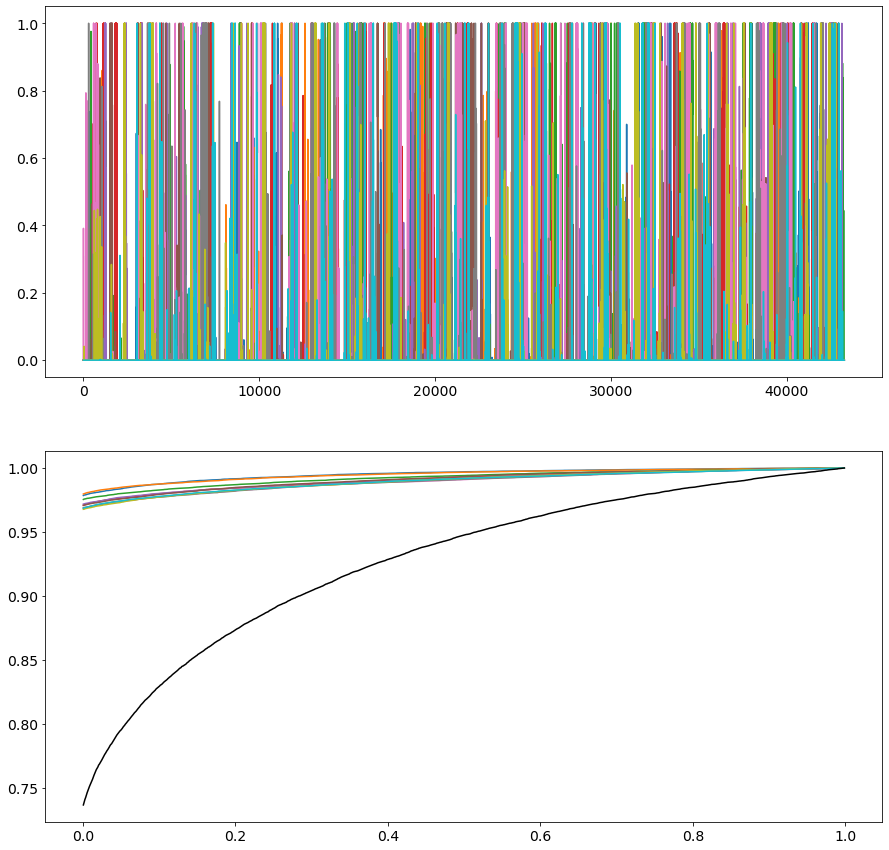

In [121]:
fig = plt.figure(figsize = [15,15])
ax_traces = fig.add_subplot(2,1,1)
ax_hists = fig.add_subplot(2,1,2)
x = np.arange(0,1,.001)
for v in voltage_outputs:
    v = v.copy()*2
    v[v>1] = 1
    ax_traces.plot(v)
    y,x_ = np.histogram(v,x)
    x_ = np.nanmean([x[:-1],x[1:]],0)
    ax_hists.plot(x_,np.cumsum(y)/np.sum(y))
#plt.plot(,'black',linewidth = 1)
y,x_ = np.histogram(np.max(np.asarray(voltage_outputs),0),x)
x_ = np.nanmean([x[:-1],x[1:]],0)
ax_hists.plot(x_,np.cumsum(y)/np.sum(y),'black')

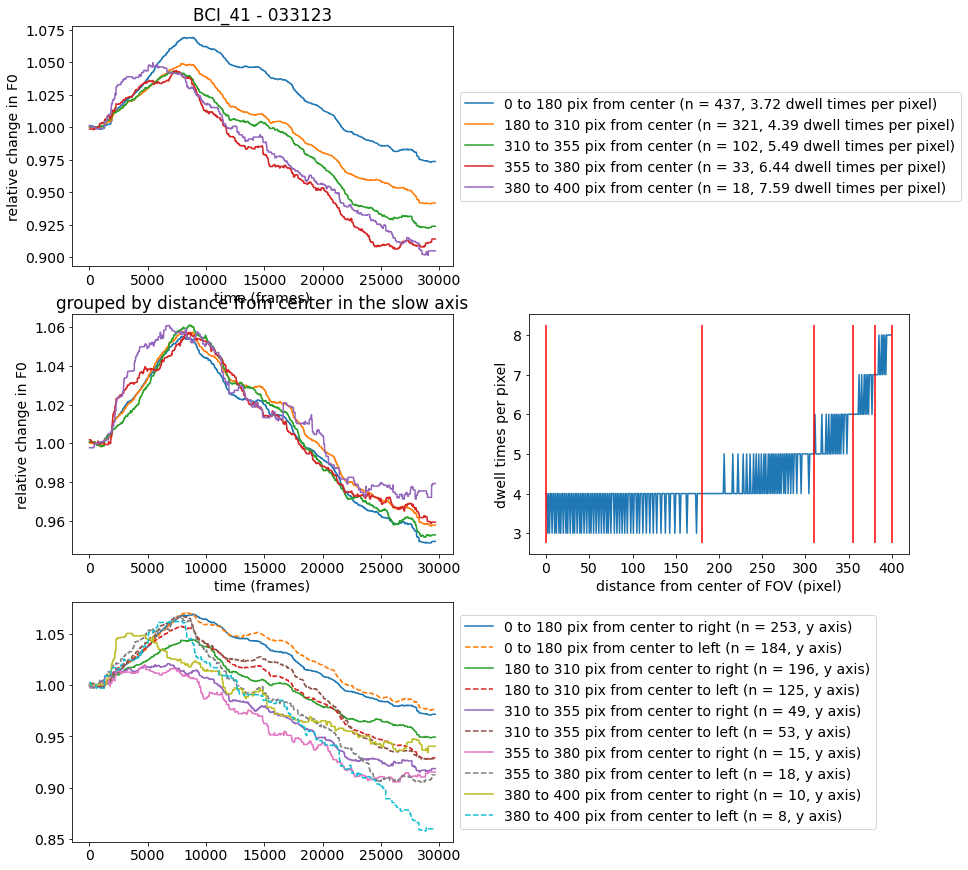

In [16]:
#### - some parts of the FOV changes in brightness  - try to identify what's happening.. 


session = sessions[-1]
min_pixel_num = 50
pixel_num_list = []
for s in stat:
    pixel_num_list.append(np.sum(s['soma_crop']))# &(s['overlap']==False)))
    #break
F0 = np.load(os.path.join(s2p_base_dir,subject,fov,session,'F0.npy'))
behavior_fname = os.path.join(bpod_path,subject, f"{session}-bpod_zaber.npy")
behavior_dict= np.load(behavior_fname,allow_pickle = True).tolist()
sample_averaging = np.asarray(behavior_dict['scanimage_tiff_headers'][55][0]['metadata']['hScan2D']['mask'].strip('[]').split(';'),int)
sample_distances = np.abs(np.arange(len(sample_averaging))-400)
#sample_averaging = BCI_analysis.plot_utils.rollingfun(sample_averaging,5,'mean')
fig = plt.figure(figsize = [15,15])
ax1 = fig.add_subplot(3,2,1)
ax3 = fig.add_subplot(3,2,3)
ax_asymmetry = fig.add_subplot(3,2,5)
#edges = np.arange(0,500,100)
edges = [0,180,310,355,380,400]
for high,low in zip(edges[1:],edges[:-1]):
    traces_now = []
    traces_now_left = []
    traces_now_right = []
    traces_now_ctrl = []
    for s,f0 in zip(stat,F0):
        if np.sum(s['soma_crop'])<min_pixel_num:
            continue
        if np.abs(s['med'][1]-400)>=low and np.abs(s['med'][1]-400)<=high:
            traces_now.append(f0)
            if s['med'][1]<400:
                traces_now_left.append(f0)
            else:
                traces_now_right.append(f0)
        if np.abs(s['med'][0]-400)>=low and np.abs(s['med'][0]-400)<=high:
            traces_now_ctrl.append(f0)
    traces_now = np.asarray(traces_now)
    traces_now_left = np.asarray(traces_now_left)
    traces_norm_left= np.nanmean(traces_now_left/np.nanmedian(traces_now_left[:,:1000],1)[:,np.newaxis],0)
    traces_now_right = np.asarray(traces_now_right)
    traces_norm_right= np.nanmean(traces_now_right/np.nanmedian(traces_now_right[:,:1000],1)[:,np.newaxis],0)
    traces_norm= np.nanmean(traces_now/np.nanmedian(traces_now[:,:1000],1)[:,np.newaxis],0)
    needed_sample_distances = (sample_distances>=low)& (sample_distances<=high)
    ax1.plot(traces_norm,label = '{} to {} pix from center (n = {}, {} dwell times per pixel)'.format(low,high,traces_now.shape[0],np.round(np.mean(sample_averaging[needed_sample_distances]),2)))
    traces_now_ctrl = np.asarray(traces_now_ctrl)
    traces_norm_ctrl= np.nanmean(traces_now_ctrl/np.nanmedian(traces_now_ctrl[:,:1000],1)[:,np.newaxis],0)
    ax3.plot(traces_norm_ctrl,label = '{} to {} pix from center (n = {}, y axis)'.format(low,high,traces_now.shape[0],np.round(np.mean(sample_averaging[needed_sample_distances]),2)))
    ax_asymmetry.plot(traces_norm_right,label = '{} to {} pix from center to right (n = {}, y axis)'.format(low,high,traces_now_right.shape[0],np.round(np.mean(sample_averaging[needed_sample_distances]),2)))
    ax_asymmetry.plot(traces_norm_left,'--',label = '{} to {} pix from center to left (n = {}, y axis)'.format(low,high,traces_now_left.shape[0],np.round(np.mean(sample_averaging[needed_sample_distances]),2)))

ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.ylim([.8,1.1])
ax2 = fig.add_subplot(3,2,4)
ax2.plot(sample_averaging[400:0:-1])
ax2.set_ylabel('dwell times per pixel')
ax2.set_xlabel('distance from center of FOV (pixel)')
ax1.set_ylabel('relative change in F0')
ax1.set_xlabel('time (frames)')
ax3.set_ylabel('relative change in F0')
ax3.set_xlabel('time (frames)')
ax3.set_title('grouped by distance from center in the slow axis')
ax2.vlines(edges,ax2.get_ylim()[0],ax2.get_ylim()[1],color = 'red')
ax1.set_title('{} - {}'.format(subject,session))
ax_asymmetry.legend(loc='center left', bbox_to_anchor=(1, 0.5))


/tmp/ipykernel_11266/2495870418.py:137: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = [16,8])


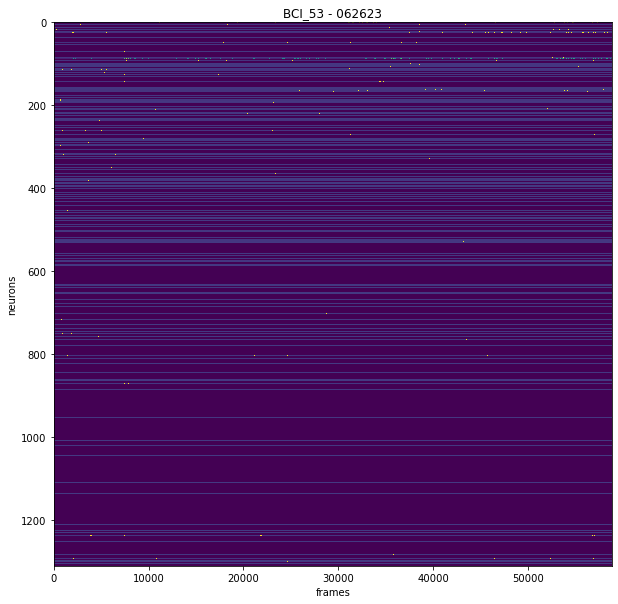

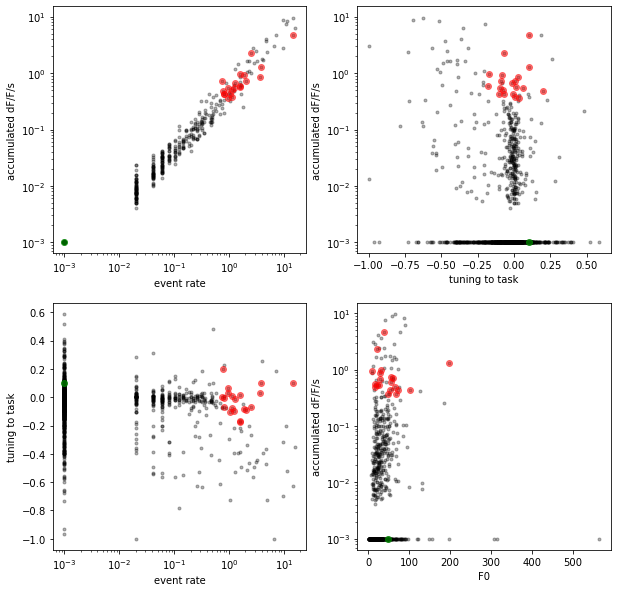

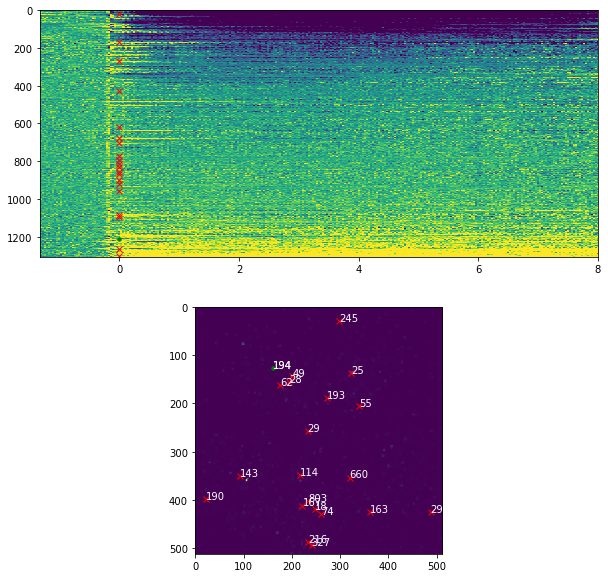

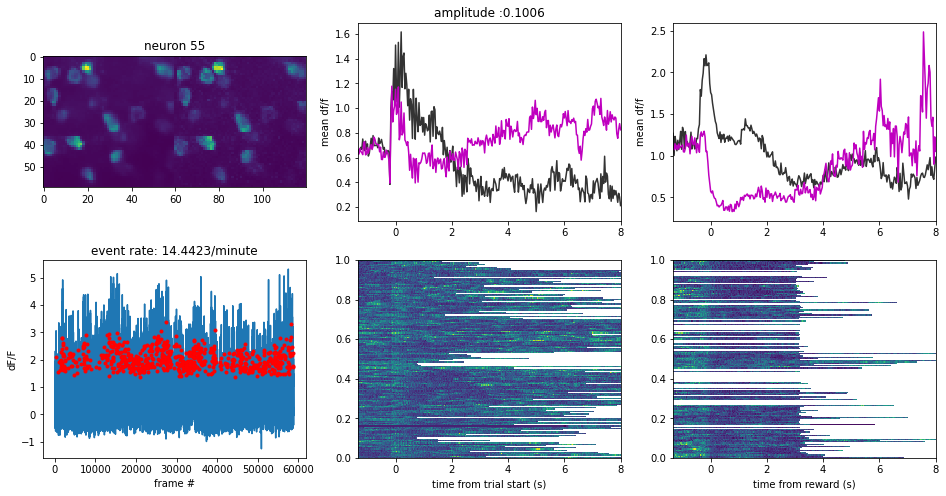

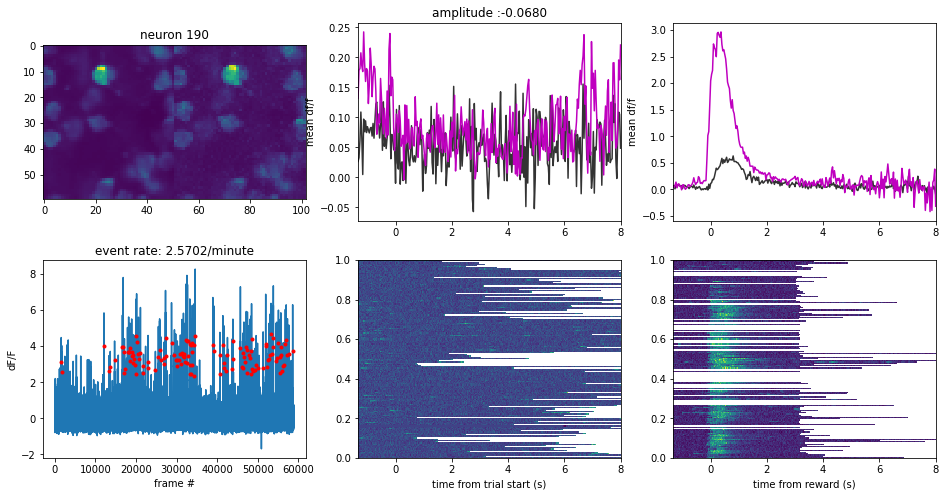

...

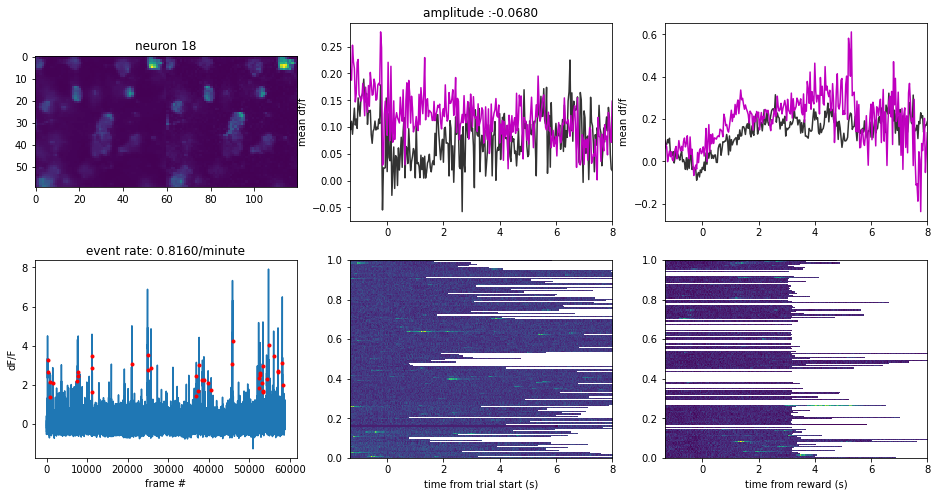

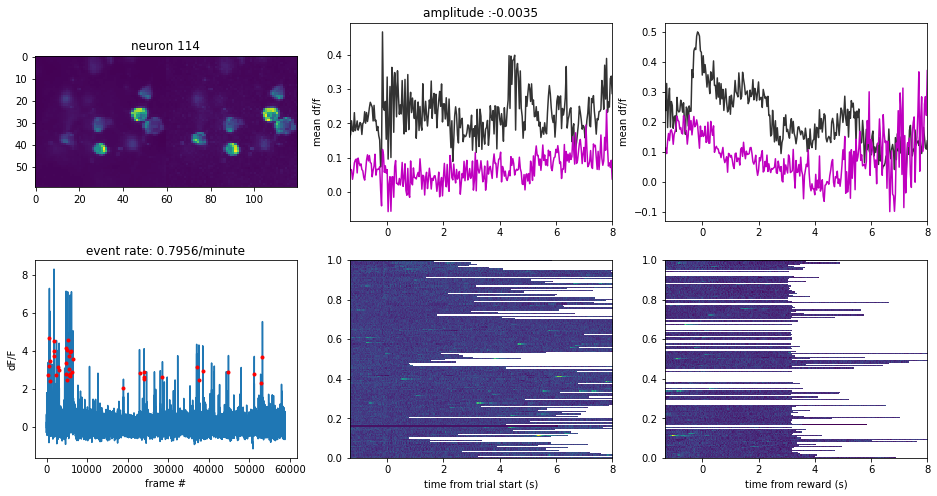

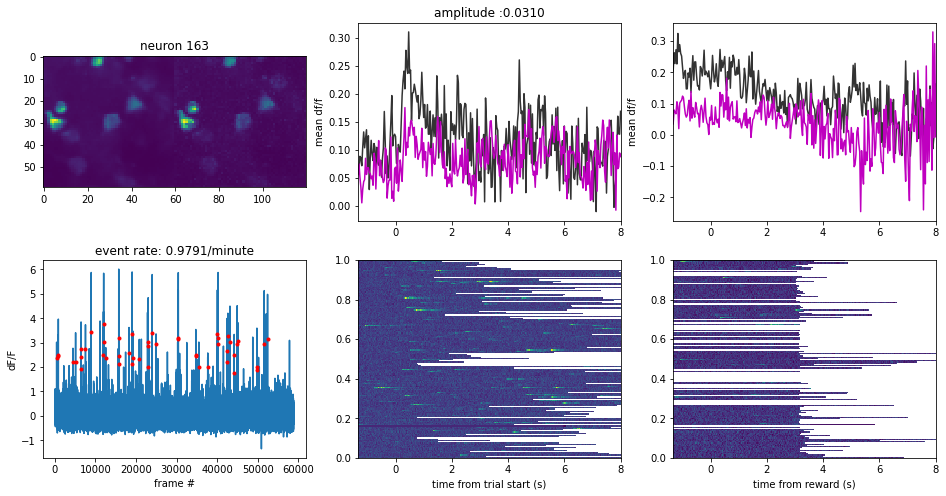

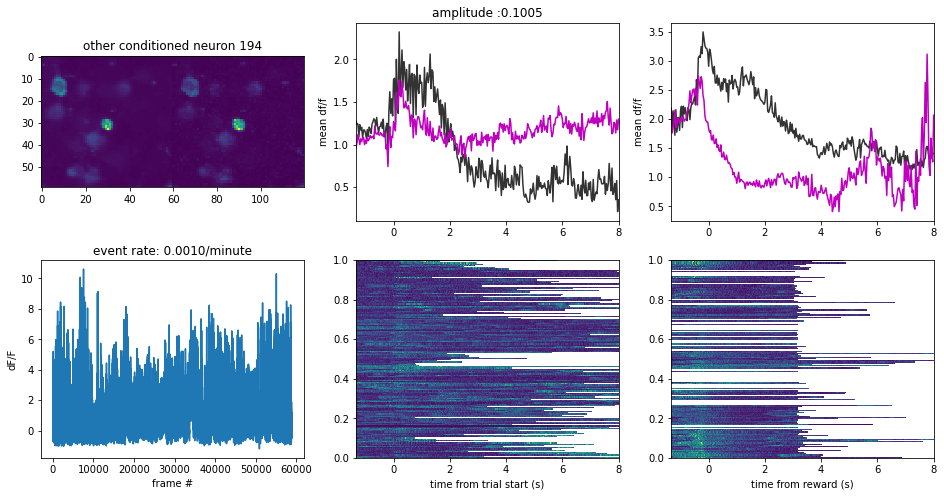

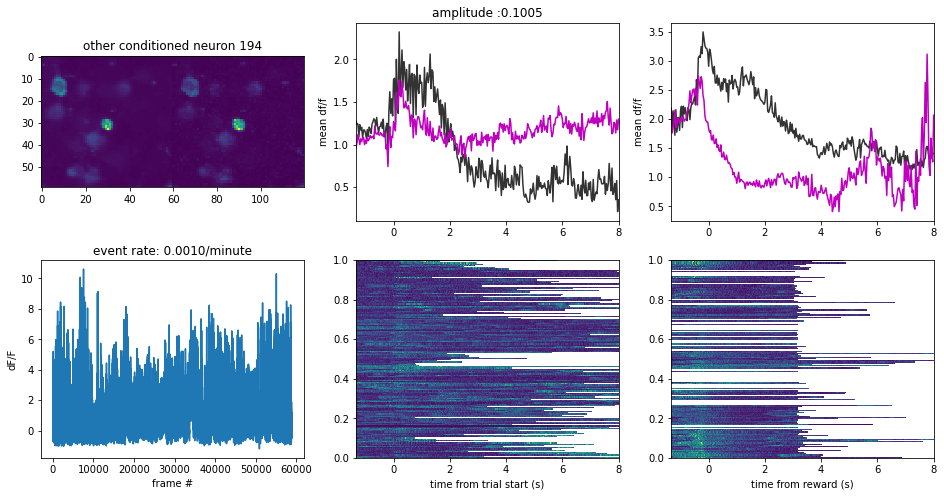

In [35]:
# plotting
#cn_list = np.concatenate(cn_list)
save_pdf_copy_files = False
needed_neuron_num = 20
target_amplitude = np.nan
max_abs_amplitude = .2
minimum_pixel_num = 30 # 60 for 6s
min_event_rate = .5
target_amplitude_rate_percentile = 100#95
minimum_f0_percentile = 25
target_event_rate = 20

roi_pixel_range = 30 # display purposes
last_session = sessions[-1]
if len(sessions)>1:
    previous_session = sessions[-2]
else:
    previous_session = sessions[-1]
cn = np.median(np.asarray(data_dict[last_session]['cn'])[np.asarray(data_dict[last_session]['cn'])!=None])

if save_pdf_copy_files:
    Path(next_session_dir).mkdir(parents = True, exist_ok = True)
    pdf_obj = PdfPages(os.path.join(next_session_dir,'conditioned_neuron_suggestions.pdf'))
    
    
%matplotlib inline
    
fig = plt.figure(figsize = [10,10])
ax = fig.add_subplot(111)
events_zscore = zscore(data_dict[last_session]['events_clean'],1)
events_zscore[np.isnan(events_zscore)] = -3
im_events = ax.imshow(events_zscore,aspect = 'auto', interpolation = 'none')  
ax.set_ylabel('neurons')    
ax.set_xlabel('frames')    
#im_events.set_clim(np.percentile(data_dict[last_session]['dff_sessionwise'].flatten(),[5,90])) 
im_events.set_clim([-1,5])
ax.set_title('{} - {}'.format(subject,last_session))
if save_pdf_copy_files:
    pdf_obj.savefig(fig) 
    #break
#%
from scipy.stats import zscore
fig = plt.figure(figsize = [10,10])
ax_1 = fig.add_subplot(2,2,1)
ax_1.plot(data_dict[last_session]['event_rate'],data_dict[last_session]['amplitude_rate'],'k.',alpha = .3)
ax_1.set_yscale('log')
ax_1.set_xlabel('event rate')
ax_1.set_xscale('log')  
ax_1.set_ylabel('accumulated dF/F/s')
#%
ax_2 = fig.add_subplot(2,2,2,sharey = ax_1)
ax_2.plot( data_dict[last_session]['trial_averaged_amplitude'],data_dict[last_session]['amplitude_rate'],'k.',alpha = .3)
ax_2.set_yscale('log')
ax_2.set_ylabel('accumulated dF/F/s')
ax_2.set_xlabel('tuning to task')

ax_3 = fig.add_subplot(2,2,3,sharex = ax_1)
ax_3.plot(data_dict[last_session]['event_rate'], data_dict[last_session]['trial_averaged_amplitude'],'k.',alpha = .3)
ax_3.set_xlabel('event rate')
ax_3.set_xscale('log') 
ax_3.set_ylabel('tuning to task')

ax_4 = fig.add_subplot(2,2,4)
ax_4.plot(data_dict[last_session]['f0_scalar'],data_dict[last_session]['amplitude_rate'],'k.',alpha = .3)
ax_4.set_xlabel('F0')
ax_4.set_yscale('log') 
ax_4.set_ylabel('accumulated dF/F/s')




target_amplitude_rate = np.percentile(data_dict[last_session]['amplitude_rate'],target_amplitude_rate_percentile)
amplitude_rate_log = np.log(data_dict[last_session]['amplitude_rate'])
event_rate_log = np.log(data_dict[last_session]['event_rate'])
event_rate_log

f0 = data_dict[last_session]['f0_scalar']
minimum_f0 = np.percentile(f0,minimum_f0_percentile)

amplitudes_zscore = (np.asarray( data_dict[last_session]['trial_averaged_amplitude'])-np.nanmedian( data_dict[last_session]['trial_averaged_amplitude']))/np.nanstd( data_dict[last_session]['trial_averaged_amplitude'])
amplitude_rate_zscore = (amplitude_rate_log-np.nanmedian(amplitude_rate_log))/np.nanstd(amplitude_rate_log)
event_rate_zscore = (event_rate_log-np.nanmedian(event_rate_log))/np.nanstd(event_rate_log)
f0_zscore = (f0-np.median(f0))/np.std(f0)
if np.isnan(target_amplitude):
    distances = np.sqrt((np.asarray(amplitude_rate_zscore)-(np.log(target_amplitude_rate)-np.nanmedian(amplitude_rate_log))/np.nanstd(amplitude_rate_log))**2 + 
                        (np.asarray(event_rate_zscore)-(np.log(target_event_rate)-np.nanmedian(event_rate_log))/np.nanstd(event_rate_log))**2)
                        #(np.asarray(f0_zscore)-(target_f0-np.nanmedian(f0))/np.nanstd(f0))**2)# + (amplitudes-target_amplitude)**2)
else:
    distances = np.sqrt((np.asarray(amplitudes_zscore)-(target_amplitude-np.nanmedian(amplitude))/np.nanstd(amplitude))**2 +
                        (np.asarray(amplitude_rate_zscore)-(np.log(target_amplitude_rate)-np.nanmedian(amplitude_rate_log))/np.nanstd(amplitude_rate_log))**2 + 
                        (np.asarray(event_rate_zscore)-(np.log(target_event_rate)-np.nanmedian(event_rate_log))/np.nanstd(event_rate_log))**2)
                        #(np.asarray(f0_zscore)-(target_f0-np.nanmedian(f0))/np.nanstd(f0))**2)# + (amplitudes-target_amplitude)**2)
distances[np.abs( data_dict[last_session]['trial_averaged_amplitude'])>max_abs_amplitude] += np.inf
#distances[data_dict[last_session]['event_rate']<min_event_rate] += np.inf
#distances[data_dict[last_session]['f0_scalar']<minimum_f0] += np.inf
distances[pixel_num_list<minimum_pixel_num] += np.inf
potential_cn_list = np.argsort(distances)[:needed_neuron_num]
potential_cn_list = np.concatenate([potential_cn_list,cn_list])
potential_cn_list = np.asarray(potential_cn_list,int)
for idx in potential_cn_list:
    if idx == cn:
        color = 'mo'
    elif idx in cn_list:
        color = 'go'
    else:
        color = 'ro'
    ax_1.plot(data_dict[last_session]['event_rate'][idx],data_dict[last_session]['amplitude_rate'][idx],color,alpha = .5)
    ax_2.plot( data_dict[last_session]['trial_averaged_amplitude'][idx],data_dict[last_session]['amplitude_rate'][idx],color,alpha = .5)
    ax_3.plot(data_dict[last_session]['event_rate'][idx], data_dict[last_session]['trial_averaged_amplitude'][idx],color,alpha = .5)
    ax_4.plot(data_dict[last_session]['f0_scalar'][idx],data_dict[last_session]['amplitude_rate'][idx],color,alpha = .5)
if save_pdf_copy_files:
    pdf_obj.savefig(fig) 
#%

fig_meanimage = plt.figure(figsize = [10,10])
ax_mean_activity = fig_meanimage.add_subplot(2,1,1)
ax_mean_image_ = fig_meanimage.add_subplot(2,1,2)
ax_mean_image_.imshow(data_dict[last_session]['mean_image'], interpolation = 'none')
detectable_event_ratio = np.mean(data_dict[last_session]['signal_to_noise_trace']>minimum_d_prime,1)
order = np.argsort( data_dict[last_session]['trial_averaged_amplitude'])
im_mean_activity = ax_mean_activity.imshow(mean_activity_matrix_normalized[order,:],aspect= 'auto', interpolation = 'none',extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],mean_activity_matrix_normalized.shape[0]-.5,-.5])
ax_mean_activity.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
# =============================================================================
# ticks = np.arange(0,len(data_dict[last_session]['time_since_trial_start']),np.argmax(data_dict[last_session]['time_since_trial_start']>0)-1)#np.asarray(ax_mean_activity.get_xticks(),int)[1:-1]
# ax_mean_activity.set_xticks(ticks)
# ax_mean_activity.set_xticklabels(np.round(data_dict[last_session]['time_since_trial_start'][ticks],2))
# =============================================================================

im_mean_activity.set_clim(np.percentile(mean_activity_matrix_normalized.flatten(),[5,95]))
#%





for idx in potential_cn_list:#cn_list:#potential_cn_list:
    fig = plt.figure(figsize = [16,8])
    ax_mean_image = fig.add_subplot(2,3,1)
    ax_trial_average = fig.add_subplot(2,3,2)
    ax_whole_session = fig.add_subplot(2,3,4)
    ax_trial_locked_activity = fig.add_subplot(2,3,5,sharex = ax_trial_average)
    
    ax_reward_average = fig.add_subplot(2,3,3,sharex = ax_trial_average)
    ax_reward_locked_activity = fig.add_subplot(2,3,6,sharex = ax_trial_average)
    
    y= int(data_dict[last_session]['roiY'][idx])
    x= int(data_dict[last_session]['roiX'][idx])
    
    s = data_dict[last_session]['mean_image'].shape
    mean_image_cutout = data_dict[last_session]['mean_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                              np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
    mean_image_cutout = mean_image_cutout/np.max(mean_image_cutout)
    max_image_cutout = data_dict[last_session]['max_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                              np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
    max_image_cutout = max_image_cutout/np.max(max_image_cutout)
    ax_mean_image.imshow(np.concatenate([mean_image_cutout,max_image_cutout],1), interpolation = 'none')
    if idx == cn:
        color = 'mo'
        ax_mean_image.set_title('conditioned neuron {}'.format(idx))
    elif idx in cn_list:
        color = 'g.'
        ax_mean_image.set_title('other conditioned neuron {}'.format(idx))
    else:
        color = 'rx'
        ax_mean_image.set_title('neuron {}'.format(idx))
    ax_mean_image_.plot(data_dict[last_session]['roiX'][idx],data_dict[last_session]['roiY'][idx],color)
    ax_mean_image_.text(data_dict[last_session]['roiX'][idx],data_dict[last_session]['roiY'][idx], str(idx),color = 'white')
    ax_mean_activity.plot(0,order[idx],color)
    needed_frames_prev= data_dict[previous_session]['time_since_trial_start']<time_to_average_after_trial_start
    ax_trial_average.plot(data_dict[previous_session]['time_since_trial_start'][needed_frames_prev],data_dict[previous_session]['mean_activity_matrix'][idx,needed_frames_prev],'k-',alpha =.8)
    needed_frames= data_dict[last_session]['time_since_trial_start']<time_to_average_after_trial_start
    ax_trial_average.plot(data_dict[last_session]['time_since_trial_start'][needed_frames],mean_activity_matrix[idx,needed_frames],'m-')
    
    ax_trial_locked_activity.set_xlabel('time from trial start (s)')
    ax_trial_average.set_ylabel('mean df/f')
    ax_trial_average.set_title('amplitude :{0:.4f}'.format( data_dict[last_session]['trial_averaged_amplitude'][idx]))
    ax_trial_average.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
    ax_trial_locked_activity.imshow(trialwise_dff_until_reward[:,idx,:].squeeze().T,aspect = 'auto', interpolation = 'none',extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],0,1])
    
    ax_reward_average.plot(data_dict[previous_session]['time_since_trial_start'][needed_frames_prev],data_dict[previous_session]['mean_reward_matrix'][idx,needed_frames_prev],'k-',alpha =.8)
    ax_reward_average.plot(data_dict[last_session]['time_since_trial_start'][needed_frames],mean_reward_matrix[idx,needed_frames],'m-')
    ax_reward_locked_activity.set_xlabel('time from reward (s)')
    ax_reward_average.set_ylabel('mean df/f')
    ax_reward_locked_activity.imshow(trialwise_reward_matrix[:,idx,:].squeeze().T,
                                     aspect = 'auto',
                                     extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],0,1],
                                     interpolation = 'none')
    ax_trial_average.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
    
# =============================================================================
#     xticks = ax_trial_locked_activity.get_xticks()
#     xticks = np.asarray(xticks[(xticks>0)&(xticks<len(data_dict[last_session]['time_since_trial_start']))],int)
#     ax_trial_locked_activity.set_xticks(xticks)
#     ax_trial_locked_activity.set_xticklabels(np.round(data_dict[last_session]['time_since_trial_start'][xticks],2))
# =============================================================================
    
    ax_whole_session.plot(data_dict[last_session]['dff_sessionwise'][idx,:])
    #%
    for start_,end_ in  zip(np.where(np.diff(np.concatenate([[0],data_dict[last_session]['events_clean'][idx,:],[0]]))>0)[0],
                            np.where(np.diff(np.concatenate([[0],data_dict[last_session]['events_clean'][idx,:],[0]]))<0)[0]):
        center_idx = int(np.mean([start_,end_]))
        ax_whole_session.plot(center_idx,data_dict[last_session]['events_clean'][idx,center_idx],'r.')
                            
# =============================================================================
#     ax_whole_session.plot(np.where(data_dict[last_session]['events_clean'][idx,:]>0)[0],data_dict[last_session]['dff_sessionwise'][idx,data_dict[last_session]['events_clean'][idx,:]>0],'r.')
# =============================================================================
    ax_whole_session.set_xlabel('frame #')
    ax_whole_session.set_ylabel('dF/F')
    ax_whole_session.set_title('event rate: {0:.4f}/minute'.format(data_dict[last_session]['event_rate'][idx]))
    if save_pdf_copy_files:
        pdf_obj.savefig(fig) 
    #plt.close()
    #break
if save_pdf_copy_files:    
    pdf_obj.savefig(fig_meanimage) 
    pdf_obj.close()
    
    #% save selected roi indices
    mdict = mdict={'potential_cn_list': potential_cn_list.tolist(),
                   'meanImg': data_dict[last_session]['mean_image']}
    savemat(file_name=os.path.join(s2p_base_dir,subject, fov,'ops.mat'),
            mdict = mdict)
    # copy files over
    for file in file_list_to_copy_over:
        shutil.copyfile(os.path.join(s2p_base_dir,subject,fov,file),os.path.join(next_session_dir,file))